In [1]:
# from google.colab import drive
# drive.mount('/content/drive')

In [2]:
#!ls
! ls

 BMPD.ipynb			      frcnn_train_vgg.ipynb
 BMPD.txt			      keras-frcnn
 Mydata				      loss.png
 README.md			      loss_class_regr.png
 annotate.txt			      loss_rpn_cls.png
 annotate1.txt			      mean_overlapping_bboxes_and_class_acc.png
 annotate1021.txt		      model
 annotate1025.txt		      model_vgg_config.pickle
 annotation.txt			      my_model.h5
 applications_load_weight_test.py     plamtest.txt
'dcm to jpg .ipynb'		      preposessing.ipynb
 efficientnet_weight_update_util.py   test_annotation.txt
 elapsed_time.png		      testcsv
 frcnn_test_vgg.ipynb		      total_loss.png
 frcnn_train_vgg-Copy1.ipynb	      vgg16.py


In [3]:
import os

os.environ["CUDA_VISIBLE_DEVICES"]="1"

In [4]:
# import tensorflow as tf

# model = tf.keras.models.load_model('/model/model_frcnn_vgg1005_1_AN_M.hdf5')
# converter = tf.lite.TFLiteConverter.from_keras_model(model)
# tflite_model = converter.convert()
# open("animall_person_other_v2_fine_tuned.tflite", "wb").write(tflite_model)

In [5]:
# converter = tf.compat.v1.lite.TFLiteConverter.from_keras_model_file("/model/model_frcnn_vgg1005_1_AN_M.hdf5")
# tflite_model = converter.convert()
# open("converted_model.tflite", "wb").write(tflite_model)

In [6]:
# # Convert the model
# converter = tf.lite.TFLiteConverter.from_saved_model("./model/") # path to the SavedModel directory
# tflite_model = converter.convert()

# # Save the model.
# with open('./model.tflite', 'wb') as f:
#   f.write(tflite_model)

### Import libs

In [86]:
from __future__ import division
from __future__ import print_function
from __future__ import absolute_import
import random
import pprint
import sys
import time
import numpy as np
from optparse import OptionParser
import pickle
import math
import cv2
import copy
from matplotlib import pyplot as plt
import tensorflow as tf
import pandas as pd
import os

from sklearn.metrics import average_precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import precision_score
from sklearn.metrics import f1_score

from tensorflow import keras
from tensorflow.keras import backend as K
from tensorflow.keras.optimizers import Adam, SGD, RMSprop
from tensorflow.keras.layers import Flatten, Dense, Input, Conv2D, MaxPooling2D, Dropout,Lambda
from tensorflow.keras.layers import GlobalAveragePooling2D, GlobalMaxPooling2D, TimeDistributed
from tensorflow.keras.layers import Dense, Dropout, Flatten, Conv2D,Activation, MaxPool2D,MaxPooling2D , BatchNormalization,Input,AveragePooling2D , Dropout,Embedding,Lambda,Softmax ,GlobalAveragePooling2D,SeparableConv2D,ZeroPadding2D,DepthwiseConv2D,GlobalMaxPool2D#函式宣告

from tensorflow.keras import Sequential, layers, Model

from tensorflow.keras.utils import get_source_inputs
from tensorflow.keras.utils import get_file
from tensorflow.keras.metrics import categorical_crossentropy
from tensorflow.keras import backend 
from tensorflow.keras.models import Model
import tensorflow.keras.utils as generic_utils
from tensorflow.keras.layers import InputSpec ,Layer
from tensorflow.keras import initializers, regularizers

In [8]:
import tensorflow as tf
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))
print("Num CPUs Available: ", len(tf.config.list_physical_devices('CPU')))
tf.config.list_physical_devices('GPU')

Num GPUs Available:  1
Num CPUs Available:  1


[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [9]:
!nvidia-smi

Thu Jul 28 11:12:13 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.129.06   Driver Version: 470.129.06   CUDA Version: 11.4     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA GeForce ...  On   | 00000000:04:00.0 Off |                  N/A |
| 31%   46C    P8    21W / 250W |  10538MiB / 11018MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  NVIDIA GeForce ...  On   | 00000000:08:00.0 Off |                  N/A |
| 24%   

In [10]:
# !pip install tf-nightly-gpu

#### Config setting

In [11]:
class Config:

	def __init__(self):

		# Print the process or not
		self.verbose = True

		# Name of base network
		self.network = 'vgg'

		# Setting for data augmentation
		self.use_horizontal_flips = False
		self.use_vertical_flips = False
		self.rot_90 = False

		# Anchor box scales
    # Note that if im_size is smaller, anchor_box_scales should be scaled
    # Original anchor_box_scales in the paper is [128, 256, 512]
		self.anchor_box_scales = [64, 128, 256] 

		# Anchor box ratios
		self.anchor_box_ratios = [[1, 1], [1./math.sqrt(2), 2./math.sqrt(2)], [2./math.sqrt(2), 1./math.sqrt(2)]]

		# Size to resize the smallest side of the image
		# Original setting in paper is 600. Set to 300 in here to save training time
		self.im_size = 300

		# image channel-wise mean to subtract
		self.img_channel_mean = [103.939, 116.779, 123.68]
		self.img_scaling_factor = 1.0

		# number of ROIs at once
		self.num_rois = 4

		# stride at the RPN (this depends on the network configuration)
		self.rpn_stride = 16

		self.balanced_classes = False

		# scaling the stdev
		self.std_scaling = 4.0
		self.classifier_regr_std = [8.0, 8.0, 4.0, 4.0]

		# overlaps for RPN
		self.rpn_min_overlap = 0.4
		self.rpn_max_overlap = 0.85

		# overlaps for classifier ROIs
		self.classifier_min_overlap = 0.1
		self.classifier_max_overlap = 0.5

		# placeholder for the class mapping, automatically generated by the parser
		self.class_mapping = None

		self.model_path = None

#### Parser the data from annotation file

In [12]:
def get_data(input_path):
	"""Parse the data from annotation file
	
	Args:
		input_path: annotation file path

	Returns:
		all_data: list(filepath, width, height, list(bboxes))
		classes_count: dict{key:class_name, value:count_num} 
			e.g. {'Car': 2383, 'Mobile phone': 1108, 'Person': 3745}
		class_mapping: dict{key:class_name, value: idx}
			e.g. {'Car': 0, 'Mobile phone': 1, 'Person': 2}
	"""
	found_bg = False
	all_imgs = {}

	classes_count = {}

	class_mapping = {}

	visualise = True

	i = 1
	
	with open(input_path,'r') as f:

		print('Parsing annotation files')

		for line in f:

			# Print process
			sys.stdout.write('\r'+'idx=' + str(i))
			i += 1

			line_split = line.strip().split(',')

			# Make sure the info saved in annotation file matching the format (path_filename, x1, y1, x2, y2, class_name)
			# Note:
			#	One path_filename might has several classes (class_name)
			#	x1, y1, x2, y2 are the pixel value of the origial image, not the ratio value
			#	(x1, y1) top left coordinates; (x2, y2) bottom right coordinates
			#   x1,y1-------------------
			#	|						|
			#	|						|
			#	|						|
			#	|						|
			#	---------------------x2,y2

			(filename,x1,y1,x2,y2,class_name) = line_split

			if class_name not in classes_count:
				classes_count[class_name] = 1
			else:
				classes_count[class_name] += 1

			if class_name not in class_mapping:
				if class_name == 'bg' and found_bg == False:
					print('Found class name with special name bg. Will be treated as a background region (this is usually for hard negative mining).')
					found_bg = True
				class_mapping[class_name] = len(class_mapping)

			if filename not in all_imgs:
				all_imgs[filename] = {}
				
				img = cv2.imread(filename)
                
				(rows,cols) = img.shape[:2]
				all_imgs[filename]['filepath'] = filename
				all_imgs[filename]['width'] = cols
				all_imgs[filename]['height'] = rows
				all_imgs[filename]['bboxes'] = []
				# if np.random.randint(0,6) > 0:
				# 	all_imgs[filename]['imageset'] = 'trainval'
				# else:
				# 	all_imgs[filename]['imageset'] = 'test'
            
            
			all_imgs[filename]['bboxes'].append({'class': class_name, 'x1': int(float(x1)), 'x2': int(float(x2)), 'y1': int(float(y1)), 'y2':int(float(y2))})


		all_data = []
		for key in all_imgs:
			all_data.append(all_imgs[key])
		
		# make sure the bg class is last in the list
		if found_bg:
			if class_mapping['bg'] != len(class_mapping) - 1:
				key_to_switch = [key for key in class_mapping.keys() if class_mapping[key] == len(class_mapping)-1][0]
				val_to_switch = class_mapping['bg']
				class_mapping['bg'] = len(class_mapping) - 1
				class_mapping[key_to_switch] = val_to_switch
		
		return all_data, classes_count, class_mapping

#### Define ROI Pooling Convolutional Layer

In [13]:
class RoiPoolingConv(Layer):
    '''ROI pooling layer for 2D inputs.
    See Spatial Pyramid Pooling in Deep Convolutional Networks for Visual Recognition,
    K. He, X. Zhang, S. Ren, J. Sun
    # Arguments
        pool_size: int
            Size of pooling region to use. pool_size = 7 will result in a 7x7 region.
        num_rois: number of regions of interest to be used
    # Input shape
        list of two 4D tensors [X_img,X_roi] with shape:
        X_img:
        `(1, rows, cols, channels)`
        X_roi:
        `(1,num_rois,4)` list of rois, with ordering (x,y,w,h)
    # Output shape
        3D tensor with shape:
        `(1, num_rois, channels, pool_size, pool_size)`
    '''
    def __init__(self, pool_size, num_rois, **kwargs):

        self.dim_ordering = K.image_data_format()
        self.pool_size = pool_size
        self.num_rois = num_rois

        super(RoiPoolingConv, self).__init__(**kwargs)

    def build(self, input_shape):
        self.nb_channels = input_shape[0][3]   

    def compute_output_shape(self, input_shape):
        return None, self.num_rois, self.pool_size, self.pool_size, self.nb_channels

    def call(self, x, mask=None):

        assert(len(x) == 2)

        # x[0] is image with shape (rows, cols, channels)
        img = x[0]

        # x[1] is roi with shape (num_rois,4) with ordering (x,y,w,h)
        rois = x[1]

        input_shape = K.shape(img)

        outputs = []

        for roi_idx in range(self.num_rois):

            x = rois[0, roi_idx, 0]
            y = rois[0, roi_idx, 1]
            w = rois[0, roi_idx, 2]
            h = rois[0, roi_idx, 3]

            x = K.cast(x, 'int32')
            y = K.cast(y, 'int32')
            w = K.cast(w, 'int32')
            h = K.cast(h, 'int32')

            # Resized roi of the image to pooling size (7x7)
            rs = tf.image.resize(img[:, y:y+h, x:x+w, :], (self.pool_size, self.pool_size))
            outputs.append(rs)
                

        final_output = K.concatenate(outputs, axis=0)

        # Reshape to (1, num_rois, pool_size, pool_size, nb_channels)
        # Might be (1, 4, 7, 7, 3)
        final_output = K.reshape(final_output, (1, self.num_rois, self.pool_size, self.pool_size, self.nb_channels))

        # permute_dimensions is similar to transpose
        final_output = K.permute_dimensions(final_output, (0, 1, 2, 3, 4))

        return final_output
    
    
    def get_config(self):
        config = {'pool_size': self.pool_size,
                  'num_rois': self.num_rois}
        base_config = super(RoiPoolingConv, self).get_config()
        return dict(list(base_config.items()) + list(config.items()))

#### CNN FEATURE MAP model

In [14]:
def get_img_output_length(width, height):
    def get_output_length(input_length):
        return input_length//16

    return get_output_length(width), get_output_length(height)    

def nn_base(input_tensor=None, trainable=False):


    input_shape = (None, None, 3)

    if input_tensor is None:
        img_input = Input(shape=input_shape)
    else:
        if not K.is_keras_tensor(input_tensor):
            img_input = Input(tensor=input_tensor, shape=input_shape)
        else:
            img_input = input_tensor

    bn_axis = 3

#     Block 1
    x = Conv2D(64, (3, 3), activation='relu', padding='same', name='block1_conv1')(img_input)
    x = Conv2D(64, (3, 3), activation='relu', padding='same', name='block1_conv2')(x)
    x = MaxPooling2D((2, 2), strides=(2, 2), name='block1_pool')(x)

    # Block 2
    x = Conv2D(128, (3, 3), activation='relu', padding='same', name='block2_conv1')(x)
    x = Conv2D(128, (3, 3), activation='relu', padding='same', name='block2_conv2')(x)
    x = MaxPooling2D((2, 2), strides=(2, 2), name='block2_pool')(x)

    # Block 3
    x = Conv2D(256, (3, 3), activation='relu', padding='same', name='block3_conv1')(x)
    x = Conv2D(256, (3, 3), activation='relu', padding='same', name='block3_conv2')(x)
    x = Conv2D(256, (3, 3), activation='relu', padding='same', name='block3_conv3')(x)
    x = MaxPooling2D((2, 2), strides=(2, 2), name='block3_pool')(x)

    # Block 4
    x = Conv2D(512, (3, 3), activation='relu', padding='same', name='block4_conv1')(x)
    x = Conv2D(512, (3, 3), activation='relu', padding='same', name='block4_conv2')(x)
    x = Conv2D(512, (3, 3), activation='relu', padding='same', name='block4_conv3')(x)
    x = MaxPooling2D((2, 2), strides=(2, 2), name='block4_pool')(x)

    # Block 5
    x = Conv2D(512, (3, 3), activation='relu', padding='same', name='block5_conv1')(x)
    x = Conv2D(512, (3, 3), activation='relu', padding='same', name='block5_conv2')(x)
    x = Conv2D(512, (3, 3), activation='relu', padding='same', name='block5_conv3')(x)
#     x = MaxPooling2D((2, 2), strides=(2, 2), name='block5_pool')(x)
    
#   MOLENET V1 
    Cx = Conv2D(filters=64,kernel_size=(1,1),strides=1,padding='same')(img_input)
    Cx = BatchNormalization()(Cx)
    Cx = Activation('relu')(Cx)

    Dx = keras.layers.DepthwiseConv2D(kernel_size=(1,1),padding='same',strides=1)(Cx)
    Dx = BatchNormalization()(Dx)
    Dx = Activation('relu')(Dx)

    Sx = keras.layers.SeparableConv2D(filters=128, kernel_size=(1,1), strides=1, padding='valid')(Dx)
    Sx = BatchNormalization()(Sx)
    Sx = Activation('relu')(Sx)
    Dx = keras.layers.DepthwiseConv2D(kernel_size=(2,2),padding='same',strides=2)(Sx)
    Dx = BatchNormalization()(Dx)
    Dx = Activation('relu')(Dx)

    Sx = keras.layers.SeparableConv2D(filters=256, kernel_size=(1,1), strides=1, padding='valid')(Dx)
    Sx = BatchNormalization()(Sx)
    Sx = Activation('relu')(Sx)
    Dx = keras.layers.DepthwiseConv2D(kernel_size=(2,2),padding='same',strides=1)(Sx)
    Dx = BatchNormalization()(Dx)
    Dx = Activation('relu')(Dx)

    Sx = keras.layers.SeparableConv2D(filters=512, kernel_size=(1,1), strides=1, padding='valid')(Dx)
    Sx = BatchNormalization()(Sx)
    Sx = Activation('relu')(Sx)
    Dx = keras.layers.DepthwiseConv2D(kernel_size=(2,2),padding='same',strides=2)(Sx)
    Dx = BatchNormalization()(Dx)
    Dx = Activation('relu')(Dx)

    Sx = keras.layers.SeparableConv2D(filters=512, kernel_size=(1,1), strides=1, padding='valid')(Dx)
    Sx = BatchNormalization()(Sx)
    Sx = Activation('relu')(Sx)
    Dx = keras.layers.DepthwiseConv2D(kernel_size=(2,2),padding='valid',strides=2)(Sx)
    Dx = BatchNormalization()(Dx)
    Dx = Activation('relu')(Dx)

    Sx = keras.layers.SeparableConv2D(filters=512, kernel_size=(2 ,2), strides=1, padding='valid')(Dx)
    Sx = BatchNormalization()(Sx)
    Sx = Activation('relu')(Sx)   
    
#     Dx = keras.layers.DepthwiseConv2D(kernel_size=(1,1),padding='same',strides=2)(Sx)
#     Dx = BatchNormalization()(Dx)
#     Dx = Activation('relu')(Dx)
#     Sx = keras.layers.SeparableConv2D(filters=512, kernel_size=(1,1), strides=1, padding='valid')(Dx)
#     Sx = BatchNormalization()(Sx)
#     Sx = Activation('relu')(Sx)
    
#     Sx = GlobalAveragePooling2D()(Sx)
# y = Dense(41, name='y', activation='softmax')(y) 
#   MOLENET V1 

#   MOLENET V3
    x = MV3(img_input)


#   MOLENET V3 





# main_output = y
#     x = MaxPooling2D((2, 2), strides=(2, 2), name='block5_pool')(Sx)

    decoder_outputs = Lambda(lambda x: K.cast(x, 'float32'), name='change_to_float')(x)


    return decoder_outputs
# balala

#### MoblieNetV3 model function

In [ ]:
def _make_divisible(ch, divisor=8, min_ch=None):
    """
    This function is taken from the original tf repo.
    It ensures that all layers have a channel number that is divisible by 8
    It can be seen here:
    https://github.com/tensorflow/models/blob/master/research/slim/nets/mobilenet/mobilenet.py
    """
    if min_ch is None:
        min_ch = divisor
    new_ch = max(min_ch, int(ch + divisor / 2) // divisor * divisor)
    # Make sure that round down does not go down by more than 10%.
    if new_ch < 0.9 * ch:
        new_ch += divisor
    return new_ch

In [ ]:
class h_swish(layers.Layer):
    def __init__(self):
        super(h_swish, self).__init__()
        self.relu = layers.ReLU(max_value=6.0)
    
    def call(self, inputs):
        x = self.relu(inputs) * inputs

        return x


In [ ]:
class SqueezeBlock(layers.Layer):
    def __init__(self, exp_size, divide = 4):
        super(SqueezeBlock, self).__init__()
        self.linear = Sequential([
            layers.GlobalAveragePooling2D(),
            layers.Dense(exp_size // divide),
            layers.ReLU(max_value=6.0),
            layers.Dense(exp_size),
        ])
        self.h_sigmoid = tf.keras.activations.hard_sigmoid

    def call(self, inputs):
        x = self.linear(inputs)
        x = self.h_sigmoid(x)
        x = tf.reshape(x, (tf.shape(x)[0], 1, 1, tf.shape(x)[-1]))
        out = tf.math.multiply(inputs, x)

        return out

In [ ]:
class ConvBN(layers.Layer):
    def __init__(self, out_channel, kernel_size, stride, activation, padding):
        super(ConvBN, self).__init__()
        self.conv = layers.Conv2D(out_channel, kernel_size=kernel_size, strides=stride, padding=padding)
        self.BN = layers.BatchNormalization(momentum=0.9, epsilon=1e-5, name='BatchNorm')
        self.flag = activation
        self.relu = layers.ReLU()
        self.h_swish = h_swish()

    def call(self, inputs):
        x = self.conv(inputs)
        x = self.BN(x)
        if self.flag == 'relu':
            out = self.relu(x)
        elif self.flag == 'h_swish':
            out = self.h_swish(x)

        return out

In [ ]:
class Bneck(layers.Layer):
    def __init__(self, in_channel, out_channel, kernel_size, stride, SE, NL, exp_size, dropout_rate = 1.0):
        super(Bneck, self).__init__()
        self.out_channel= out_channel
        self.SE = SE
        self.dropout_rate = dropout_rate
        self.NL = NL

        self.shortcut = (stride == 1 and in_channel == out_channel)

        if self.NL == 'RE':
            activation = 'relu'
        elif NL == 'HS':
            activation = 'h_swish'
        
        self.ConvBN_1 = ConvBN(out_channel=exp_size, kernel_size=1, stride=1, padding='valid', activation=activation)

        self.DWBN = Sequential([
            layers.DepthwiseConv2D(kernel_size=kernel_size, strides=stride, padding='same', use_bias=False),
            layers.BatchNormalization(momentum=0.9, epsilon=1e-5, name='BatchNorm')
        ])

        if self.SE:
            self.squeeze_block = SqueezeBlock(exp_size)
        
        self.ConvBN_2 = ConvBN(out_channel=out_channel, kernel_size=1, stride=1, padding='valid', activation=activation)

    def call(self, inputs):
        x = self.ConvBN_1(inputs)
        x = self.DWBN(x)

        if self.SE:
            x = self.squeeze_block(x)
            
        x = self.ConvBN_2(x)

        if self.shortcut:
            return inputs + x
        else:
            return x



In [ ]:
def MobileNetV3(mode='large', H=224, W=224, num_classes=1000, alpha = 1.0):
    input_channel = _make_divisible(16*alpha)
    last_channel = _make_divisible(1280*alpha)

    bneck_setting = [
        [16, 16, 3, False, 'RE', 1],
        [64, 24, 3, False, 'RE', 2],
        [72, 24, 3, False, 'RE', 1],
        [72, 40, 5, True, 'RE', 2],
        [120, 40, 5, True, 'RE', 1],
        [120, 40, 5, True, 'RE', 1],
        [240, 80, 3, False, 'HS', 2],
        [200, 80, 3, False, 'HS', 1],
        [184, 80, 3, False, 'HS', 1],
        [184, 80, 3, False, 'HS', 1],
        [480, 112, 3, True, 'HS', 1],
        [672, 112, 3, True, 'HS', 1],
        [672, 160, 5, True, 'HS', 2],
        [960, 160, 5, True, 'HS', 1],
        [960, 160, 5, True, 'HS', 1]
    ]



    input_image = layers.Input(shape=(H, W, 3), dtype = 'float32')

    x = ConvBN(out_channel=input_channel, kernel_size=3, stride=2, padding='same', activation='h_swish')(input_image)

    for exp_size, out_channel, kernel_size, SE, NL, stride in bneck_setting:
        exp_size = _make_divisible(exp_size*alpha)
        out_channel = _make_divisible(out_channel*alpha)
        x = Bneck(x.shape[-1], out_channel, kernel_size, stride, SE, NL, exp_size)(x)
    
    last_out = _make_divisible(960*alpha)
    x = ConvBN(last_out, kernel_size=1, stride=1, activation='h_swish', padding='valid')(x)
    x = layers.GlobalAveragePooling2D()(x)
    x = layers.Dense(last_channel)(x)
    x = h_swish()(x)
    output = layers.Dense(num_classes)(x)

    model = Model(inputs=input_image, outputs=output)
    
    return model

In [ ]:
def MV3(input_image, alpha = 1.0):
    input_channel = _make_divisible(16*alpha)
    last_channel = _make_divisible(1280*alpha)


    bneck_setting = [
        [16, 64, 2, False, 'RE', 1],
        [64, 64, 2, False, 'HS', 2],
        [72, 128, 2, False, 'RE', 1],
        [72, 128, 2, True, 'HS', 2],
        [120, 256, 2, True, 'RE', 1],
        [120, 256, 2, True, 'HS', 1],
        [240, 512, 2, False, 'RE', 1],
        [200, 512, 2, False, 'HS', 1],

    ]



    x = ConvBN(out_channel=input_channel, kernel_size=1, stride=1, padding='valid', activation='h_swish')(input_image)

    for exp_size, out_channel, kernel_size, SE, NL, stride in bneck_setting:
        exp_size = _make_divisible(exp_size*alpha)
        out_channel = _make_divisible(out_channel*alpha)
        x = Bneck(x.shape[-1], out_channel, kernel_size, stride, SE, NL, exp_size)(x)
#     x = ConvBN(out_channel=input_channel, kernel_size=2, stride=1, padding='same', activation='h_swish')(x)

    last_out = _make_divisible(184*alpha)
    x = ConvBN(512, kernel_size=2, stride=2, activation='h_swish', padding='valid')(x)
#     x = keras.layers.DepthwiseConv2D(kernel_size=(2,2),padding='valid',strides=2)(x)
    x = ConvBN(512, kernel_size=2, stride=2, activation='h_swish', padding='valid')(x)

#     x = layers.GlobalAveragePooling2D()(x)
#     x = layers.Dense(last_channel)(x)
#     x = h_swish()(x)
#     output = layers.Dense(num_classes)(x)

#     model = Model(inputs=input_image, outputs=output)
    return x
# balala

In [ ]:
# input_image = layers.Input(shape=(300, 300, 3), dtype = 'float32')
# net1 = MV3(input_image)
# net1

In [ ]:
# net = MobileNetV3()

In [ ]:
# net.summary()

####  RPN layer

In [ ]:
def rpn_layer(base_layers, num_anchors):
    """Create a rpn layer
        Step1: Pass through the feature map from base layer to a 3x3 512 channels convolutional layer
                Keep the padding 'same' to preserve the feature map's size
        Step2: Pass the step1 to two (1,1) convolutional layer to replace the fully connected layer
                classification layer: num_anchors (9 in here) channels for 0, 1 sigmoid activation output
                regression layer: num_anchors*4 (36 in here) channels for computing the regression of bboxes with linear activation
    Args:
        base_layers: vgg in here
        num_anchors: 9 in here

    Returns:
        [x_class, x_regr, base_layers]
        x_class: classification for whether it's an object
        x_regr: bboxes regression
        base_layers: vgg in here
    """
    x = Conv2D(512, (3, 3), padding='same', activation='relu', kernel_initializer='normal', name='rpn_conv1')(base_layers)

    x_class = Conv2D(num_anchors, (1, 1), activation='sigmoid', kernel_initializer='uniform', name='rpn_out_class')(x)
    x_regr = Conv2D(num_anchors * 4, (1, 1), activation='linear', kernel_initializer='zero', name='rpn_out_regress')(x)

    return [x_class, x_regr, base_layers]

####  Classifier layer

In [ ]:
def classifier_layer(base_layers, input_rois, num_rois, nb_classes = 43):
    """Create a classifier layer
    
    Args:
        base_layers: vgg
        input_rois: `(1,num_rois,4)` list of rois, with ordering (x,y,w,h)
        num_rois: number of rois to be processed in one time (4 in here)

    Returns:
        list(out_class, out_regr)
        out_class: classifier layer output
        out_regr: regression layer output
    """

    input_shape = (num_rois,7,7,512)

    pooling_regions = 7

    # out_roi_pool.shape = (1, num_rois, channels, pool_size, pool_size)
    # num_rois (4) 7x7 roi pooling
    out_roi_pool = RoiPoolingConv(pooling_regions, num_rois)([base_layers, input_rois])

    # Flatten the convlutional layer and connected to 2 FC and 2 dropout
    out = TimeDistributed(Flatten(name='flatten'))(out_roi_pool)
    out = TimeDistributed(Dense(4096, activation='relu', name='fc1'))(out)
    out = TimeDistributed(Dropout(0.5))(out)
    out = TimeDistributed(Dense(4096, activation='relu', name='fc2'))(out)
    out = TimeDistributed(Dropout(0.5))(out)

    # There are two output layer
    # out_class: softmax acivation function for classify the class name of the object
    # out_regr: linear activation function for bboxes coordinates regression
    out_class = TimeDistributed(Dense(nb_classes, activation='softmax', kernel_initializer='zero'), name='dense_class_{}'.format(nb_classes))(out)
    # note: no regression target for bg class
    out_regr = TimeDistributed(Dense(4 * (nb_classes-1), activation='linear', kernel_initializer='zero'), name='dense_regress_{}'.format(nb_classes))(out)

    return [out_class, out_regr]

#### Calculate IoU (Intersection of Union)

In [27]:
def union(au, bu, area_intersection):
	area_a = (au[2] - au[0]) * (au[3] - au[1])
	area_b = (bu[2] - bu[0]) * (bu[3] - bu[1])
	area_union = area_a + area_b - area_intersection
	return area_union


def intersection(ai, bi):
	x = max(ai[0], bi[0])
	y = max(ai[1], bi[1])
	w = min(ai[2], bi[2]) - x
	h = min(ai[3], bi[3]) - y
	if w < 0 or h < 0:
		return 0
	return w*h


def iou(a, b):
	# a and b should be (x1,y1,x2,y2)

	if a[0] >= a[2] or a[1] >= a[3] or b[0] >= b[2] or b[1] >= b[3]:
		return 0.0

	area_i = intersection(a, b)
	area_u = union(a, b, area_i)

	return float(area_i) / float(area_u + 1e-6)

#### Calculate the rpn for all anchors of all images

In [28]:
def calc_rpn(C, img_data, width, height, resized_width, resized_height, img_length_calc_function):
	"""(Important part!) Calculate the rpn for all anchors 
		If feature map has shape 38x50=1900, there are 1900x9=17100 potential anchors
	
	Args:
		C: config
		img_data: augmented image data
		width: original image width (e.g. 600)
		height: original image height (e.g. 800)
		resized_width: resized image width according to C.im_size (e.g. 300)
		resized_height: resized image height according to C.im_size (e.g. 400)
		img_length_calc_function: function to calculate final layer's feature map (of base model) size according to input image size

	Returns:
		y_rpn_cls: list(num_bboxes, y_is_box_valid + y_rpn_overlap)
			y_is_box_valid: 0 or 1 (0 means the box is invalid, 1 means the box is valid)
			y_rpn_overlap: 0 or 1 (0 means the box is not an object, 1 means the box is an object)
		y_rpn_regr: list(num_bboxes, 4*y_rpn_overlap + y_rpn_regr)
			y_rpn_regr: x1,y1,x2,y2 bunding boxes coordinates
	"""
	downscale = float(C.rpn_stride) 
	anchor_sizes = C.anchor_box_scales   # 128, 256, 512
	anchor_ratios = C.anchor_box_ratios  # 1:1, 1:2*sqrt(2), 2*sqrt(2):1
	num_anchors = len(anchor_sizes) * len(anchor_ratios) # 3x3=9

	# calculate the output map size based on the network architecture
	(output_width, output_height) = img_length_calc_function(resized_width, resized_height)

	n_anchratios = len(anchor_ratios)    # 3
	
	# initialise empty output objectives
	y_rpn_overlap = np.zeros((output_height, output_width, num_anchors))
	y_is_box_valid = np.zeros((output_height, output_width, num_anchors))
	y_rpn_regr = np.zeros((output_height, output_width, num_anchors * 4))

	num_bboxes = len(img_data['bboxes'])

	num_anchors_for_bbox = np.zeros(num_bboxes).astype(int)
	best_anchor_for_bbox = -1*np.ones((num_bboxes, 4)).astype(int)
	best_iou_for_bbox = np.zeros(num_bboxes).astype(np.float32)
	best_x_for_bbox = np.zeros((num_bboxes, 4)).astype(int)
	best_dx_for_bbox = np.zeros((num_bboxes, 4)).astype(np.float32)

	# get the GT box coordinates, and resize to account for image resizing
	gta = np.zeros((num_bboxes, 4))
	for bbox_num, bbox in enumerate(img_data['bboxes']):
		# get the GT box coordinates, and resize to account for image resizing
		gta[bbox_num, 0] = bbox['x1'] * (resized_width / float(width))
		gta[bbox_num, 1] = bbox['x2'] * (resized_width / float(width))
		gta[bbox_num, 2] = bbox['y1'] * (resized_height / float(height))
		gta[bbox_num, 3] = bbox['y2'] * (resized_height / float(height))
	
	# rpn ground truth

	for anchor_size_idx in range(len(anchor_sizes)):
		for anchor_ratio_idx in range(n_anchratios):
			anchor_x = anchor_sizes[anchor_size_idx] * anchor_ratios[anchor_ratio_idx][0]
			anchor_y = anchor_sizes[anchor_size_idx] * anchor_ratios[anchor_ratio_idx][1]	
			
			for ix in range(output_width):					
				# x-coordinates of the current anchor box	
				x1_anc = downscale * (ix + 0.5) - anchor_x / 2
				x2_anc = downscale * (ix + 0.5) + anchor_x / 2	
				
				# ignore boxes that go across image boundaries					
				if x1_anc < 0 or x2_anc > resized_width:
					continue
					
				for jy in range(output_height):

					# y-coordinates of the current anchor box
					y1_anc = downscale * (jy + 0.5) - anchor_y / 2
					y2_anc = downscale * (jy + 0.5) + anchor_y / 2

					# ignore boxes that go across image boundaries
					if y1_anc < 0 or y2_anc > resized_height:
						continue

					# bbox_type indicates whether an anchor should be a target
					# Initialize with 'negative'
					bbox_type = 'neg'

					# this is the best IOU for the (x,y) coord and the current anchor
					# note that this is different from the best IOU for a GT bbox
					best_iou_for_loc = 0.0

					for bbox_num in range(num_bboxes):
						
						# get IOU of the current GT box and the current anchor box
						curr_iou = iou([gta[bbox_num, 0], gta[bbox_num, 2], gta[bbox_num, 1], gta[bbox_num, 3]], [x1_anc, y1_anc, x2_anc, y2_anc])
						# calculate the regression targets if they will be needed
						if curr_iou > best_iou_for_bbox[bbox_num] or curr_iou > C.rpn_max_overlap:
							cx = (gta[bbox_num, 0] + gta[bbox_num, 1]) / 2.0
							cy = (gta[bbox_num, 2] + gta[bbox_num, 3]) / 2.0
							cxa = (x1_anc + x2_anc)/2.0
							cya = (y1_anc + y2_anc)/2.0

							# x,y are the center point of ground-truth bbox
							# xa,ya are the center point of anchor bbox (xa=downscale * (ix + 0.5); ya=downscale * (iy+0.5))
							# w,h are the width and height of ground-truth bbox
							# wa,ha are the width and height of anchor bboxe
							# tx = (x - xa) / wa
							# ty = (y - ya) / ha
							# tw = log(w / wa)
							# th = log(h / ha)
							tx = (cx - cxa) / (x2_anc - x1_anc)
							ty = (cy - cya) / (y2_anc - y1_anc)
							tw = np.log((gta[bbox_num, 1] - gta[bbox_num, 0]) / (x2_anc - x1_anc))
							th = np.log((gta[bbox_num, 3] - gta[bbox_num, 2]) / (y2_anc - y1_anc))
						
						if img_data['bboxes'][bbox_num]['class'] != 'bg':

							# all GT boxes should be mapped to an anchor box, so we keep track of which anchor box was best
							if curr_iou > best_iou_for_bbox[bbox_num]:
								best_anchor_for_bbox[bbox_num] = [jy, ix, anchor_ratio_idx, anchor_size_idx]
								best_iou_for_bbox[bbox_num] = curr_iou
								best_x_for_bbox[bbox_num,:] = [x1_anc, x2_anc, y1_anc, y2_anc]
								best_dx_for_bbox[bbox_num,:] = [tx, ty, tw, th]

							# we set the anchor to positive if the IOU is >0.7 (it does not matter if there wasther better box, it just indicates overlap)
							if curr_iou > C.rpn_max_overlap:
								bbox_type = 'pos'
								num_anchors_for_bbox[bbox_num] += 1
								# we update the regression layer target if this IOU is the best for the current (x,y) and anchor position
								if curr_iou > best_iou_for_loc:
									best_iou_for_loc = curr_iou
									best_regr = (tx, ty, tw, th)

							# if the IOU is >0.3 and <0.7, it is ambiguous and no included in the objective
							if C.rpn_min_overlap < curr_iou < C.rpn_max_overlap:
								# gray zone between neg and pos
								if bbox_type != 'pos':
									bbox_type = 'neutral'

					# turn on or off outputs depending on IOUs
					if bbox_type == 'neg':
						y_is_box_valid[jy, ix, anchor_ratio_idx + n_anchratios * anchor_size_idx] = 1
						y_rpn_overlap[jy, ix, anchor_ratio_idx + n_anchratios * anchor_size_idx] = 0
					elif bbox_type == 'neutral':
						y_is_box_valid[jy, ix, anchor_ratio_idx + n_anchratios * anchor_size_idx] = 0
						y_rpn_overlap[jy, ix, anchor_ratio_idx + n_anchratios * anchor_size_idx] = 0
					elif bbox_type == 'pos':
						y_is_box_valid[jy, ix, anchor_ratio_idx + n_anchratios * anchor_size_idx] = 1
						y_rpn_overlap[jy, ix, anchor_ratio_idx + n_anchratios * anchor_size_idx] = 1
						start = 4 * (anchor_ratio_idx + n_anchratios * anchor_size_idx)
						y_rpn_regr[jy, ix, start:start+4] = best_regr

	# we ensure that every bbox has at least one positive RPN region

	for idx in range(num_anchors_for_bbox.shape[0]):
		if num_anchors_for_bbox[idx] == 0:
			# no box with an IOU greater than zero ...
			if best_anchor_for_bbox[idx, 0] == -1:
				continue
			y_is_box_valid[
				best_anchor_for_bbox[idx,0], best_anchor_for_bbox[idx,1], best_anchor_for_bbox[idx,2] + n_anchratios *
				best_anchor_for_bbox[idx,3]] = 1
			y_rpn_overlap[
				best_anchor_for_bbox[idx,0], best_anchor_for_bbox[idx,1], best_anchor_for_bbox[idx,2] + n_anchratios *
				best_anchor_for_bbox[idx,3]] = 1
			start = 4 * (best_anchor_for_bbox[idx,2] + n_anchratios * best_anchor_for_bbox[idx,3])
			y_rpn_regr[
				best_anchor_for_bbox[idx,0], best_anchor_for_bbox[idx,1], start:start+4] = best_dx_for_bbox[idx, :]

	y_rpn_overlap = np.transpose(y_rpn_overlap, (2, 0, 1))
	y_rpn_overlap = np.expand_dims(y_rpn_overlap, axis=0)

	y_is_box_valid = np.transpose(y_is_box_valid, (2, 0, 1))
	y_is_box_valid = np.expand_dims(y_is_box_valid, axis=0)

	y_rpn_regr = np.transpose(y_rpn_regr, (2, 0, 1))
	y_rpn_regr = np.expand_dims(y_rpn_regr, axis=0)

	pos_locs = np.where(np.logical_and(y_rpn_overlap[0, :, :, :] == 1, y_is_box_valid[0, :, :, :] == 1))
	neg_locs = np.where(np.logical_and(y_rpn_overlap[0, :, :, :] == 0, y_is_box_valid[0, :, :, :] == 1))

	num_pos = len(pos_locs[0])

	# one issue is that the RPN has many more negative than positive regions, so we turn off some of the negative
	# regions. We also limit it to 256 regions.
	num_regions = 300

	if len(pos_locs[0]) > num_regions/2:
		val_locs = random.sample(range(len(pos_locs[0])), len(pos_locs[0]) - num_regions/2)
		y_is_box_valid[0, pos_locs[0][val_locs], pos_locs[1][val_locs], pos_locs[2][val_locs]] = 0
		num_pos = num_regions/2

	if len(neg_locs[0]) + num_pos > num_regions:
		val_locs = random.sample(range(len(neg_locs[0])), len(neg_locs[0]) - num_pos)
		y_is_box_valid[0, neg_locs[0][val_locs], neg_locs[1][val_locs], neg_locs[2][val_locs]] = 0

	y_rpn_cls = np.concatenate([y_is_box_valid, y_rpn_overlap], axis=1)
	y_rpn_regr = np.concatenate([np.repeat(y_rpn_overlap, 4, axis=1), y_rpn_regr], axis=1)

	return np.copy(y_rpn_cls), np.copy(y_rpn_regr), num_pos

#### Get new image size and augment the image

In [29]:
def get_new_img_size(width, height, img_min_side=300):
	if width <= height:
		f = float(img_min_side) / width
		resized_height = int(f * height)
		resized_width = img_min_side
	else:
		f = float(img_min_side) / height
		resized_width = int(f * width)
		resized_height = img_min_side

	return resized_width, resized_height

def augment(img_data, config, augment=True):
	assert 'filepath' in img_data
	assert 'bboxes' in img_data
	assert 'width' in img_data
	assert 'height' in img_data

	img_data_aug = copy.deepcopy(img_data)

	img = cv2.imread(img_data_aug['filepath'])

	if augment:
		rows, cols = img.shape[:2]

		if config.use_horizontal_flips and np.random.randint(0, 2) == 0:
			img = cv2.flip(img, 1)
			for bbox in img_data_aug['bboxes']:
				x1 = bbox['x1']
				x2 = bbox['x2']
				bbox['x2'] = cols - x1
				bbox['x1'] = cols - x2

		if config.use_vertical_flips and np.random.randint(0, 2) == 0:
			img = cv2.flip(img, 0)
			for bbox in img_data_aug['bboxes']:
				y1 = bbox['y1']
				y2 = bbox['y2']
				bbox['y2'] = rows - y1
				bbox['y1'] = rows - y2

		if config.rot_90:
			angle = np.random.choice([0,90,180,270],1)[0]
			if angle == 270:
				img = np.transpose(img, (1,0,2))
				img = cv2.flip(img, 0)
			elif angle == 180:
				img = cv2.flip(img, -1)
			elif angle == 90:
				img = np.transpose(img, (1,0,2))
				img = cv2.flip(img, 1)
			elif angle == 0:
				pass

			for bbox in img_data_aug['bboxes']:
				x1 = bbox['x1']
				x2 = bbox['x2']
				y1 = bbox['y1']
				y2 = bbox['y2']
				if angle == 270:
					bbox['x1'] = y1
					bbox['x2'] = y2
					bbox['y1'] = cols - x2
					bbox['y2'] = cols - x1
				elif angle == 180:
					bbox['x2'] = cols - x1
					bbox['x1'] = cols - x2
					bbox['y2'] = rows - y1
					bbox['y1'] = rows - y2
				elif angle == 90:
					bbox['x1'] = rows - y2
					bbox['x2'] = rows - y1
					bbox['y1'] = x1
					bbox['y2'] = x2        
				elif angle == 0:
					pass

	img_data_aug['width'] = img.shape[1]
	img_data_aug['height'] = img.shape[0]
	return img_data_aug, img

#### Generate the ground_truth anchors

In [30]:
def get_anchor_gt(all_img_data, C, img_length_calc_function, mode='train'):
	""" Yield the ground-truth anchors as Y (labels)
		
	Args:
		all_img_data: list(filepath, width, height, list(bboxes))
		C: config
		img_length_calc_function: function to calculate final layer's feature map (of base model) size according to input image size
		mode: 'train' or 'test'; 'train' mode need augmentation

	Returns:
		x_img: image data after resized and scaling (smallest size = 300px)
		Y: [y_rpn_cls, y_rpn_regr]
		img_data_aug: augmented image data (original image with augmentation)
		debug_img: show image for debug
		num_pos: show number of positive anchors for debug
	"""
	while True:

		for img_data in all_img_data:
			try:

				# read in image, and optionally add augmentation

				if mode == 'train':
					img_data_aug, x_img = augment(img_data, C, augment=True)
				else:
					img_data_aug, x_img = augment(img_data, C, augment=False)

				(width, height) = (img_data_aug['width'], img_data_aug['height'])
				(rows, cols, _) = x_img.shape

				assert cols == width
				assert rows == height

				# get image dimensions for resizing
				(resized_width, resized_height) = get_new_img_size(width, height, C.im_size)

				# resize the image so that smalles side is length = 300px
				x_img = cv2.resize(x_img, (resized_width, resized_height), interpolation=cv2.INTER_CUBIC)
				debug_img = x_img.copy()

				try:
					y_rpn_cls, y_rpn_regr, num_pos = calc_rpn(C, img_data_aug, width, height, resized_width, resized_height, img_length_calc_function)
				except:
					continue

				# Zero-center by mean pixel, and preprocess image

				x_img = x_img[:,:, (2, 1, 0)]  # BGR -> RGB
				x_img = x_img.astype(np.float32)
				x_img[:, :, 0] -= C.img_channel_mean[0]
				x_img[:, :, 1] -= C.img_channel_mean[1]
				x_img[:, :, 2] -= C.img_channel_mean[2]
				x_img /= C.img_scaling_factor

				x_img = np.transpose(x_img, (2, 0, 1))
				x_img = np.expand_dims(x_img, axis=0)

				y_rpn_regr[:, y_rpn_regr.shape[1]//2:, :, :] *= C.std_scaling

				x_img = np.transpose(x_img, (0, 2, 3, 1))
				y_rpn_cls = np.transpose(y_rpn_cls, (0, 2, 3, 1))
				y_rpn_regr = np.transpose(y_rpn_regr, (0, 2, 3, 1))

				yield np.copy(x_img), [np.copy(y_rpn_cls), np.copy(y_rpn_regr)], img_data_aug, debug_img, num_pos

			except Exception as e:
				print(e)
				continue

#### Define loss functions for all four outputs

In [31]:
lambda_rpn_regr = 1.0
lambda_rpn_class = 1.0

lambda_cls_regr = 1.0
lambda_cls_class = 1.0

epsilon = 1e-4

In [32]:
def rpn_loss_regr(num_anchors):
    """Loss function for rpn regression
    Args:
        num_anchors: number of anchors (9 in here)
    Returns:
        Smooth L1 loss function 
                           0.5*x*x (if x_abs < 1)
                           x_abx - 0.5 (otherwise)
    """
    def rpn_loss_regr_fixed_num(y_true, y_pred):

        # x is the difference between true value and predicted vaue
        x = y_true[:, :, :, 4 * num_anchors:] - y_pred

        # absolute value of x
        x_abs = K.abs(x)

        # If x_abs <= 1.0, x_bool = 1
        x_bool = K.cast(K.less_equal(x_abs, 1.0), tf.float32)

        return lambda_rpn_regr * K.sum(
            y_true[:, :, :, :4 * num_anchors] * (x_bool * (0.5 * x * x) + (1 - x_bool) * (x_abs - 0.5))) / K.sum(epsilon + y_true[:, :, :, :4 * num_anchors])

    return rpn_loss_regr_fixed_num


def rpn_loss_cls(num_anchors):
    """Loss function for rpn classification
    Args:
        num_anchors: number of anchors (9 in here)
        y_true[:, :, :, :9]: [0,1,0,0,0,0,0,1,0] means only the second and the eighth box is valid which contains pos or neg anchor => isValid
        y_true[:, :, :, 9:]: [0,1,0,0,0,0,0,0,0] means the second box is pos and eighth box is negative
    Returns:
        lambda * sum((binary_crossentropy(isValid*y_pred,y_true))) / N
    """
    def rpn_loss_cls_fixed_num(y_true, y_pred):

            return lambda_rpn_class * K.sum(y_true[:, :, :, :num_anchors] * K.binary_crossentropy(y_pred[:, :, :, :], y_true[:, :, :, num_anchors:])) / K.sum(epsilon + y_true[:, :, :, :num_anchors])

    return rpn_loss_cls_fixed_num


def class_loss_regr(num_classes):
    """Loss function for rpn regression
    Args:
        num_anchors: number of anchors (9 in here)
    Returns:
        Smooth L1 loss function 
                           0.5*x*x (if x_abs < 1)
                           x_abx - 0.5 (otherwise)
    """
    def class_loss_regr_fixed_num(y_true, y_pred):
        x = y_true[:, :, 4*num_classes:] - y_pred
        x_abs = K.abs(x)
        x_bool = K.cast(K.less_equal(x_abs, 1.0), 'float32')
        return lambda_cls_regr * K.sum(y_true[:, :, :4*num_classes] * (x_bool * (0.5 * x * x) + (1 - x_bool) * (x_abs - 0.5))) / K.sum(epsilon + y_true[:, :, :4*num_classes])
    return class_loss_regr_fixed_num


def class_loss_cls(y_true, y_pred):
    return lambda_cls_class * K.mean(categorical_crossentropy(y_true[0, :, :], y_pred[0, :, :]))

In [33]:
def non_max_suppression_fast(boxes, probs, overlap_thresh=0.9, max_boxes=300):
    # code used from here: http://www.pyimagesearch.com/2015/02/16/faster-non-maximum-suppression-python/
    # if there are no boxes, return an empty list

    # Process explanation:
    #   Step 1: Sort the probs list
    #   Step 2: Find the larget prob 'Last' in the list and save it to the pick list
    #   Step 3: Calculate the IoU with 'Last' box and other boxes in the list. If the IoU is larger than overlap_threshold, delete the box from list
    #   Step 4: Repeat step 2 and step 3 until there is no item in the probs list 
    if len(boxes) == 0:
        return []

    # grab the coordinates of the bounding boxes
    x1 = boxes[:, 0]
    y1 = boxes[:, 1]
    x2 = boxes[:, 2]
    y2 = boxes[:, 3]

    np.testing.assert_array_less(x1, x2)
    np.testing.assert_array_less(y1, y2)

    # if the bounding boxes integers, convert them to floats --
    # this is important since we'll be doing a bunch of divisions
    if boxes.dtype.kind == "i":
        boxes = boxes.astype("float")

    # initialize the list of picked indexes	
    pick = []

    # calculate the areas
    area = (x2 - x1) * (y2 - y1)

    # sort the bounding boxes 
    idxs = np.argsort(probs)

    # keep looping while some indexes still remain in the indexes
    # list
    while len(idxs) > 0:
        # grab the last index in the indexes list and add the
        # index value to the list of picked indexes
        last = len(idxs) - 1
        i = idxs[last]
        pick.append(i)

        # find the intersection

        xx1_int = np.maximum(x1[i], x1[idxs[:last]])
        yy1_int = np.maximum(y1[i], y1[idxs[:last]])
        xx2_int = np.minimum(x2[i], x2[idxs[:last]])
        yy2_int = np.minimum(y2[i], y2[idxs[:last]])

        ww_int = np.maximum(0, xx2_int - xx1_int)
        hh_int = np.maximum(0, yy2_int - yy1_int)

        area_int = ww_int * hh_int

        # find the union
        area_union = area[i] + area[idxs[:last]] - area_int

        # compute the ratio of overlap
        overlap = area_int/(area_union + 1e-6)

        # delete all indexes from the index list that have
        idxs = np.delete(idxs, np.concatenate(([last],
            np.where(overlap > overlap_thresh)[0])))

        if len(pick) >= max_boxes:
            break

    # return only the bounding boxes that were picked using the integer data type
    boxes = boxes[pick].astype("int")
    probs = probs[pick]
    return boxes, probs

def apply_regr_np(X, T):
    """Apply regression layer to all anchors in one feature map

    Args:
        X: shape=(4, 18, 25) the current anchor type for all points in the feature map
        T: regression layer shape=(4, 18, 25)

    Returns:
        X: regressed position and size for current anchor
    """
    try:
        x = X[0, :, :]
        y = X[1, :, :]
        w = X[2, :, :]
        h = X[3, :, :]

        tx = T[0, :, :]
        ty = T[1, :, :]
        tw = T[2, :, :]
        th = T[3, :, :]

        cx = x + w/2.
        cy = y + h/2.
        cx1 = tx * w + cx
        cy1 = ty * h + cy

        w1 = np.exp(tw.astype(np.float64)) * w
        h1 = np.exp(th.astype(np.float64)) * h
        x1 = cx1 - w1/2.
        y1 = cy1 - h1/2.

        x1 = np.round(x1)
        y1 = np.round(y1)
        w1 = np.round(w1)
        h1 = np.round(h1)
        return np.stack([x1, y1, w1, h1])
    except Exception as e:
        print(e)
        return X
    

def calc_iou(R, img_data, C, class_mapping):
    """Converts from (x1,y1,x2,y2) to (x,y,w,h) format

    Args:
        R: bboxes, probs
    """
    bboxes = img_data['bboxes']
    (width, height) = (img_data['width'], img_data['height'])
    # get image dimensions for resizing
    (resized_width, resized_height) = get_new_img_size(width, height, C.im_size)

    gta = np.zeros((len(bboxes), 4))

    for bbox_num, bbox in enumerate(bboxes):
        # get the GT box coordinates, and resize to account for image resizing
        # gta[bbox_num, 0] = (40 * (600 / 800)) / 16 = int(round(1.875)) = 2 (x in feature map)
        gta[bbox_num, 0] = int(round(bbox['x1'] * (resized_width / float(width))/C.rpn_stride))
        gta[bbox_num, 1] = int(round(bbox['x2'] * (resized_width / float(width))/C.rpn_stride))
        gta[bbox_num, 2] = int(round(bbox['y1'] * (resized_height / float(height))/C.rpn_stride))
        gta[bbox_num, 3] = int(round(bbox['y2'] * (resized_height / float(height))/C.rpn_stride))

    x_roi = []
    y_class_num = []
    y_class_regr_coords = []
    y_class_regr_label = []
    IoUs = [] # for debugging only

    # R.shape[0]: number of bboxes (=300 from non_max_suppression)
    for ix in range(R.shape[0]):
        (x1, y1, x2, y2) = R[ix, :]
        x1 = int(round(x1))
        y1 = int(round(y1))
        x2 = int(round(x2))
        y2 = int(round(y2))

        best_iou = 0.0
        best_bbox = -1
        # Iterate through all the ground-truth bboxes to calculate the iou
        for bbox_num in range(len(bboxes)):
            curr_iou = iou([gta[bbox_num, 0], gta[bbox_num, 2], gta[bbox_num, 1], gta[bbox_num, 3]], [x1, y1, x2, y2])

            # Find out the corresponding ground-truth bbox_num with larget iou
            if curr_iou > best_iou:
                best_iou = curr_iou
                best_bbox = bbox_num

        if best_iou < C.classifier_min_overlap:
                continue
        else:
            w = x2 - x1
            h = y2 - y1
            x_roi.append([x1, y1, w, h])
            IoUs.append(best_iou)

            if C.classifier_min_overlap <= best_iou < C.classifier_max_overlap:
                # hard negative example
                cls_name = 'bg'
            elif C.classifier_max_overlap <= best_iou:
                cls_name = bboxes[best_bbox]['class']
                cxg = (gta[best_bbox, 0] + gta[best_bbox, 1]) / 2.0
                cyg = (gta[best_bbox, 2] + gta[best_bbox, 3]) / 2.0

                cx = x1 + w / 2.0
                cy = y1 + h / 2.0

                tx = (cxg - cx) / float(w)
                ty = (cyg - cy) / float(h)
                tw = np.log((gta[best_bbox, 1] - gta[best_bbox, 0]) / float(w))
                th = np.log((gta[best_bbox, 3] - gta[best_bbox, 2]) / float(h))
            else:
                print('roi = {}'.format(best_iou))
                raise RuntimeError

        class_num = class_mapping[cls_name]
        class_label = len(class_mapping) * [0]
        class_label[class_num] = 1
        y_class_num.append(copy.deepcopy(class_label))
        coords = [0] * 4 * (len(class_mapping) - 1)
        labels = [0] * 4 * (len(class_mapping) - 1)
        if cls_name != 'bg':
            label_pos = 4 * class_num
            sx, sy, sw, sh = C.classifier_regr_std
            coords[label_pos:4+label_pos] = [sx*tx, sy*ty, sw*tw, sh*th]
            labels[label_pos:4+label_pos] = [1, 1, 1, 1]
            y_class_regr_coords.append(copy.deepcopy(coords))
            y_class_regr_label.append(copy.deepcopy(labels))
        else:
            y_class_regr_coords.append(copy.deepcopy(coords))
            y_class_regr_label.append(copy.deepcopy(labels))

    if len(x_roi) == 0:
        return None, None, None, None

    # bboxes that iou > C.classifier_min_overlap for all gt bboxes in 300 non_max_suppression bboxes
    X = np.array(x_roi)
    # one hot code for bboxes from above => x_roi (X)
    Y1 = np.array(y_class_num)
    # corresponding labels and corresponding gt bboxes
    Y2 = np.concatenate([np.array(y_class_regr_label),np.array(y_class_regr_coords)],axis=1)

    return np.expand_dims(X, axis=0), np.expand_dims(Y1, axis=0), np.expand_dims(Y2, axis=0), IoUs

# test test test testtest test test v test test test test test test test
def apply_regr(x, y, w, h, tx, ty, tw, th):
    # Apply regression to x, y, w and h
	try:
		cx = x + w/2.
		cy = y + h/2.
		cx1 = tx * w + cx
		cy1 = ty * h + cy
		w1 = math.exp(tw) * w
		h1 = math.exp(th) * h
		x1 = cx1 - w1/2.
		y1 = cy1 - h1/2.
		x1 = int(round(x1))
		y1 = int(round(y1))
		w1 = int(round(w1))
		h1 = int(round(h1))

		return x1, y1, w1, h1

	except ValueError:
		return x, y, w, h
	except OverflowError:
		return x, y, w, h
	except Exception as e:
		print(e)
		return x, y, w, h

In [34]:
def rpn_to_roi(rpn_layer, regr_layer, C, dim_ordering, use_regr=True, max_boxes=300,overlap_thresh=0.9):
	"""Convert rpn layer to roi bboxes

	Args: (num_anchors = 9)
		rpn_layer: output layer for rpn classification 
			shape (1, feature_map.height, feature_map.width, num_anchors)
			Might be (1, 18, 25, 18) if resized image is 400 width and 300
		regr_layer: output layer for rpn regression
			shape (1, feature_map.height, feature_map.width, num_anchors)
			Might be (1, 18, 25, 72) if resized image is 400 width and 300
		C: config
		use_regr: Wether to use bboxes regression in rpn
		max_boxes: max bboxes number for non-max-suppression (NMS)
		overlap_thresh: If iou in NMS is larger than this threshold, drop the box

	Returns:
		result: boxes from non-max-suppression (shape=(300, 4))
			boxes: coordinates for bboxes (on the feature map)
	"""
	regr_layer = regr_layer / C.std_scaling

	anchor_sizes = C.anchor_box_scales   # (3 in here)
	anchor_ratios = C.anchor_box_ratios  # (3 in here)

	assert rpn_layer.shape[0] == 1

	(rows, cols) = rpn_layer.shape[1:3]

	curr_layer = 0

	# A.shape = (4, feature_map.height, feature_map.width, num_anchors) 
	# Might be (4, 18, 25, 18) if resized image is 400 width and 300
	# A is the coordinates for 9 anchors for every point in the feature map 
	# => all 18x25x9=4050 anchors cooridnates
	A = np.zeros((4, rpn_layer.shape[1], rpn_layer.shape[2], rpn_layer.shape[3]))

	for anchor_size in anchor_sizes:
		for anchor_ratio in anchor_ratios:
			# anchor_x = (128 * 1) / 16 = 8  => width of current anchor
			# anchor_y = (128 * 2) / 16 = 16 => height of current anchor
			anchor_x = (anchor_size * anchor_ratio[0])/C.rpn_stride
			anchor_y = (anchor_size * anchor_ratio[1])/C.rpn_stride
			
			# curr_layer: 0~8 (9 anchors)
			# the Kth anchor of all position in the feature map (9th in total)
			regr = regr_layer[0, :, :, 4 * curr_layer:4 * curr_layer + 4] # shape => (18, 25, 4)
			regr = np.transpose(regr, (2, 0, 1)) # shape => (4, 18, 25)

			# Create 18x25 mesh grid
			# For every point in x, there are all the y points and vice versa
			# X.shape = (18, 25)
			# Y.shape = (18, 25)
			X, Y = np.meshgrid(np.arange(cols),np. arange(rows))

			# Calculate anchor position and size for each feature map point
			A[0, :, :, curr_layer] = X - anchor_x/2 # Top left x coordinate
			A[1, :, :, curr_layer] = Y - anchor_y/2 # Top left y coordinate
			A[2, :, :, curr_layer] = anchor_x       # width of current anchor
			A[3, :, :, curr_layer] = anchor_y       # height of current anchor

			# Apply regression to x, y, w and h if there is rpn regression layer
			if use_regr:
				A[:, :, :, curr_layer] = apply_regr_np(A[:, :, :, curr_layer], regr)

			# Avoid width and height exceeding 1
			A[2, :, :, curr_layer] = np.maximum(1, A[2, :, :, curr_layer])
			A[3, :, :, curr_layer] = np.maximum(1, A[3, :, :, curr_layer])

			# Convert (x, y , w, h) to (x1, y1, x2, y2)
			# x1, y1 is top left coordinate
			# x2, y2 is bottom right coordinate
			A[2, :, :, curr_layer] += A[0, :, :, curr_layer]
			A[3, :, :, curr_layer] += A[1, :, :, curr_layer]

			# Avoid bboxes drawn outside the feature map
			A[0, :, :, curr_layer] = np.maximum(0, A[0, :, :, curr_layer])
			A[1, :, :, curr_layer] = np.maximum(0, A[1, :, :, curr_layer])
			A[2, :, :, curr_layer] = np.minimum(cols-1, A[2, :, :, curr_layer])
			A[3, :, :, curr_layer] = np.minimum(rows-1, A[3, :, :, curr_layer])

			curr_layer += 1

	all_boxes = np.reshape(A.transpose((0, 3, 1, 2)), (4, -1)).transpose((1, 0))  # shape=(4050, 4)
	all_probs = rpn_layer.transpose((0, 3, 1, 2)).reshape((-1))                   # shape=(4050,)

	x1 = all_boxes[:, 0]
	y1 = all_boxes[:, 1]
	x2 = all_boxes[:, 2]
	y2 = all_boxes[:, 3]

	# Find out the bboxes which is illegal and delete them from bboxes list
	idxs = np.where((x1 - x2 >= 0) | (y1 - y2 >= 0))

	all_boxes = np.delete(all_boxes, idxs, 0)
	all_probs = np.delete(all_probs, idxs, 0)

	# Apply non_max_suppression
	# Only extract the bboxes. Don't need rpn probs in the later process
	result = non_max_suppression_fast(all_boxes, all_probs, overlap_thresh=overlap_thresh, max_boxes=max_boxes)[0]

	return result



---





---



### Start training

In [35]:
base_path = './'

train_path =  './annotate1021.txt' # Training data (annotation file)

num_rois = 4 # Number of RoIs to process at once.

# Augmentation flag
horizontal_flips = True # Augment with horizontal flips in training. 
vertical_flips = True   # Augment with vertical flips in training. 
rot_90 = True           # Augment with 90 degree rotations in training. 

output_weight_path = os.path.join(base_path, 'model/model_frcnn_vgg1025_1_AN_M.hdf5')

record_path = os.path.join(base_path, 'model/record1025_1_AN_M.csv') # Record data (used to save the losses, classification accuracy and mean average precision)

base_weight_path = os.path.join(base_path, 'model/vgg16_weights_tf_dim_ordering_tf_kernels.h5')

config_output_filename = os.path.join(base_path, 'model_vgg_config.pickle')

In [36]:
# Create the config
C = Config()

C.use_horizontal_flips = horizontal_flips
C.use_vertical_flips = vertical_flips
C.rot_90 = rot_90

C.record_path = record_path
C.model_path = output_weight_path
C.num_rois = num_rois

C.base_net_weights = base_weight_path

In [37]:
#--------------------------------------------------------#
# This step will spend some time to load the data        #
#--------------------------------------------------------#
st = time.time()
train_imgs, classes_count, class_mapping = get_data(train_path)
print()
print('Spend %0.2f mins to load the data' % ((time.time()-st)/60) )

Parsing annotation files
idx=3357
Spend 2.30 mins to load the data


In [38]:
if 'bg' not in classes_count:
	classes_count['bg'] = 0
	class_mapping['bg'] = len(class_mapping)
# e.g.
#    classes_count: {'Car': 2383, 'Mobile phone': 1108, 'Person': 3745, 'bg': 0}
#    class_mapping: {'Person': 0, 'Car': 1, 'Mobile phone': 2, 'bg': 3}
C.class_mapping = class_mapping

print('Training images per class:')
pprint.pprint(classes_count)
print('Num classes (including bg) = {}'.format(len(classes_count)))
print(class_mapping)

# Save the configuration
with open(config_output_filename, 'wb') as config_f:
	pickle.dump(C,config_f)
	print('Config has been written to {}, and can be loaded when testing to ensure correct results'.format(config_output_filename))

    

Training images per class:
{'1': 40,
 '10': 40,
 '11': 40,
 '12': 40,
 '13': 40,
 '14': 40,
 '15': 40,
 '16': 40,
 '17': 40,
 '18': 40,
 '19': 40,
 '2': 40,
 '20': 40,
 '21': 12,
 '22': 40,
 '23': 40,
 '24': 40,
 '25': 40,
 '26': 40,
 '27': 40,
 '28': 40,
 '29': 40,
 '3': 40,
 '30': 40,
 '31': 40,
 '32': 40,
 '33': 40,
 '34': 40,
 '35': 40,
 '36': 40,
 '37': 40,
 '38': 40,
 '39': 40,
 '4': 40,
 '40': 40,
 '41': 40,
 '43': 67,
 '5': 40,
 '6': 40,
 '7': 40,
 '8': 40,
 '9': 40,
 'PALM_PRINT': 1678,
 'bg': 0}
Num classes (including bg) = 44
{'PALM_PRINT': 0, '1': 1, '2': 2, '3': 3, '4': 4, '5': 5, '6': 6, '7': 7, '8': 8, '9': 9, '10': 10, '11': 11, '12': 12, '13': 13, '14': 14, '15': 15, '16': 16, '17': 17, '18': 18, '19': 19, '20': 20, '21': 21, '22': 22, '23': 23, '24': 24, '25': 25, '26': 26, '27': 27, '28': 28, '29': 29, '30': 30, '31': 31, '32': 32, '33': 33, '34': 34, '35': 35, '36': 36, '37': 37, '38': 38, '39': 39, '40': 40, '41': 41, '43': 42, 'bg': 43}
Config has been written to 

In [39]:
# Shuffle the images with seed
random.seed(1)
random.shuffle(train_imgs)


print('Num train samples (images) {}'.format(len(train_imgs)))

Num train samples (images) 1679


In [40]:
from sklearn.model_selection import train_test_split
train_imgs, test_imgs = train_test_split(
    train_imgs, test_size=0.2, random_state=42)


In [41]:
print('Num test samples (images) {}'.format(len(test_imgs)))
test01_imgs = test_imgs
print('Num test samples (images) {}'.format(len(test01_imgs)))


Num test samples (images) 336
Num test samples (images) 336


In [42]:
print('Num train samples (images) {}'.format(len(train_imgs)))

Num train samples (images) 1343


In [43]:
train_imgs

[{'filepath': './keras-frcnn/csv/012_F_L_38.JPG',
  'width': 1872,
  'height': 1529,
  'bboxes': [{'class': 'PALM_PRINT',
    'x1': 563,
    'x2': 1882,
    'y1': 354,
    'y2': 1470},
   {'class': '12', 'x1': 563, 'x2': 1882, 'y1': 354, 'y2': 1470}]},
 {'filepath': './keras-frcnn/csv/032_F_L_39.JPG',
  'width': 3264,
  'height': 2448,
  'bboxes': [{'class': 'PALM_PRINT',
    'x1': 384,
    'x2': 3287,
    'y1': 43,
    'y2': 2459},
   {'class': '32', 'x1': 384, 'x2': 3287, 'y1': 43, 'y2': 2459}]},
 {'filepath': './keras-frcnn/csv/008_F_L_36.JPG',
  'width': 1452,
  'height': 1736,
  'bboxes': [{'class': 'PALM_PRINT',
    'x1': 603,
    'x2': 1959,
    'y1': 481,
    'y2': 1698},
   {'class': '8', 'x1': 603, 'x2': 1959, 'y1': 481, 'y2': 1698}]},
 {'filepath': './keras-frcnn/csv/013_S_L_21.JPG',
  'width': 2448,
  'height': 3264,
  'bboxes': [{'class': 'PALM_PRINT',
    'x1': 617,
    'x2': 3636,
    'y1': 87,
    'y2': 2471},
   {'class': '13', 'x1': 617, 'x2': 3636, 'y1': 87, 'y2': 24

In [44]:
# Get train data generator which generate X, Y, image_data
data_gen_train = get_anchor_gt(train_imgs, C, get_img_output_length, mode='train')
data_gen_test = get_anchor_gt(test_imgs, C, get_img_output_length, mode='test')

In [45]:
print(data_gen_train)
print(test_imgs)

<generator object get_anchor_gt at 0x7f8809dbad00>
[{'filepath': './keras-frcnn/csv/035_S_R_19.JPG', 'width': 2448, 'height': 3264, 'bboxes': [{'class': 'PALM_PRINT', 'x1': 934, 'x2': 3969, 'y1': 301, 'y2': 2677}, {'class': '35', 'x1': 934, 'x2': 3969, 'y1': 301, 'y2': 2677}]}, {'filepath': './keras-frcnn/csv/009_F_L_34.JPG', 'width': 3264, 'height': 2448, 'bboxes': [{'class': 'PALM_PRINT', 'x1': 106, 'x2': 3018, 'y1': 0, 'y2': 2352}, {'class': '9', 'x1': 106, 'x2': 3018, 'y1': 0, 'y2': 2352}]}, {'filepath': './keras-frcnn/csv/009_S_R_18.JPG', 'width': 3264, 'height': 2448, 'bboxes': [{'class': 'PALM_PRINT', 'x1': 558, 'x2': 3493, 'y1': 138, 'y2': 2238}, {'class': '9', 'x1': 558, 'x2': 3493, 'y1': 138, 'y2': 2238}]}, {'filepath': './keras-frcnn/csv/005_S_L_25.JPG', 'width': 3264, 'height': 2448, 'bboxes': [{'class': 'PALM_PRINT', 'x1': 915, 'x2': 3893, 'y1': 43, 'y2': 2238}, {'class': '5', 'x1': 915, 'x2': 3893, 'y1': 43, 'y2': 2238}]}, {'filepath': './keras-frcnn/csv/012_S_R_14.JPG', 

#### Explore 'data_gen_train'

data_gen_train is an **generator**, so we get the data by calling **next(data_gen_train)**

In [46]:
X, Y, image_data, debug_img, debug_num_pos = next(data_gen_train)

In [47]:
X.shape

(1, 367, 300, 3)

Original image: height=1872 width=1529
Resized image:  height=367 width=300 C.im_size=300
Feature map size: height=22 width=18 C.rpn_stride=16
(1, 367, 300, 3)
2 includes 'y_rpn_cls' and 'y_rpn_regr'
Shape of y_rpn_cls (1, 22, 18, 18)
Shape of y_rpn_regr (1, 22, 18, 72)
{'filepath': './keras-frcnn/csv/012_F_L_38.JPG', 'width': 1529, 'height': 1872, 'bboxes': [{'class': 'PALM_PRINT', 'x1': 354, 'x2': 1470, 'y1': 563, 'y2': 1882}, {'class': '12', 'x1': 354, 'x2': 1470, 'y1': 563, 'y2': 1882}]}
Number of positive anchors for this image: 1
(array([14, 14, 19]), array([10, 10,  9]), array([ 6, 15,  2]))
(array([14, 14, 14, 14]), array([10, 10, 10, 10]), array([24, 25, 26, 27]))
y_rpn_cls for possible pos anchor: [0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
y_rpn_regr for positive anchor: [ 0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.


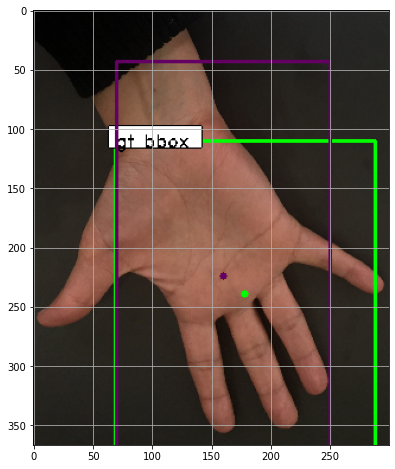

In [48]:
print('Original image: height=%d width=%d'%(image_data['height'], image_data['width']))
print('Resized image:  height=%d width=%d C.im_size=%d'%(X.shape[1], X.shape[2], C.im_size))
print('Feature map size: height=%d width=%d C.rpn_stride=%d'%(Y[0].shape[1], Y[0].shape[2], C.rpn_stride))
print(X.shape)
print(str(len(Y))+" includes 'y_rpn_cls' and 'y_rpn_regr'")
print('Shape of y_rpn_cls {}'.format(Y[0].shape))
print('Shape of y_rpn_regr {}'.format(Y[1].shape))
print(image_data)

print('Number of positive anchors for this image: %d' % (debug_num_pos))
if debug_num_pos==0:
    gt_x1, gt_x2 = image_data['bboxes'][0]['x1']*(X.shape[2]/image_data['height']), image_data['bboxes'][0]['x2']*(X.shape[2]/image_data['height'])
    gt_y1, gt_y2 = image_data['bboxes'][0]['y1']*(X.shape[1]/image_data['width']), image_data['bboxes'][0]['y2']*(X.shape[1]/image_data['width'])
    gt_x1, gt_y1, gt_x2, gt_y2 = int(gt_x1), int(gt_y1), int(gt_x2), int(gt_y2)

    img = debug_img.copy()
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    color = (0, 255, 0)
    cv2.putText(img, 'gt bbox', (gt_x1, gt_y1-5), cv2.FONT_HERSHEY_DUPLEX, 0.7, color, 1)
    cv2.rectangle(img, (gt_x1, gt_y1), (gt_x2, gt_y2), color, 2)
    cv2.circle(img, (int((gt_x1+gt_x2)/2), int((gt_y1+gt_y2)/2)), 3, color, -1)

    plt.grid()
    plt.imshow(img)
    plt.show()
else:
    cls = Y[0][0]
    pos_cls = np.where(cls==1)
    print(pos_cls)
    regr = Y[1][0]
    pos_regr = np.where(regr==1)
    print(pos_regr)
    print('y_rpn_cls for possible pos anchor: {}'.format(cls[pos_cls[0][0],pos_cls[1][0],:]))
    print('y_rpn_regr for positive anchor: {}'.format(regr[pos_regr[0][0],pos_regr[1][0],:]))

    gt_x1, gt_x2 = image_data['bboxes'][0]['x1']*(X.shape[2]/image_data['width']), image_data['bboxes'][0]['x2']*(X.shape[2]/image_data['width'])
    gt_y1, gt_y2 = image_data['bboxes'][0]['y1']*(X.shape[1]/image_data['height']), image_data['bboxes'][0]['y2']*(X.shape[1]/image_data['height'])
    gt_x1, gt_y1, gt_x2, gt_y2 = int(gt_x1), int(gt_y1), int(gt_x2), int(gt_y2)

    img = debug_img.copy()
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    color = (0, 255, 0)
    #cv2.putText(img, 'gt bbox', (gt_x1, gt_y1-5), cv2.FONT_HERSHEY_DUPLEX, 0.7, color, 1)
    cv2.rectangle(img, (gt_x1, gt_y1), (gt_x2, gt_y2), color, 2)
    cv2.circle(img, (int((gt_x1+gt_x2)/2), int((gt_y1+gt_y2)/2)), 3, color, -1)

    # Add text
    textLabel = 'gt bbox'
    (retval,baseLine) = cv2.getTextSize(textLabel,cv2.FONT_HERSHEY_COMPLEX,0.5,1)
    textOrg = (gt_x1, gt_y1+5)
    cv2.rectangle(img, (textOrg[0] - 5, textOrg[1]+baseLine - 5), (textOrg[0]+retval[0] + 5, textOrg[1]-retval[1] - 5), (0, 0, 0), 2)
    cv2.rectangle(img, (textOrg[0] - 5,textOrg[1]+baseLine - 5), (textOrg[0]+retval[0] + 5, textOrg[1]-retval[1] - 5), (255, 255, 255), -1)
    cv2.putText(img, textLabel, textOrg, cv2.FONT_HERSHEY_DUPLEX, 0.5, (0, 0, 0), 1)

    # Draw positive anchors according to the y_rpn_regr
    for i in range(debug_num_pos):

        color = (100+i*(155/4), 0, 100+i*(155/4))

        idx = pos_regr[2][i*4]/4
        anchor_size = C.anchor_box_scales[int(idx/3)]
        anchor_ratio = C.anchor_box_ratios[2-int((idx+1)%3)]

        center = (pos_regr[1][i*4]*C.rpn_stride, pos_regr[0][i*4]*C.rpn_stride)
        print('Center position of positive anchor: ', center)
        cv2.circle(img, center, 3, color, -1)
        anc_w, anc_h = anchor_size*anchor_ratio[0], anchor_size*anchor_ratio[1]
        cv2.rectangle(img, (center[0]-int(anc_w/2), center[1]-int(anc_h/2)), (center[0]+int(anc_w/2), center[1]+int(anc_h/2)), color, 2)
#         cv2.putText(img, 'pos anchor bbox '+str(i+1), (center[0]-int(anc_w/2), center[1]-int(anc_h/2)-5), cv2.FONT_HERSHEY_DUPLEX, 0.5, color, 1)

print('Green bboxes is ground-truth bbox. Others are positive anchors')
plt.figure(figsize=(8,8))
plt.grid()
plt.imshow(img)
plt.show()

#### Build the model

In [49]:
input_shape_img = (None, None, 3)

img_input = Input(shape=input_shape_img)
roi_input = Input(shape=(None, 4))

# define the base network (VGG here, can be Resnet50, Inception, etc)
shared_layers = nn_base(img_input, trainable=True)
print(shared_layers)


KerasTensor(type_spec=TensorSpec(shape=(None, None, None, 512), dtype=tf.float32, name=None), name='Placeholder:0', description="created by layer 'change_to_float'")


In [50]:
# define the RPN, built on the base layers
num_anchors = len(C.anchor_box_scales) * len(C.anchor_box_ratios) # 9
rpn = rpn_layer(shared_layers, num_anchors)

classifier = classifier_layer(shared_layers, roi_input, C.num_rois, nb_classes=len(classes_count))

model_rpn = Model(img_input, rpn[:2])
model_classifier = Model([img_input, roi_input], classifier)
print('1',img_input,'2',roi_input,'3',classifier)
# this is a model that holds both the RPN and the classifier, used to load/save weights for the models
model_all = Model([img_input, roi_input], rpn[:2] + classifier)

# Because the google colab can only run the session several hours one time (then you need to connect again), 
# we need to save the model and load the model to continue training
if not os.path.isfile(C.model_path):
    #If this is the begin of the training, load the pre-traind base network such as vgg-16
    try:
        print('This is the first time of your training')
        print('loading weights from {}'.format(C.base_net_weights))
        model_rpn.load_weights(C.base_net_weights, by_name=True)
        model_classifier.load_weights(C.base_net_weights, by_name=True)
    except:
        print('Could not load pretrained model weights. Weights can be found in the keras application folder \
            https://github.com/fchollet/keras/tree/master/keras/applications')
    
    # Create the record.csv file to record losses, acc and mAP
    record_df = pd.DataFrame(columns=['mean_overlapping_bboxes', 'class_acc', 'loss_rpn_cls', 'loss_rpn_regr', 'loss_class_cls', 'loss_class_regr', 'curr_loss', 'elapsed_time', 'mAP'])
else:
    # If this is a continued training, load the trained model from before
    print('Continue training based on previous trained model')
    print('Loading weights from {}'.format(C.model_path))
    model_rpn.load_weights(C.model_path, by_name=True)
    model_classifier.load_weights(C.model_path, by_name=True)
    
    # Load the records
    record_df = pd.read_csv(record_path)

    r_mean_overlapping_bboxes = record_df['mean_overlapping_bboxes']
    r_class_acc = record_df['class_acc']
    r_loss_rpn_cls = record_df['loss_rpn_cls']
    r_loss_rpn_regr = record_df['loss_rpn_regr']
    r_loss_class_cls = record_df['loss_class_cls']
    r_loss_class_regr = record_df['loss_class_regr']
    r_curr_loss = record_df['curr_loss']
    r_elapsed_time = record_df['elapsed_time']
    r_mAP = record_df['mAP']

    print('Already train %dK batches'% (len(record_df)))

1 KerasTensor(type_spec=TensorSpec(shape=(None, None, None, 3), dtype=tf.float32, name='input_1'), name='input_1', description="created by layer 'input_1'") 2 KerasTensor(type_spec=TensorSpec(shape=(None, None, 4), dtype=tf.float32, name='input_2'), name='input_2', description="created by layer 'input_2'") 3 [<KerasTensor: shape=(1, 4, 44) dtype=float32 (created by layer 'dense_class_44')>, <KerasTensor: shape=(1, 4, 172) dtype=float32 (created by layer 'dense_regress_44')>]
Continue training based on previous trained model
Loading weights from ./model/model_frcnn_vgg1025_1_AN_M.hdf5
Already train 40K batches


In [51]:
##### from keras import backend as K
from ipywidgets import interactive, fixed, FloatSlider, IntSlider
import numpy as np
import matplotlib.pyplot as plt
import math
import random
import seaborn as sns
%matplotlib inline
def lr_schedule(epoch):
    delta=0.30
    lam=2500
    D=0
    I0=0.95
    m=50
    b=15
#     b = 20
    x=0.2
    
    T0=0.015
    u0=0.75
    v0=0.001
    tv0=0
    assert lam != 0
    lam = 1 / lam
    T=[T0] + [0] * m #2.73
    u = [u0] + [0] * m 
    v=[v0] + [0] * m 
    tv=[tv0] + [0] * m     
    for k in range(1, m):
        T[k] = ((1 / (b + 1)) * (b + (math.tanh(x) ** k))* T[k-1])
    for k in range(0, m):
        u[k+1] = (1/(1+np.exp(-v[k]/lam)))
        v[k+1] = (delta*math.sin(math.pi*v[k])+D-T[k]*(u[k]-I0))
        tv[k] = math.sqrt((T[k]-v[k])**2)
#     print('Learning rate: ', tv[epoch])
#     f = plt.figure(figsize=(13,5))
#     sns.set_style("darkgrid")
#     plt.plot(tv,'.' )
#     plt.plot(tv,'.' )
    return tv[epoch]

# a = lr_schedule(40)

In [52]:
Epochs_num = 1
Run_number = 50

# Exponential Decay with learning rate
min_lr    = 1e-5                                      # 學習率的下限
init_lr   = 0.01                                       # 初始學習率
lr_decay  = -np.log(min_lr/init_lr)/(Run_number-1)     #（自動計算)的衰減係數
def exp_decay_lr(Run_number, init_lr, lr_decay):
    decays2 = np.arange(Run_number+0.0)
    for i in range(len(decays2)): 
        if i==0:
            decays2[i] = math.exp(-lr_decay*i)*init_lr
        else:
            decays2[i] = math.exp(-lr_decay*i)*init_lr*(1+decays2[i-1])
#         print(decays2[i])
    return decays2[Run_number-1]
# D2 = exp_decay_lr(Run_number, init_lr, lr_decay)

# Callbacks
patience0 = Run_number  # To prevent over fitting we will stop the learning after 10 epochs and val_loss value not decreased

In [53]:
initial_learning_rate = 0.1
lr_schedule_OK = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate,
    decay_steps=4,
    decay_rate=0.09,
    staircase=True)

In [54]:
import tensorflow as tf
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.metrics import classification_report, confusion_matrix
def get_f1(y_true, y_pred): #taken from old keras source code
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    precision = true_positives / (predicted_positives + K.epsilon())
    recall = true_positives / (possible_positives + K.epsilon())
    f1_val = 2*(precision*recall)/(precision+recall+K.epsilon())
    return f1_val
top1_acc = tf.keras.metrics.TopKCategoricalAccuracy(
    k=1, name='top_1_categorical_accuracy', dtype=None
)
top3_acc = tf.keras.metrics.TopKCategoricalAccuracy(
    k=3, name='top_3_categorical_accuracy', dtype=None
)
top5_acc = tf.keras.metrics.TopKCategoricalAccuracy(
    k=5, name='top_5_categorical_accuracy', dtype=None
)

In [56]:
# METRICS = [
#     'dense_class_{}'.format(len(classes_count)): 'accuracy',
# #     'accuracy',
# #     tf.keras.metrics.Precision(name='precision'),
# #     tf.keras.metrics.Recall(name='recall'),
# #     get_f1,
# #     top5_acc,
# #     top3_acc,
# #     top1_acc
# ]

optimizer = Adam(lr=1e-5)
optimizer_classifier = Adam(lr=1e-5)
model_rpn.compile(optimizer=optimizer, loss=[rpn_loss_cls(num_anchors), rpn_loss_regr(num_anchors)])
model_classifier.compile(optimizer=optimizer_classifier, 
                         loss=[class_loss_cls, class_loss_regr(len(classes_count)-1)], 
                         metrics={    'dense_class_{}'.format(len(classes_count)): 'accuracy',
}
                        )

model_all.compile(optimizer='sgd', loss='mae')

/usr/local/lib/python3.6/dist-packages/tensorflow/python/keras/optimizer_v2/optimizer_v2.py:375: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  "The `lr` argument is deprecated, use `learning_rate` instead.")


In [57]:
model_rpn.summary()
model_classifier.summary()
model_all.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv_bn (ConvBN)                (None, None, None, 1 128         input_1[0][0]                    
__________________________________________________________________________________________________
bneck (Bneck)                   (None, None, None, 6 1808        conv_bn[0][0]                    
__________________________________________________________________________________________________
bneck_1 (Bneck)                 (None, None, None, 6 9344        bneck[0][0]                      
______________________________________________________________________________________________

In [58]:
# Training setting
total_epochs = len(record_df)
r_epochs = len(record_df)

epoch_length = 1000
num_epochs = 40
iter_num = 0

total_epochs += num_epochs

losses = np.zeros((epoch_length, 5))
rpn_accuracy_rpn_monitor = []
rpn_accuracy_for_epoch = []

if len(record_df)==0:
    best_loss = np.Inf
else:
    best_loss = np.min(r_curr_loss)

In [59]:
print(len(record_df))

40


In [60]:
len(rpn_accuracy_rpn_monitor)

0

In [61]:
start_time = time.time()
for epoch_num in range(num_epochs):

    progbar = generic_utils.Progbar(epoch_length)
    print('Epoch {}/{}'.format(r_epochs + 1, total_epochs))
    
    print("O model_all")
    print(K.get_value(model_all.optimizer.lr))
    
    callbacks = lr_schedule(r_epochs)
    D2 = exp_decay_lr(r_epochs+1, init_lr, lr_decay)

    old_lr = K.get_value(model_classifier.optimizer.lr)
#     new_lr =D2  # change however you want EX
    new_lr =callbacks  # change however you want 
    K.set_value(model_all.optimizer.lr, new_lr)
    print("model_rpn")
    print(K.get_value(model_rpn.optimizer.lr))
    print("model_classifier")
    print(K.get_value(model_classifier.optimizer.lr))
    print("model_all")
    print(K.get_value(model_all.optimizer.lr))

    r_epochs += 1

    while True:
        try:

            if len(rpn_accuracy_rpn_monitor) == epoch_length and C.verbose:
                mean_overlapping_bboxes = float(sum(rpn_accuracy_rpn_monitor))/len(rpn_accuracy_rpn_monitor)
                rpn_accuracy_rpn_monitor = []
#                 print('Average number of overlapping bounding boxes from RPN = {} for {} previous iterations'.format(mean_overlapping_bboxes, epoch_length))
                if mean_overlapping_bboxes == 0:
                    print('RPN is not producing bounding boxes that overlap the ground truth boxes. Check RPN settings or keep training.')

            # Generate X (x_img) and label Y ([y_rpn_cls, y_rpn_regr])
            X, Y, img_data, debug_img, debug_num_pos = next(data_gen_train)

            # Train rpn model and get loss value [_, loss_rpn_cls, loss_rpn_regr]
            loss_rpn = model_rpn.train_on_batch(X, Y)

            # Get predicted rpn from rpn model [rpn_cls, rpn_regr]
            P_rpn = model_rpn.predict_on_batch(X)

            # R: bboxes (shape=(300,4))
            # Convert rpn layer to roi bboxes
            R = rpn_to_roi(P_rpn[0], P_rpn[1], C, K.image_data_format(), use_regr=True, overlap_thresh=0.7, max_boxes=300)
            
            # note: calc_iou converts from (x1,y1,x2,y2) to (x,y,w,h) format
            # X2: bboxes that iou > C.classifier_min_overlap for all gt bboxes in 300 non_max_suppression bboxes
            # Y1: one hot code for bboxes from above => x_roi (X)
            # Y2: corresponding labels and corresponding gt bboxes
            X2, Y1, Y2, IouS = calc_iou(R, img_data, C, class_mapping)

            # If X2 is None means there are no matching bboxes
            if X2 is None:
                rpn_accuracy_rpn_monitor.append(0)
                rpn_accuracy_for_epoch.append(0)
                continue
            
            # Find out the positive anchors and negative anchors
            neg_samples = np.where(Y1[0, :, -1] == 1)
            pos_samples = np.where(Y1[0, :, -1] == 0)

            if len(neg_samples) > 0:
                neg_samples = neg_samples[0]
            else:
                neg_samples = []

            if len(pos_samples) > 0:
                pos_samples = pos_samples[0]
            else:
                pos_samples = []

            rpn_accuracy_rpn_monitor.append(len(pos_samples))
            rpn_accuracy_for_epoch.append((len(pos_samples)))

            if C.num_rois > 1:
                # If number of positive anchors is larger than 4//2 = 2, randomly choose 2 pos samples
                if len(pos_samples) < C.num_rois//2:
                    selected_pos_samples = pos_samples.tolist()
                else:
                    selected_pos_samples = np.random.choice(pos_samples, C.num_rois//2, replace=False).tolist()
                
                # Randomly choose (num_rois - num_pos) neg samples
                try:
                    selected_neg_samples = np.random.choice(neg_samples, C.num_rois - len(selected_pos_samples), replace=False).tolist()
                except:
                    selected_neg_samples = np.random.choice(neg_samples, C.num_rois - len(selected_pos_samples), replace=True).tolist()
                
                # Save all the pos and neg samples in sel_samples
                sel_samples = selected_pos_samples + selected_neg_samples
            else:
                # in the extreme case where num_rois = 1, we pick a random pos or neg sample
                selected_pos_samples = pos_samples.tolist()
                selected_neg_samples = neg_samples.tolist()
                if np.random.randint(0, 2):
                    sel_samples = random.choice(neg_samples)
                else:
                    sel_samples = random.choice(pos_samples)

            # training_data: [X, X2[:, sel_samples, :]]
            # labels: [Y1[:, sel_samples, :], Y2[:, sel_samples, :]]
            #  X                     => img_data resized image
            #  X2[:, sel_samples, :] => num_rois (4 in here) bboxes which contains selected neg and pos
            #  Y1[:, sel_samples, :] => one hot encode for num_rois bboxes which contains selected neg and pos
            #  Y2[:, sel_samples, :] => labels and gt bboxes for num_rois bboxes which contains selected neg and pos
            loss_class = model_classifier.train_on_batch([X, tf.cast(X2[:, sel_samples, :],tf.float32)], [tf.cast(Y1[:, sel_samples, :],tf.float32), tf.cast(Y2[:, sel_samples, :],tf.float32)])

            losses[iter_num, 0] = loss_rpn[1]
            losses[iter_num, 1] = loss_rpn[2]

            losses[iter_num, 2] = loss_class[1]
            losses[iter_num, 3] = loss_class[2]
            losses[iter_num, 4] = loss_class[3]

            iter_num += 1

            progbar.update(iter_num, [('rpn_cls', np.mean(losses[:iter_num, 0])), ('rpn_regr', np.mean(losses[:iter_num, 1])),
                                      ('final_cls', np.mean(losses[:iter_num, 2])), ('final_regr', np.mean(losses[:iter_num, 3]))])

            if iter_num == epoch_length:
                loss_rpn_cls = np.mean(losses[:, 0])
                loss_rpn_regr = np.mean(losses[:, 1])
                loss_class_cls = np.mean(losses[:, 2])
                loss_class_regr = np.mean(losses[:, 3])
                class_acc = np.mean(losses[:, 4])

                mean_overlapping_bboxes = float(sum(rpn_accuracy_for_epoch)) / len(rpn_accuracy_for_epoch)
                rpn_accuracy_for_epoch = []

                if C.verbose:
                    print('Mean number of bounding boxes from RPN overlapping ground truth boxes: {}'.format(mean_overlapping_bboxes))
                    print('Classifier accuracy for bounding boxes from RPN: {}'.format(class_acc))
                    print('Loss RPN classifier: {}'.format(loss_rpn_cls))
                    print('Loss RPN regression: {}'.format(loss_rpn_regr))
                    print('Loss Detector classifier: {}'.format(loss_class_cls))
                    print('Loss Detector regression: {}'.format(loss_class_regr))
                    print('Total loss: {}'.format(loss_rpn_cls + loss_rpn_regr + loss_class_cls + loss_class_regr))
                    print('Elapsed time: {}'.format(time.time() - start_time))
                    elapsed_time = (time.time()-start_time)/60

                curr_loss = loss_rpn_cls + loss_rpn_regr + loss_class_cls + loss_class_regr
                iter_num = 0
                start_time = time.time()

                if curr_loss < best_loss:
                    if C.verbose:
                        print('Total loss decreased from {} to {}, saving weights'.format(best_loss,curr_loss))
                    best_loss = curr_loss
                    model_all.save_weights(C.model_path)

                new_row = {'mean_overlapping_bboxes':round(mean_overlapping_bboxes, 3), 
                           'class_acc':round(class_acc, 3), 
                           'loss_rpn_cls':round(loss_rpn_cls, 3), 
                           'loss_rpn_regr':round(loss_rpn_regr, 3), 
                           'loss_class_cls':round(loss_class_cls, 3), 
                           'loss_class_regr':round(loss_class_regr, 3), 
                           'curr_loss':round(curr_loss, 3), 
                           'elapsed_time':round(elapsed_time, 3), 
                           'mAP': 0}

                record_df = record_df.append(new_row, ignore_index=True)
                record_df.to_csv(record_path, index=0)

                break

        except Exception as e:
            print('Exception: {}'.format(e))
            continue

print('Training complete, exiting.')
# balala

Epoch 41/80
O model_all
0.01
model_rpn
1e-05
model_classifier
1e-05
model_all
0.00022754856
  33/1000 [..............................] - ETA: 20:07 - rpn_cls: 0.0852 - rpn_regr: 0.2860 - final_cls: 0.5024 - final_regr: 0.2614Exception:  required broadcastable shapes at loc(unknown)
	 [[node rpn_loss_regr_fixed_num/sub (defined at <ipython-input-32-84f9950f7cd7>:13) ]] [Op:__inference_train_function_28161]

Errors may have originated from an input operation.
Input Source operations connected to node rpn_loss_regr_fixed_num/sub:
 model/rpn_out_regress/BiasAdd (defined at <ipython-input-61-d924ebca542b>:40)

Function call stack:
train_function

  98/1000 [=>............................] - ETA: 12:19 - rpn_cls: 0.2232 - rpn_regr: 0.2966 - final_cls: 0.5167 - final_regr: 0.2435Exception:  required broadcastable shapes at loc(unknown)
	 [[node rpn_loss_regr_fixed_num/sub (defined at <ipython-input-32-84f9950f7cd7>:13) ]] [Op:__inference_train_function_28161]

Errors may have originated from 

IndexError: list index out of range

In [ ]:
# start_time = time.time()
# for epoch_num in range(num_epochs):

#     progbar = generic_utils.Progbar(epoch_length)
#     print('Epoch {}/{}'.format(r_epochs + 1, total_epochs))
#     new_lr = lr_schedule(r_epochs+1)  # change however you want
#     K.set_value(model.optimizer.lr, new_lr)
    
#     r_epochs += 1

# #     while True:
# #         try:

#     if len(rpn_accuracy_rpn_monitor) == epoch_length and C.verbose:
#         mean_overlapping_bboxes = float(sum(rpn_accuracy_rpn_monitor))/len(rpn_accuracy_rpn_monitor)
#         rpn_accuracy_rpn_monitor = []
# #     print('Average number of overlapping bounding boxes from RPN = {} for {} previous iterations'.format(mean_overlapping_bboxes, epoch_length))
#         if mean_overlapping_bboxes == 0:
#             print('RPN is not producing bounding boxes that overlap the ground truth boxes. Check RPN settings or keep training.')

#             # Generate X (x_img) and label Y ([y_rpn_cls, y_rpn_regr])
#     X, Y, img_data, debug_img, debug_num_pos = next(data_gen_train)

#             # Train rpn model and get loss value [_, loss_rpn_cls, loss_rpn_regr]
#     loss_rpn = model_rpn.train_on_batch(X, Y)

#             # Get predicted rpn from rpn model [rpn_cls, rpn_regr]
#     P_rpn = model_rpn.predict_on_batch(X)

#             # R: bboxes (shape=(300,4))
#             # Convert rpn layer to roi bboxes
#     R = rpn_to_roi(P_rpn[0], P_rpn[1], C, K.image_data_format(), use_regr=True, overlap_thresh=0.7, max_boxes=300)
            
#             # note: calc_iou converts from (x1,y1,x2,y2) to (x,y,w,h) format
#             # X2: bboxes that iou > C.classifier_min_overlap for all gt bboxes in 300 non_max_suppression bboxes
#             # Y1: one hot code for bboxes from above => x_roi (X)
#             # Y2: corresponding labels and corresponding gt bboxes
#     X2, Y1, Y2, IouS = (calc_iou(R, img_data, C, class_mapping))


#             # If X2 is None means there are no matching bboxes
#     if X2 is None:
#         rpn_accuracy_rpn_monitor.append(0)
#         rpn_accuracy_for_epoch.append(0)
#         continue
            
#             # Find out the positive anchors and negative anchors
#     neg_samples = np.where(Y1[0, :, -1] == 1)
#     pos_samples = np.where(Y1[0, :, -1] == 0)

#     if len(neg_samples) > 0:
#         neg_samples = neg_samples[0]
#     else:
#         neg_samples = []

#     if len(pos_samples) > 0:
#         pos_samples = pos_samples[0]
#     else:
#         pos_samples = []

#     rpn_accuracy_rpn_monitor.append(len(pos_samples))
#     rpn_accuracy_for_epoch.append((len(pos_samples)))

#     if C.num_rois > 1:
#             # If number of positive anchors is larger than 4//2 = 2, randomly choose 2 pos samples
#         if len(pos_samples) < C.num_rois//2:
#             selected_pos_samples = pos_samples.tolist()
#         else:
#             selected_pos_samples = np.random.choice(pos_samples, C.num_rois//2, replace=False).tolist()
                
#                 # Randomly choose (num_rois - num_pos) neg samples
#         try:
#             selected_neg_samples = np.random.choice(neg_samples, C.num_rois - len(selected_pos_samples), replace=False).tolist()
#         except:
#             selected_neg_samples = np.random.choice(neg_samples, C.num_rois - len(selected_pos_samples), replace=True).tolist()
                
#                 # Save all the pos and neg samples in sel_samples
#         sel_samples = selected_pos_samples + selected_neg_samples
#     else:
#                 # in the extreme case where num_rois = 1, we pick a random pos or neg sample
#         selected_pos_samples = pos_samples.tolist()
#         selected_neg_samples = neg_samples.tolist()
#         if np.random.randint(0, 2):
#             sel_samples = random.choice(neg_samples)
#         else:
#             sel_samples = random.choice(pos_samples)

#             # training_data: [X, X2[:, sel_samples, :]]
#             # labels: [Y1[:, sel_samples, :], Y2[:, sel_samples, :]]
#             #  X                     => img_data resized image
#             #  X2[:, sel_samples, :] => num_rois (4 in here) bboxes which contains selected neg and pos
#             #  Y1[:, sel_samples, :] => one hot encode for num_rois bboxes which contains selected neg and pos
#             #  Y2[:, sel_samples, :] => labels and gt bboxes for num_rois bboxes which contains selected neg and pos

#     print('X',X,'X2',tf.cast(X2[:, sel_samples, :],tf.float32),'Y1',Y1,'Y2',Y2[:, sel_samples, :])
#     loss_class = model_classifier.train_on_batch([X, tf.cast(X2[:, sel_samples, :],tf.float32)], [tf.cast(Y1[:, sel_samples, :],tf.float32), tf.cast(Y2[:, sel_samples, :],tf.float32)])
    
#     losses[iter_num, 0] = loss_rpn[1]
#     losses[iter_num, 1] = loss_rpn[2]

#     losses[iter_num, 2] = loss_class[1]
#     losses[iter_num, 3] = loss_class[2]
#     losses[iter_num, 4] = loss_class[3]

#     iter_num += 1
#     progbar.update(iter_num, [('rpn_cls', np.mean(losses[:iter_num, 0])), ('rpn_regr', np.mean(losses[:iter_num, 1])),
#                                       ('final_cls', np.mean(losses[:iter_num, 2])), ('final_regr', np.mean(losses[:iter_num, 3]))])

#     if iter_num == epoch_length:

#         loss_rpn_cls = np.mean(losses[:, 0])
#         loss_rpn_regr = np.mean(losses[:, 1])
#         loss_class_cls = np.mean(losses[:, 2])
#         loss_class_regr = np.mean(losses[:, 3])
#         class_acc = np.mean(losses[:, 4])

#         mean_overlapping_bboxes = float(sum(rpn_accuracy_for_epoch)) / len(rpn_accuracy_for_epoch)
#         rpn_accuracy_for_epoch = []

#         if C.verbose:
#             print('Mean number of bounding boxes from RPN overlapping ground truth boxes: {}'.format(mean_overlapping_bboxes))
#             print('Classifier accuracy for bounding boxes from RPN: {}'.format(class_acc))
#             print('Loss RPN classifier: {}'.format(loss_rpn_cls))
#             print('Loss RPN regression: {}'.format(loss_rpn_regr))
#             print('Loss Detector classifier: {}'.format(loss_class_cls))
#             print('Loss Detector regression: {}'.format(loss_class_regr))
#             print('Total loss: {}'.format(loss_rpn_cls + loss_rpn_regr + loss_class_cls + loss_class_regr))
#             print('Elapsed time: {}'.format(time.time() - start_time))
#             elapsed_time = (time.time()-start_time)/60

#         curr_loss = loss_rpn_cls + loss_rpn_regr + loss_class_cls + loss_class_regr
#         iter_num = 0
#         start_time = time.time()

#         if curr_loss < best_loss:
#             if C.verbose:
#                 print('Total loss decreased from {} to {}, saving weights'.format(best_loss,curr_loss))
#                 best_loss = curr_loss
#                 model_all.save_weights(C.model_path)
#                 new_row = {'mean_overlapping_bboxes':round(mean_overlapping_bboxes, 3), 
#                            'class_acc':round(class_acc, 3), 
#                            'loss_rpn_cls':round(loss_rpn_cls, 3), 
#                            'loss_rpn_regr':round(loss_rpn_regr, 3), 
#                            'loss_class_cls':round(loss_class_cls, 3), 
#                             'loss_class_regr':round(loss_class_regr, 3), 
#                            'curr_loss':round(curr_loss, 3), 
#                            'elapsed_time':round(elapsed_time, 3), 
#                            'mAP': 0}

#             record_df = record_df.append(new_row, ignore_index=True)
#             record_df.to_csv(record_path, index=0)

#             break

# #         except Exception as e:
# #             print('Exception: {}'.format(e))
# #             continue

# print('Training complete, exiting.')

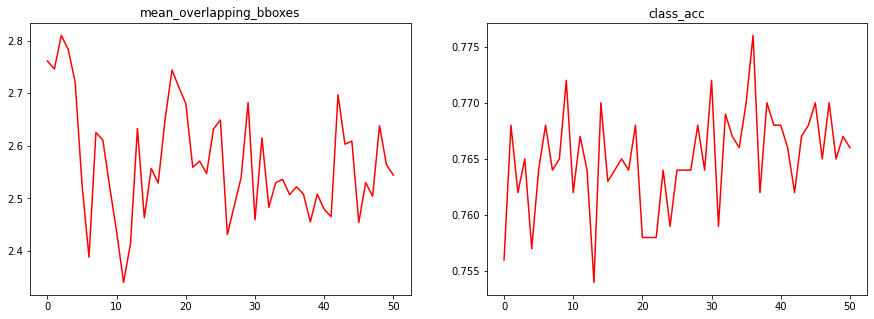

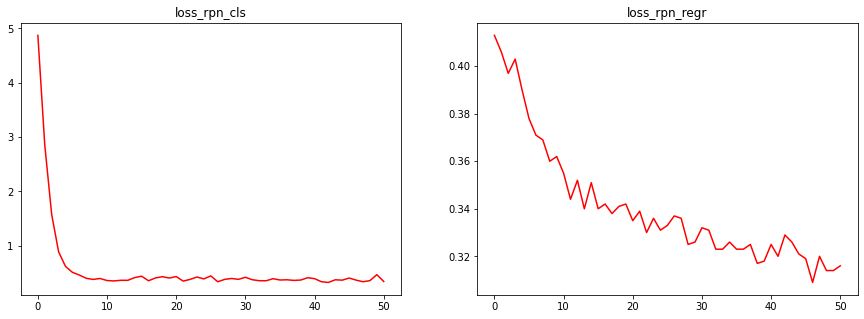

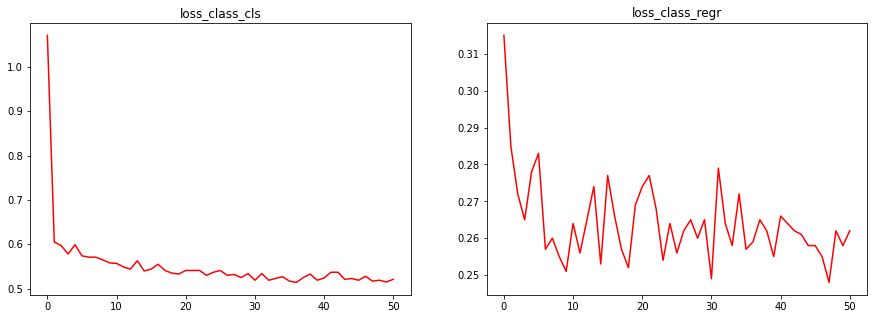

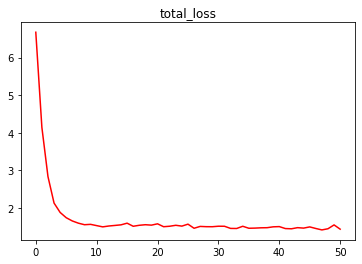

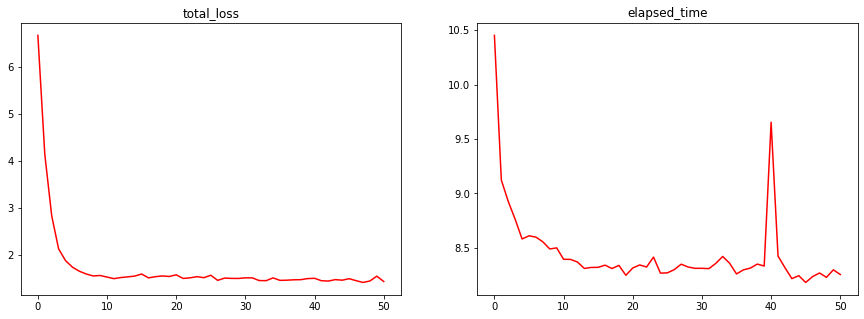

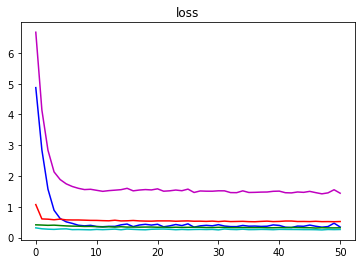

In [63]:
plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
plt.plot(np.arange(0, r_epochs), record_df['mean_overlapping_bboxes'], 'r')
plt.title('mean_overlapping_bboxes')
plt.subplot(1,2,2)
plt.plot(np.arange(0, r_epochs), record_df['class_acc'], 'r')
plt.title('class_acc')
plt.savefig("mean_overlapping_bboxes_and_class_acc.png")
plt.show()

plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
plt.plot(np.arange(0, r_epochs), record_df['loss_rpn_cls'], 'r')
plt.title('loss_rpn_cls')
plt.subplot(1,2,2)
plt.plot(np.arange(0, r_epochs), record_df['loss_rpn_regr'], 'r')
plt.title('loss_rpn_regr')
plt.savefig("loss_rpn_cls.png")
plt.show()


plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
plt.plot(np.arange(0, r_epochs), record_df['loss_class_cls'], 'r')
plt.title('loss_class_cls')
plt.subplot(1,2,2)
plt.plot(np.arange(0, r_epochs), record_df['loss_class_regr'], 'r')
plt.title('loss_class_regr')
plt.savefig("loss_class_regr.png")
plt.show()

plt.plot(np.arange(0, r_epochs), record_df['curr_loss'], 'r')
plt.title('total_loss')
plt.savefig("total_loss.png")
plt.show()

plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
plt.plot(np.arange(0, r_epochs), record_df['curr_loss'], 'r')
plt.title('total_loss')
plt.subplot(1,2,2)
plt.plot(np.arange(0, r_epochs), record_df['elapsed_time'], 'r')
plt.title('elapsed_time')
plt.savefig("elapsed_time.png")
plt.show()

plt.title('loss')
plt.plot(np.arange(0, r_epochs), record_df['loss_rpn_cls'], 'b')
plt.plot(np.arange(0, r_epochs), record_df['loss_rpn_regr'], 'g')
plt.plot(np.arange(0, r_epochs), record_df['loss_class_cls'], 'r')
plt.plot(np.arange(0, r_epochs), record_df['loss_class_regr'], 'c')
plt.plot(np.arange(0, r_epochs), record_df['curr_loss'], 'm')
plt.savefig("loss.png")

plt.show()


### Start Testing

In [64]:
base_path = './'

test_path = "plamtest.txt" # Test data (annotation file)

test_base_path = 'testcsv' # Directory to save the test images

config_output_filename = os.path.join(base_path, 'model_vgg_config.pickle')

In [65]:
with open(config_output_filename, 'rb') as f_in:
	C = pickle.load(f_in)

# turn off any data augmentation at test time
C.use_horizontal_flips = False
C.use_vertical_flips = False
C.rot_90 = False

In [66]:
# # Load the records
# record_df = pd.read_csv(C.record_path)

# r_epochs = len(record_df)

# plt.figure(figsize=(15,5))
# plt.subplot(1,2,1)
# plt.plot(np.arange(0, r_epochs), record_df['mean_overlapping_bboxes'], 'r')
# plt.title('mean_overlapping_bboxes')

# plt.subplot(1,2,2)
# plt.plot(np.arange(0, r_epochs), record_df['class_acc'], 'r')
# plt.title('class_acc')

# plt.show()

# plt.figure(figsize=(15,5))

# plt.subplot(1,2,1)
# plt.plot(np.arange(0, r_epochs), record_df['loss_rpn_cls'], 'r')
# plt.title('loss_rpn_cls')

# plt.subplot(1,2,2)
# plt.plot(np.arange(0, r_epochs), record_df['loss_rpn_regr'], 'r')
# plt.title('loss_rpn_regr')
# plt.show()
# plt.figure(figsize=(15,5))
# plt.subplot(1,2,1)
# plt.plot(np.arange(0, r_epochs), record_df['loss_class_cls'], 'r')
# plt.title('loss_class_cls')

# plt.subplot(1,2,2)
# plt.plot(np.arange(0, r_epochs), record_df['loss_class_regr'], 'r')
# plt.title('loss_class_regr')
# plt.show()
# plt.figure(figsize=(15,5))
# plt.subplot(1,2,1)
# plt.plot(np.arange(0, r_epochs), record_df['curr_loss'], 'r')
# plt.title('total_loss')

# plt.subplot(1,2,2)
# plt.plot(np.arange(0, r_epochs), record_df['elapsed_time'], 'r')
# plt.title('elapsed_time')

# plt.show()

In [67]:
def format_img_size(img, C):
	#print(img)
	""" formats the image size based on config """
	img_min_side = float(C.im_size)
	(height,width,_) = img.shape
		
	if width <= height:
		ratio = img_min_side/width
		new_height = int(ratio * height)
		new_width = int(img_min_side)
	else:
		ratio = img_min_side/height
		new_width = int(ratio * width)
		new_height = int(img_min_side)
	img = cv2.resize(img, (new_width, new_height), interpolation=cv2.INTER_CUBIC)
	return img, ratio	

def format_img_channels(img, C):
	""" formats the image channels based on config """
	img = img[:, :, (2, 1, 0)]
	img = img.astype(np.float32)
	img[:, :, 0] -= C.img_channel_mean[0]
	img[:, :, 1] -= C.img_channel_mean[1]
	img[:, :, 2] -= C.img_channel_mean[2]
	img /= C.img_scaling_factor
	img = np.transpose(img, (2, 0, 1))
	img = np.expand_dims(img, axis=0)
	return img

def format_img(img, C):
	""" formats an image for model prediction based on config """
	img, ratio = format_img_size(img, C)
	img = format_img_channels(img, C)
	return img, ratio

# Method to transform the coordinates of the bounding box to its original size
def get_real_coordinates(ratio, x1, y1, x2, y2):

	real_x1 = int(round(x1 // ratio))
	real_y1 = int(round(y1 // ratio))
	real_x2 = int(round(x2 // ratio))
	real_y2 = int(round(y2 // ratio))

	return (real_x1, real_y1, real_x2 ,real_y2)

In [68]:
num_features = 512

input_shape_img = (None, None, 3)
input_shape_features = (None, None, num_features)

img_input = Input(shape=input_shape_img)
roi_input = Input(shape=(C.num_rois, 4))
feature_map_input = Input(shape=input_shape_features)

# define the base network (VGG here, can be Resnet50, Inception, etc)
shared_layers = nn_base(img_input, trainable=True)

# define the RPN, built on the base layers
num_anchors = len(C.anchor_box_scales) * len(C.anchor_box_ratios)
rpn_layers = rpn_layer(shared_layers, num_anchors)

classifier = classifier_layer(feature_map_input, roi_input, C.num_rois, nb_classes=len(C.class_mapping))

model_rpn = Model(img_input, rpn_layers)
model_classifier_only = Model([feature_map_input, roi_input], classifier)

model_classifier = Model([feature_map_input, roi_input], classifier)

print('Loading weights from {}'.format(C.model_path))
model_rpn.load_weights(C.model_path, by_name=True)
model_classifier.load_weights(C.model_path, by_name=True)

model_rpn.compile(optimizer='sgd', loss='mse')
model_classifier.compile(optimizer='sgd', loss='mse')

Loading weights from ./model/model_frcnn_vgg1025_1_AN_M.hdf5


In [69]:
# Switch key value for class mapping
class_mapping = C.class_mapping
class_mapping = {v: k for k, v in class_mapping.items()}
print(class_mapping)
class_to_color = {class_mapping[v]: np.random.randint(0, 255, 3) for v in class_mapping}

{0: 'PALM_PRINT', 1: '1', 2: '2', 3: '3', 4: '4', 5: '5', 6: '6', 7: '7', 8: '8', 9: '9', 10: '10', 11: '11', 12: '12', 13: '13', 14: '14', 15: '15', 16: '16', 17: '17', 18: '18', 19: '19', 20: '20', 21: '21', 22: '22', 23: '23', 24: '24', 25: '25', 26: '26', 27: '27', 28: '28', 29: '29', 30: '30', 31: '31', 32: '32', 33: '33', 34: '34', 35: '35', 36: '36', 37: '37', 38: '38', 39: '39', 40: '40', 41: '41', 42: '43', 43: 'bg'}


In [70]:
test_imgs = os.listdir(test_base_path)

imgs_path = []
for i in range(50):
	idx = np.random.randint(len(test_imgs))
	imgs_path.append(test_imgs[idx])

all_imgs = []

classes = {}

003_S_L_21.JPG
Elapsed time = 4.472407579421997
[]


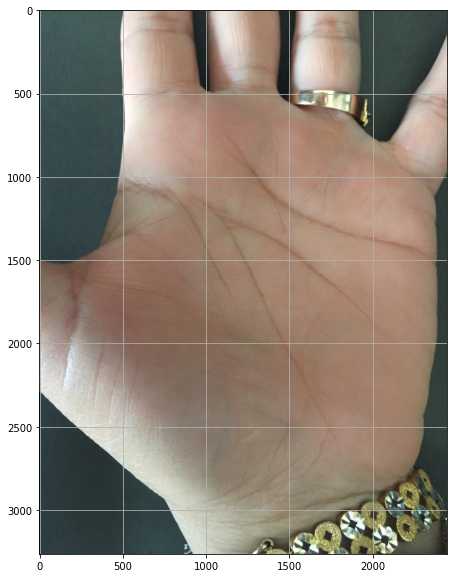

IMG_0024%20(4).JPG
Elapsed time = 4.272371768951416
[]


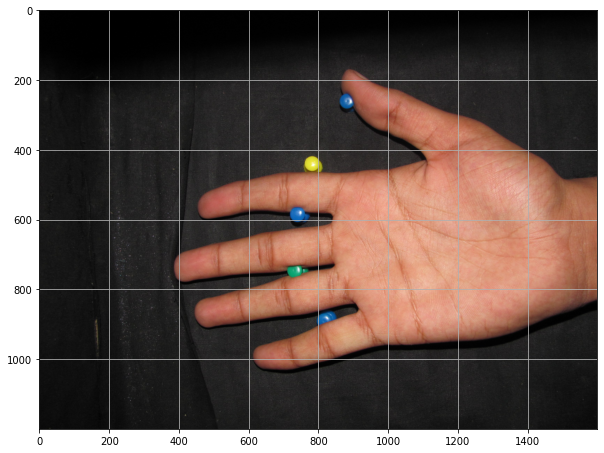

003_S_R_16.JPG
Elapsed time = 3.65561842918396
[]


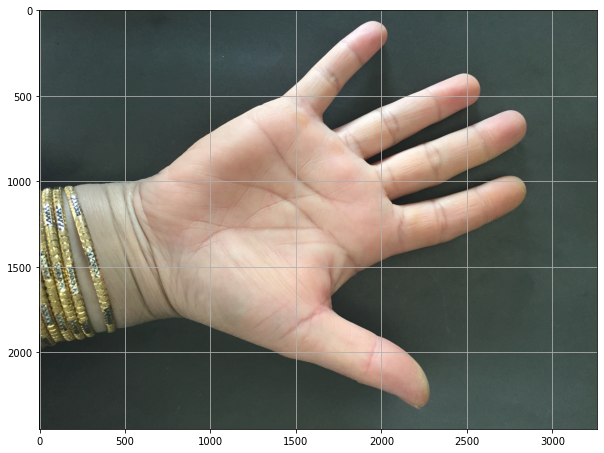

003_F_R_3.JPG
Elapsed time = 4.442054986953735
[]


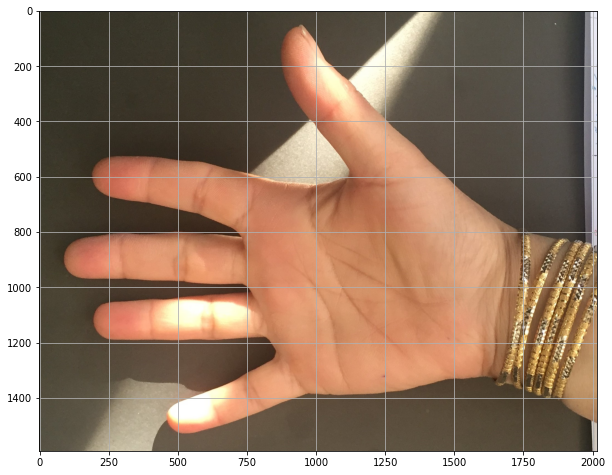

048_F_2.JPG
Elapsed time = 4.271100282669067
[]


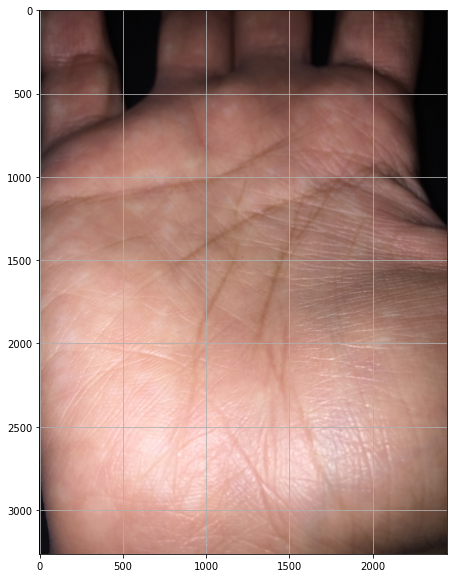

IMG_0022%20(6).JPG
Elapsed time = 3.898308277130127
[]


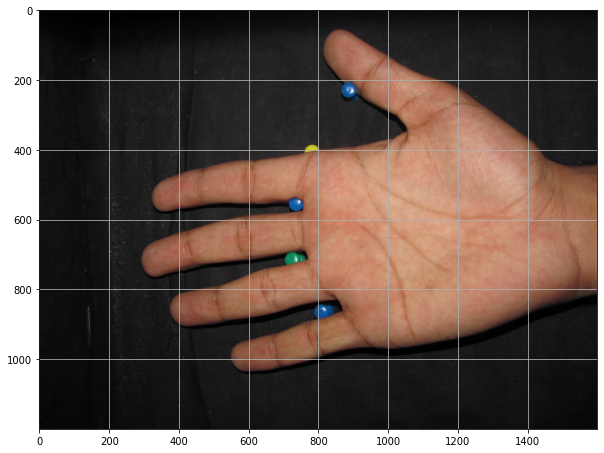

Hand_0008604.jpg
Elapsed time = 3.803457498550415
[]


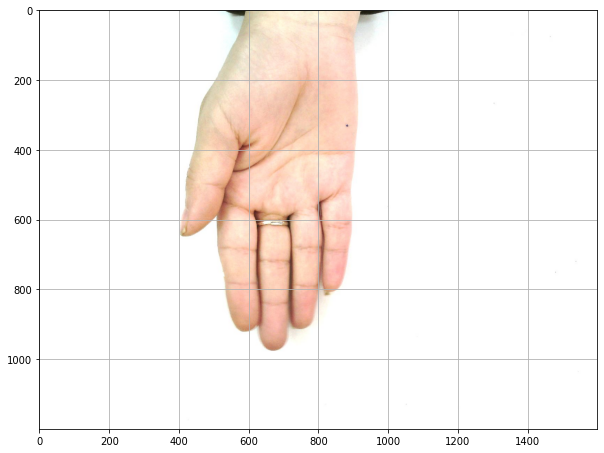

Hand_0008812.jpg
Elapsed time = 3.8204245567321777
[]


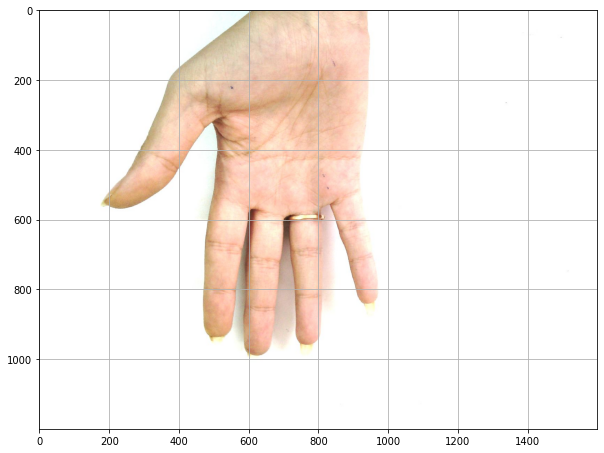

IMG_0023%20(5).JPG
Elapsed time = 3.6624042987823486
[]


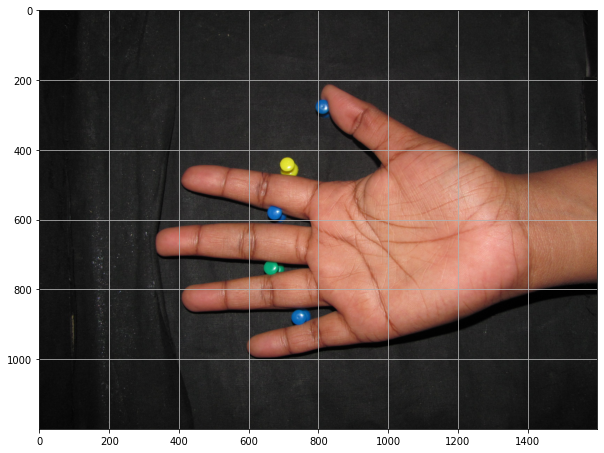

068_F_3.JPG
Elapsed time = 3.8820114135742188
[]


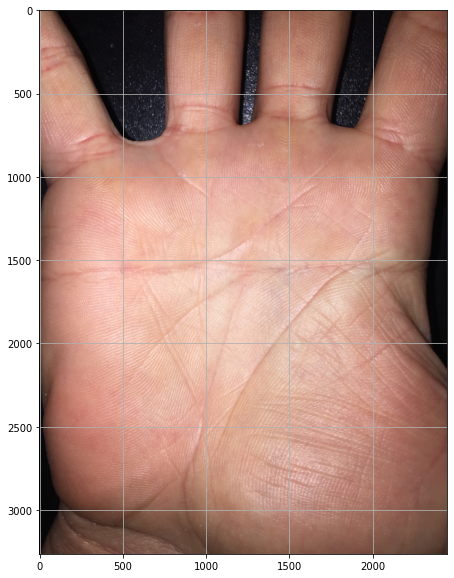

IMG_002%20(7).JPG
Elapsed time = 4.053603649139404
[]


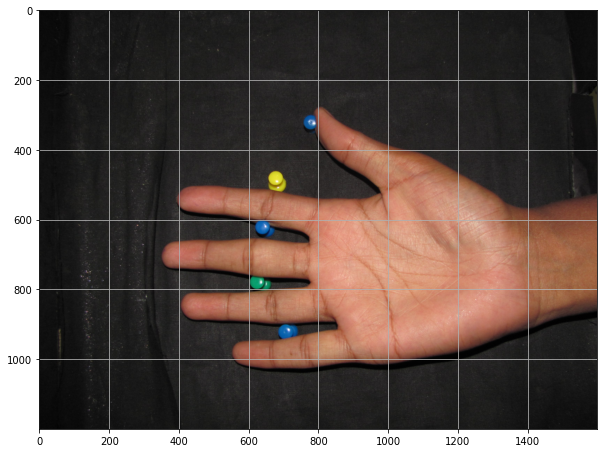

Hand_0008900.jpg
Elapsed time = 3.795989513397217
[]


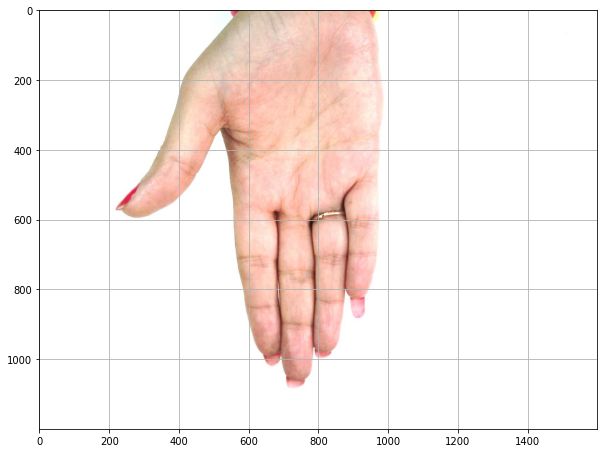

IMG_001%20(5).JPG
Elapsed time = 3.761809825897217
[]


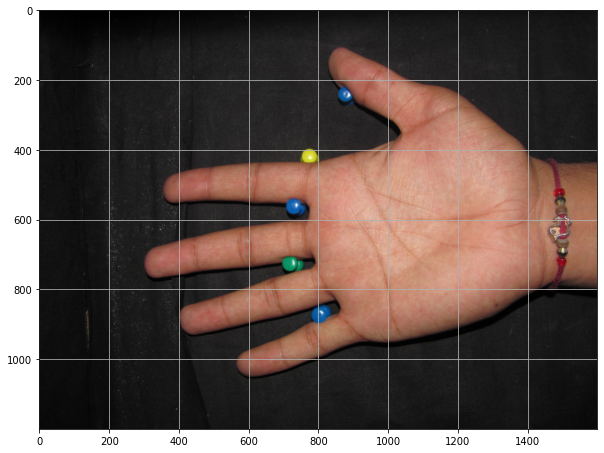

Hand_0008683.jpg
Elapsed time = 3.656574010848999
[]


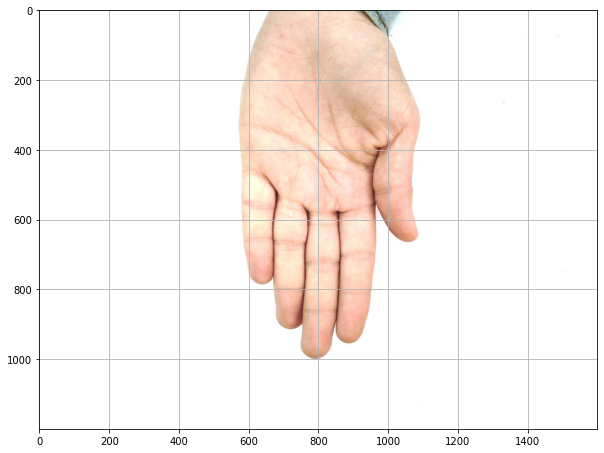

Hand_0008709.jpg
Elapsed time = 3.7799317836761475
[]


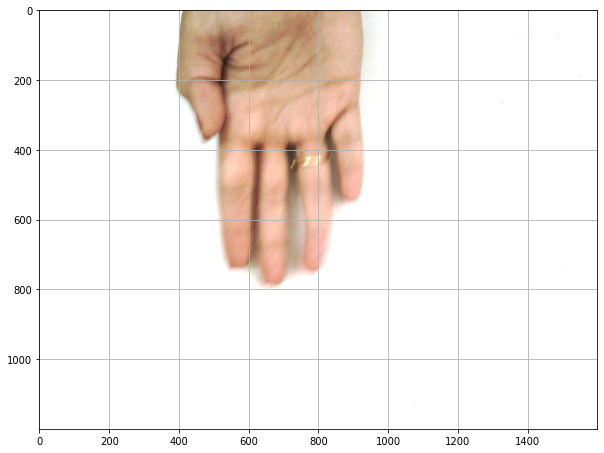

IMG_0026%20(4).JPG
Elapsed time = 3.666996479034424
[]


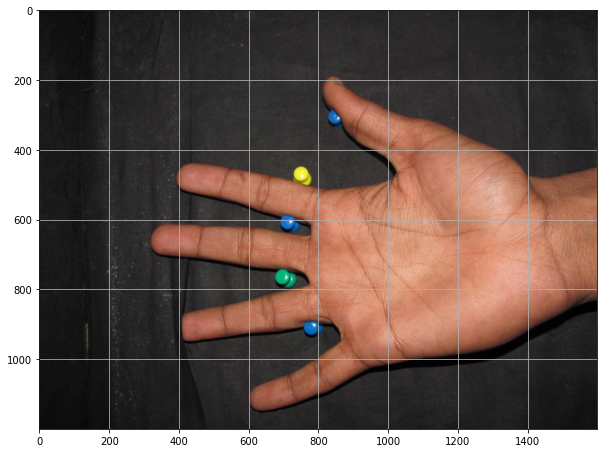

IMG_0029%20(8).JPG
Elapsed time = 3.616126775741577
[]


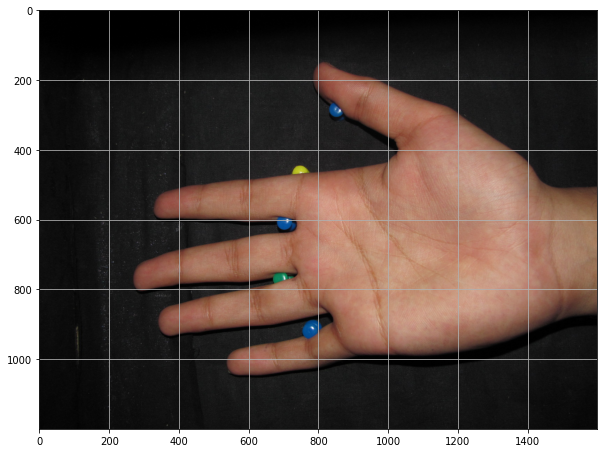

016_F_5.JPG
Elapsed time = 4.113750457763672
[]


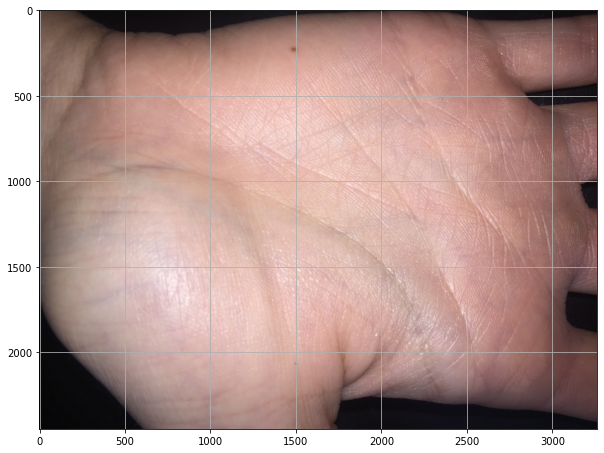

IMG_0019%20(6).JPG
Elapsed time = 3.5994746685028076
[]


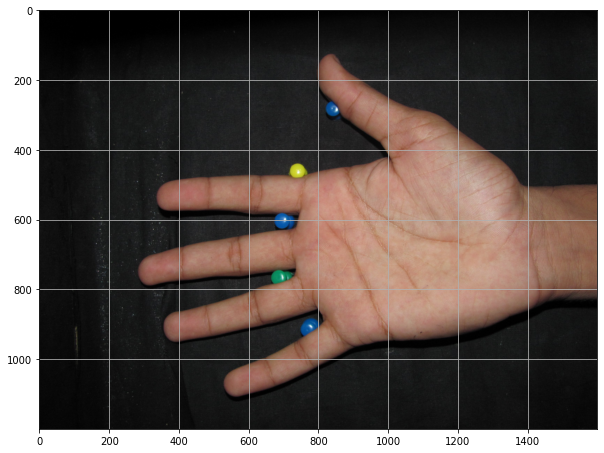

Hand_0008901.jpg
Elapsed time = 3.628021478652954
[]


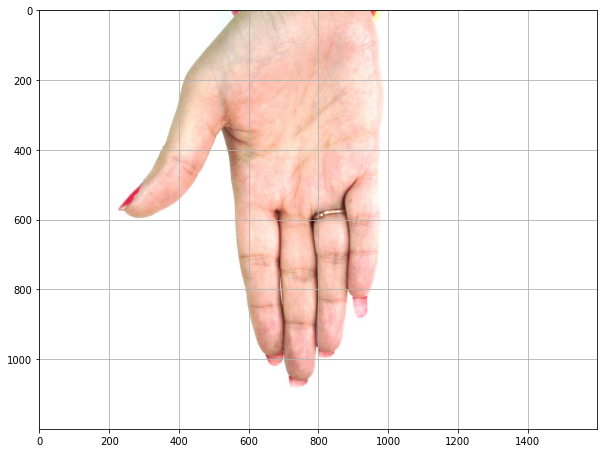

010_F_L_37.JPG
Elapsed time = 4.335330486297607
[]


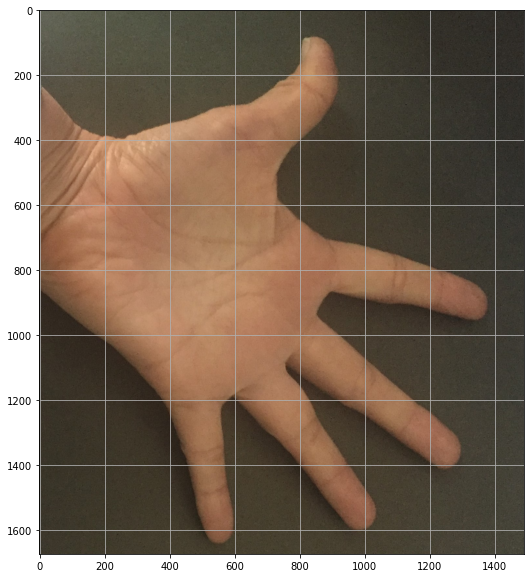

003_F_L_30.JPG
Elapsed time = 3.8324458599090576
[]


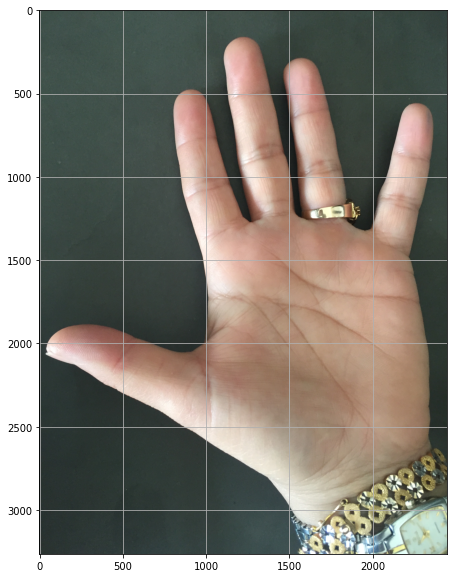

IMG_0027%20(4).JPG
Elapsed time = 3.952273368835449
[]


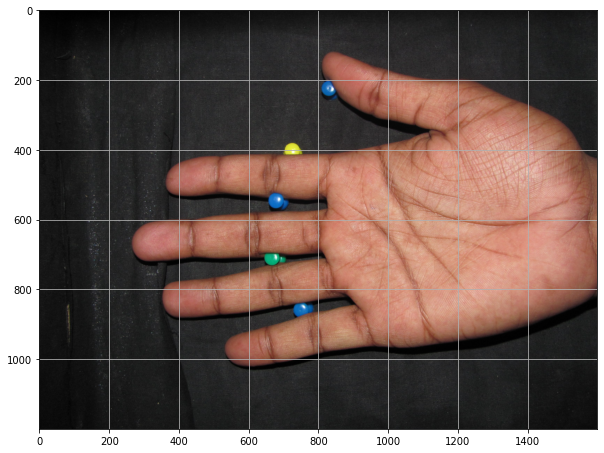

010_S_L_20.JPG
Elapsed time = 3.5768768787384033
[]


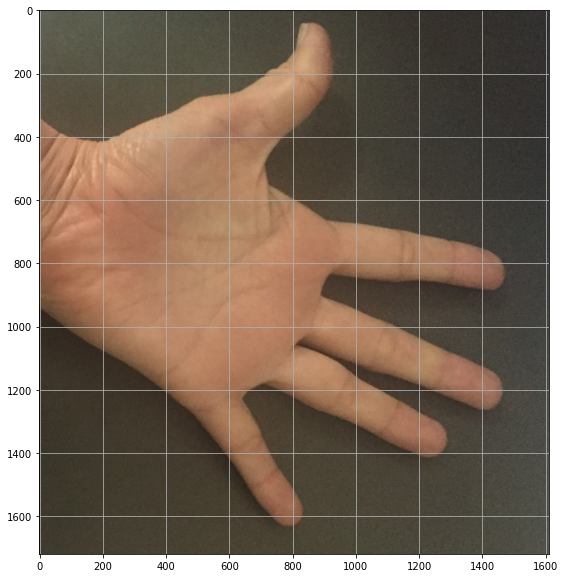

IMG_001%20(7).JPG
Elapsed time = 3.5980021953582764
[]


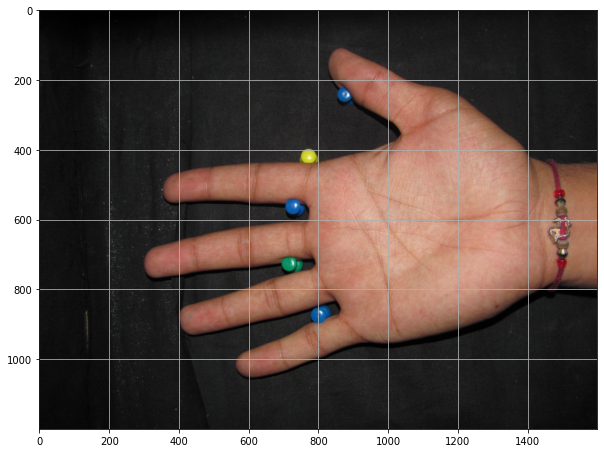

003_S_L_28.JPG
Elapsed time = 3.840646266937256
[]


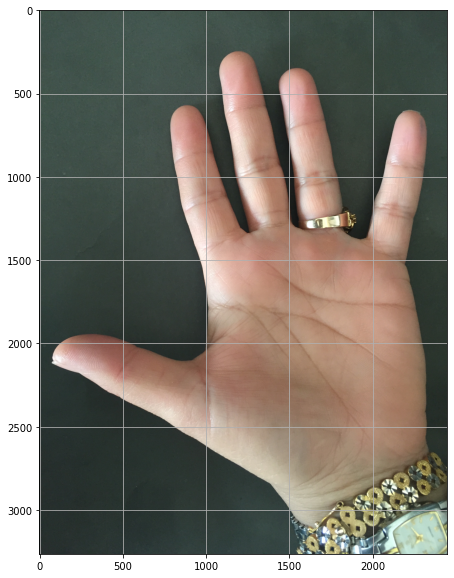

015_S_L_28.JPG
Elapsed time = 3.5964720249176025
[]


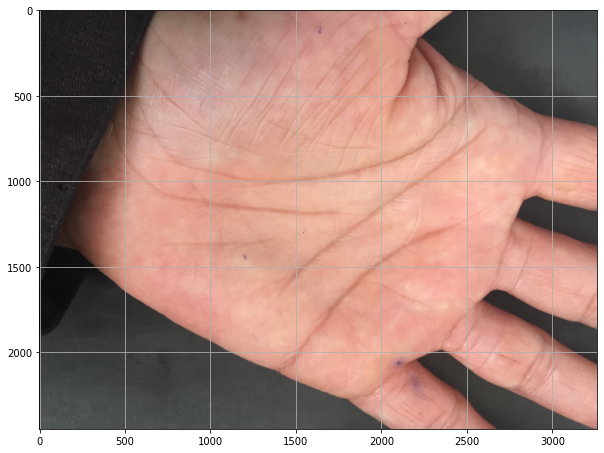

010_S_L_23.JPG
Elapsed time = 3.4854507446289062
[]


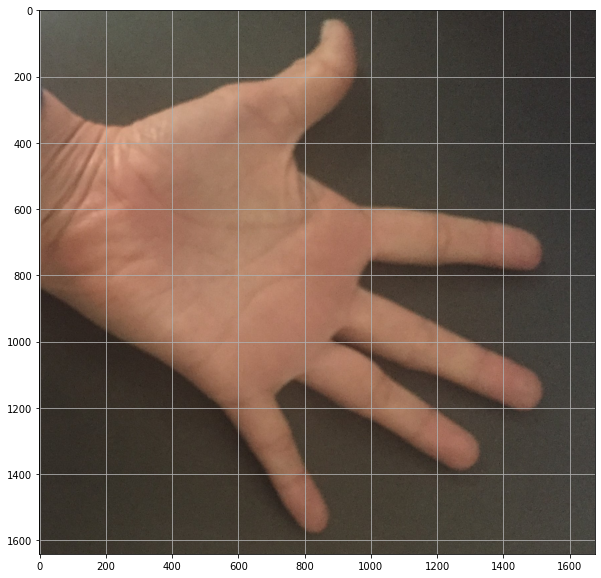

037_F_0.JPG
Elapsed time = 3.6793079376220703
[]


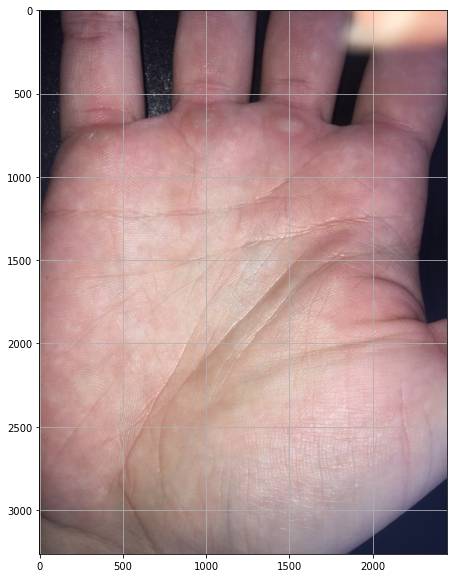

039_F_0.JPG
Elapsed time = 4.266319990158081
[]


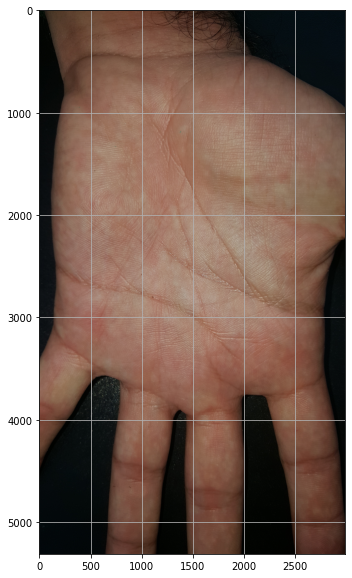

048_P_26.JPG
Elapsed time = 3.6253440380096436
[]


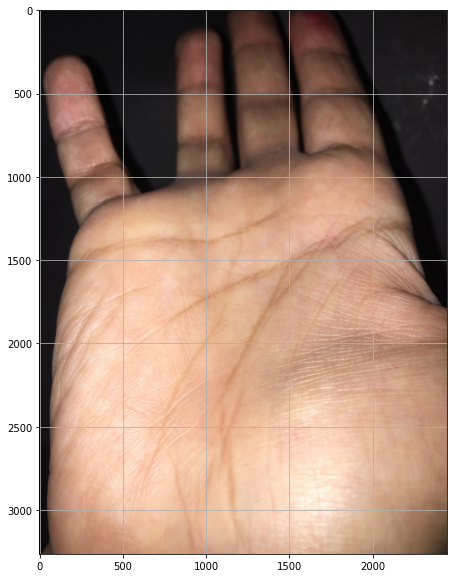

IMG_0022%20(4).JPG
Elapsed time = 3.63642954826355
[]


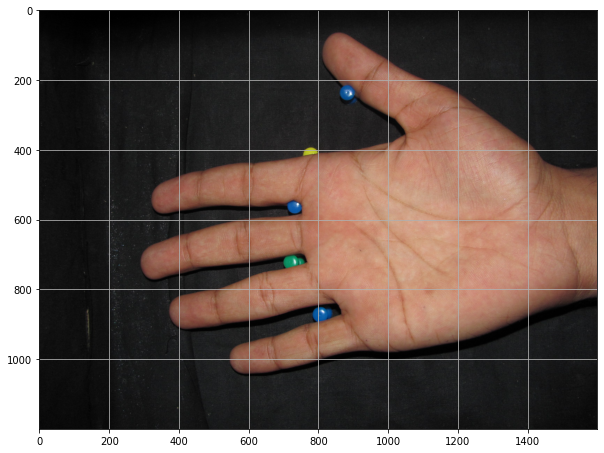

078_F_4.JPG
Elapsed time = 3.7128992080688477
[]


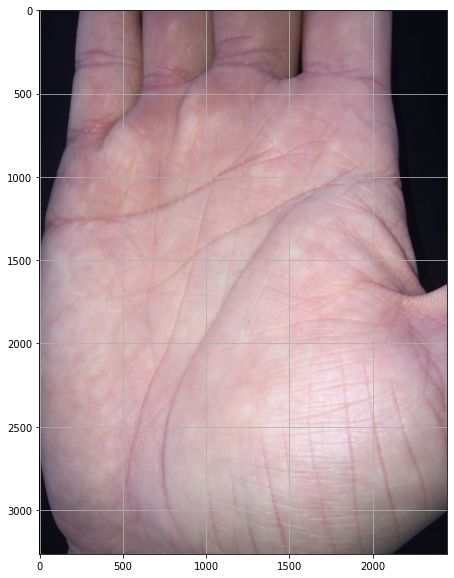

015_F_R_5.JPG
Elapsed time = 3.7235770225524902
[]


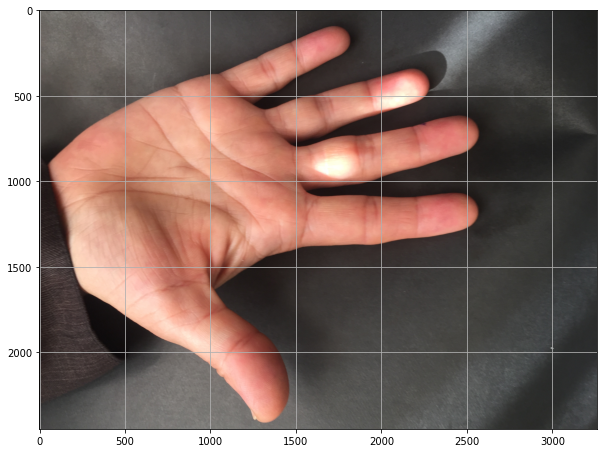

078_F_8.JPG
Elapsed time = 3.7505698204040527
[]


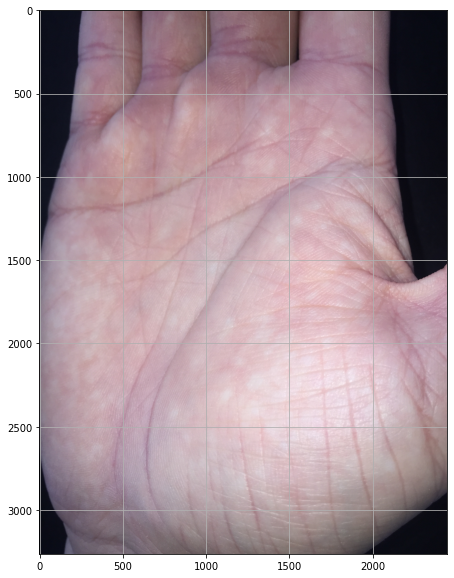

048_RF_13.JPG
Elapsed time = 3.9907641410827637
[]


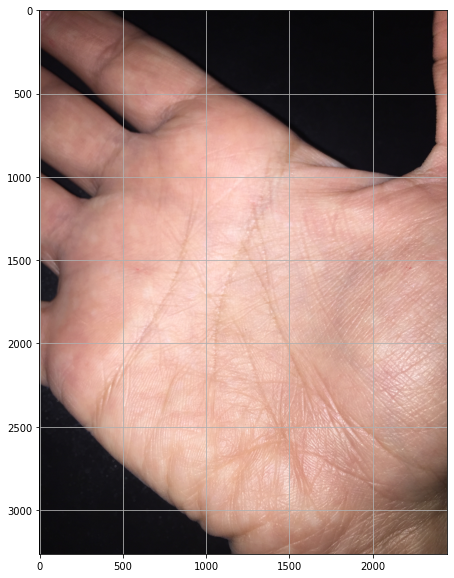

068_F_9.JPG
Elapsed time = 4.021022319793701
[]


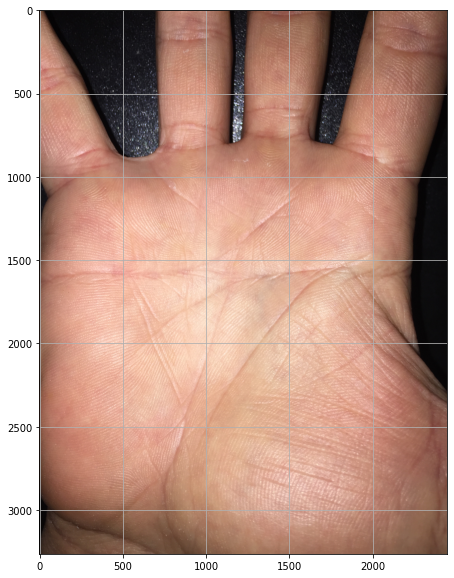

IMG_002%20(6).jpg
Elapsed time = 3.8016233444213867
[]


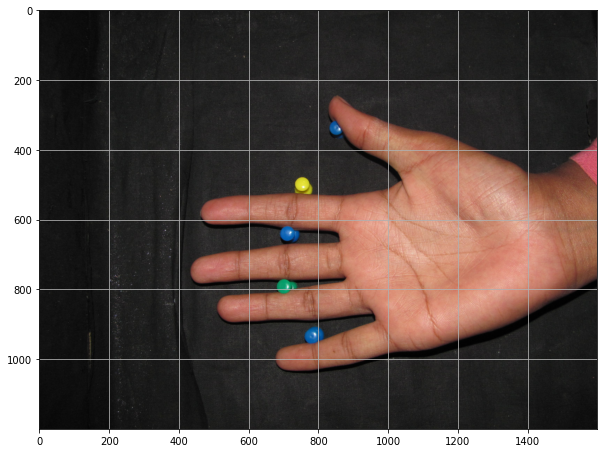

IMG_0023%20(8).jpg
Elapsed time = 3.745750665664673
[]


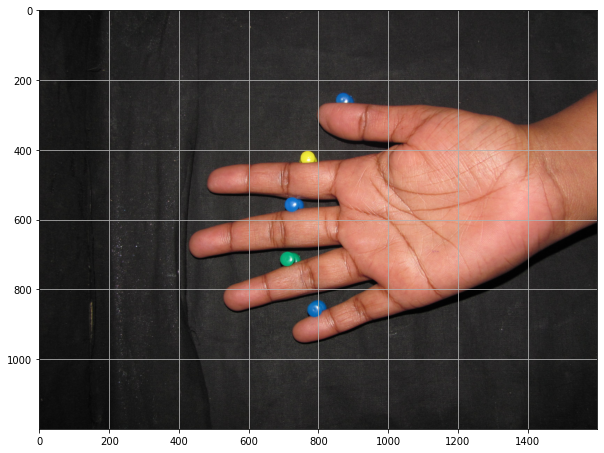

048_P_28.JPG
Elapsed time = 3.8130850791931152
[]


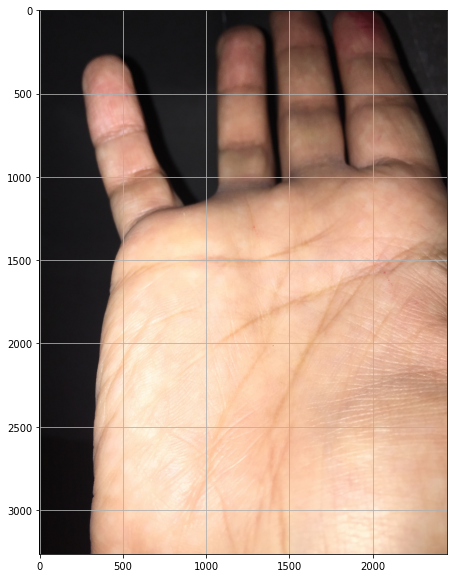

010_S_L_23.JPG
Elapsed time = 3.8674368858337402
[]


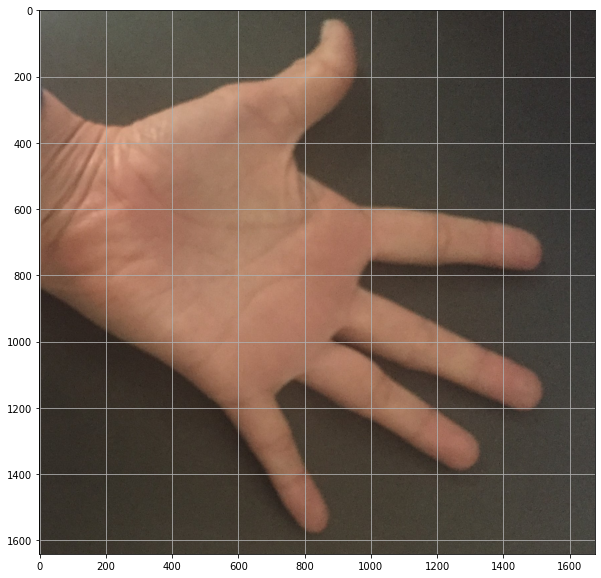

Hand_0008713.jpg
Elapsed time = 3.5662167072296143
[]


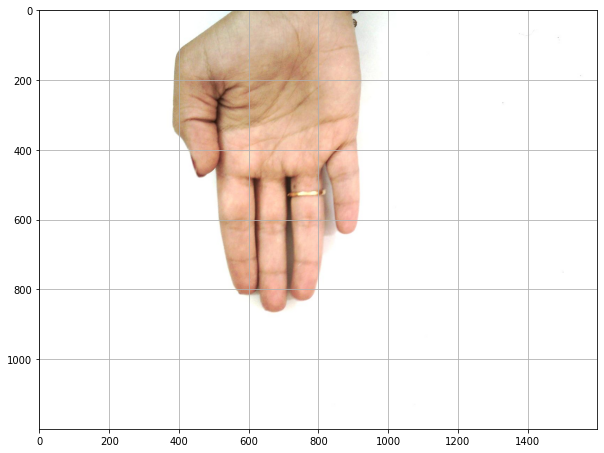

010_S_R_19.JPG
Elapsed time = 3.920285940170288
[]


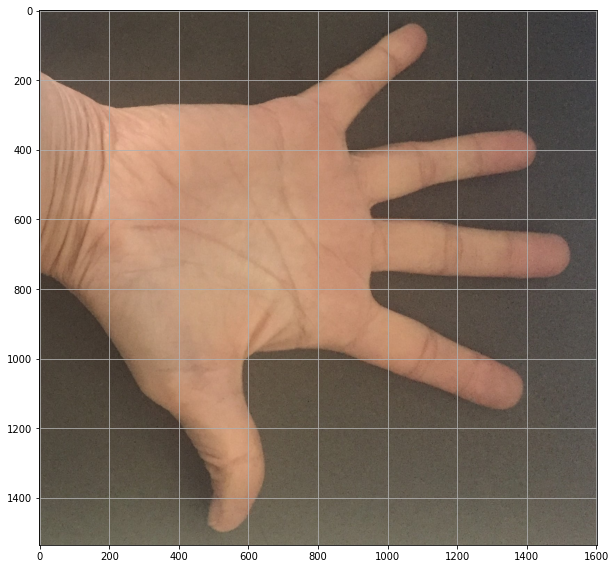

IMG_0029%20(8).JPG
Elapsed time = 3.752127170562744
[]


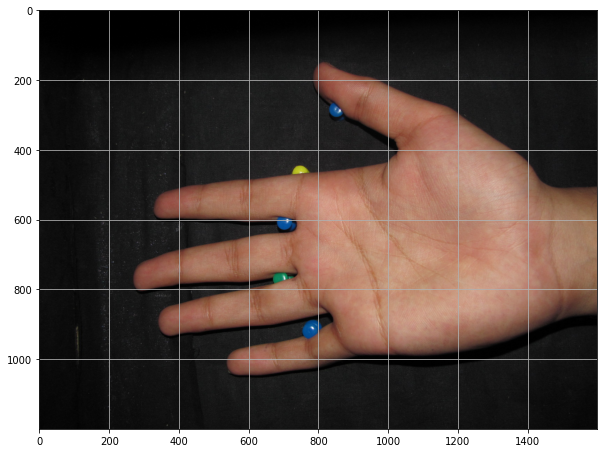

Hand_0000067.jpg
Elapsed time = 3.8051412105560303
[]


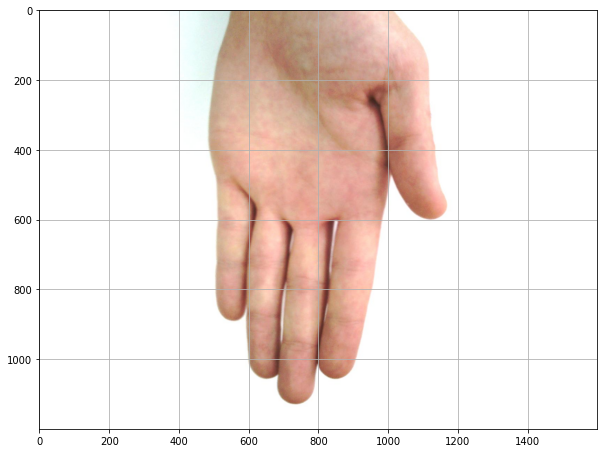

IMG_0018%20(1).JPG
Elapsed time = 3.838233232498169
[]


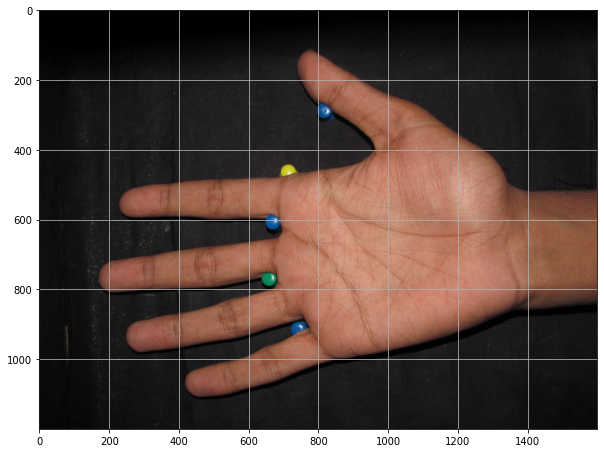

Hand_0008607.jpg
Elapsed time = 3.6847949028015137
[]


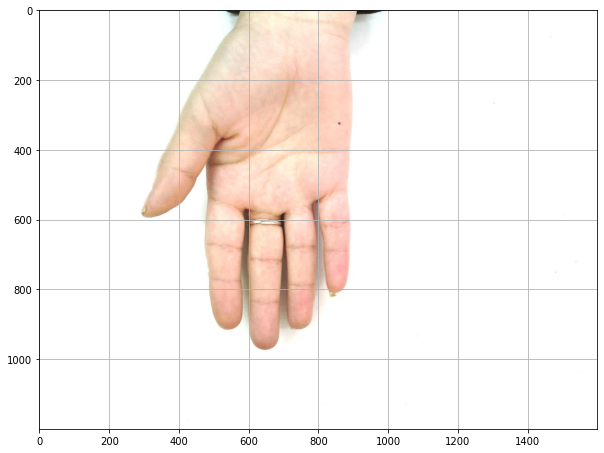

078_F_3.JPG
Elapsed time = 3.6359612941741943
[]


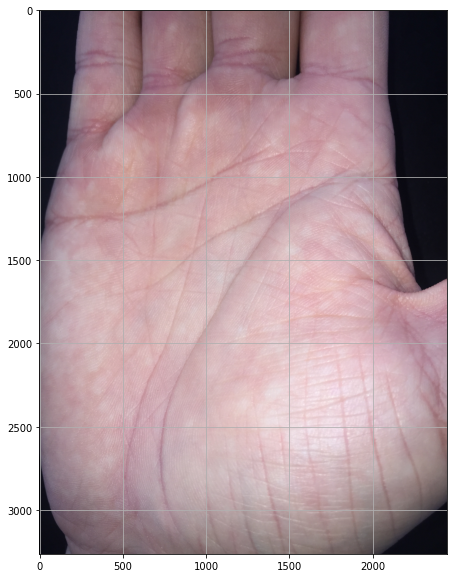

Hand_0000066.jpg
Elapsed time = 4.01060938835144
[]


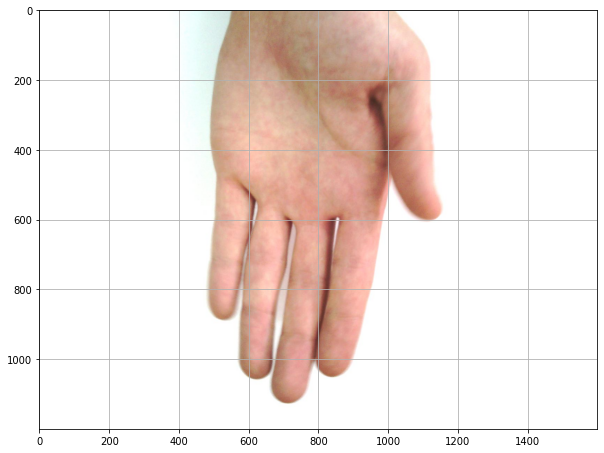

IMG_0023%20(6).JPG
Elapsed time = 3.687737226486206
[]


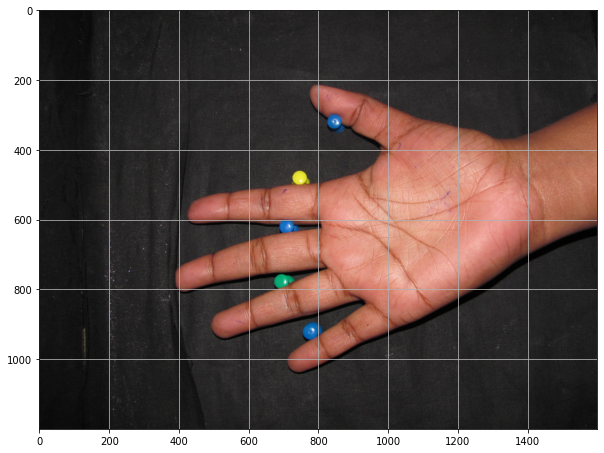

In [71]:
# If the box classification value is less than this, we ignore this box
bbox_threshold = 0.8

for idx, img_name in enumerate(imgs_path):
    if not img_name.lower().endswith(('.bmp', '.jpeg', '.jpg', '.png', '.tif', '.tiff')):
        continue
    print(img_name)
    st = time.time()
    filepath = os.path.join(test_base_path, img_name)

    img = cv2.imread(filepath)

    X, ratio = format_img(img, C)
    
    X = np.transpose(X, (0, 2, 3, 1))

    # get output layer Y1, Y2 from the RPN and the feature maps F
    # Y1: y_rpn_cls
    # Y2: y_rpn_regr
    [Y1, Y2, F] = model_rpn.predict(X)

    # Get bboxes by applying NMS 
    # R.shape = (300, 4)
    R = rpn_to_roi(Y1, Y2, C, K.image_data_format(), overlap_thresh=0.7)

    # convert from (x1,y1,x2,y2) to (x,y,w,h)
    R[:, 2] -= R[:, 0]
    R[:, 3] -= R[:, 1]

    # apply the spatial pyramid pooling to the proposed regions
    bboxes = {}
    probs = {}

    for jk in range(R.shape[0]//C.num_rois + 1):
        ROIs = np.expand_dims(R[C.num_rois*jk:C.num_rois*(jk+1), :], axis=0)
        if ROIs.shape[1] == 0:
            break

        if jk == R.shape[0]//C.num_rois:
            #pad R
            curr_shape = ROIs.shape
            target_shape = (curr_shape[0],C.num_rois,curr_shape[2])
            ROIs_padded = np.zeros(target_shape).astype(ROIs.dtype)
            ROIs_padded[:, :curr_shape[1], :] = ROIs
            ROIs_padded[0, curr_shape[1]:, :] = ROIs[0, 0, :]
            ROIs = ROIs_padded

        [P_cls, P_regr] = model_classifier_only.predict([F, ROIs])

        # Calculate bboxes coordinates on resized image
        for ii in range(P_cls.shape[1]):
            # Ignore 'bg' class
            if np.max(P_cls[0, ii, :]) < bbox_threshold or np.argmax(P_cls[0, ii, :]) == (P_cls.shape[2] - 1):
                continue

            cls_name = class_mapping[np.argmax(P_cls[0, ii, :])]

            if cls_name not in bboxes:
                bboxes[cls_name] = []
                probs[cls_name] = []

            (x, y, w, h) = ROIs[0, ii, :]

            cls_num = np.argmax(P_cls[0, ii, :])
            try:
                (tx, ty, tw, th) = P_regr[0, ii, 4*cls_num:4*(cls_num+1)]
                tx /= C.classifier_regr_std[0]
                ty /= C.classifier_regr_std[1]
                tw /= C.classifier_regr_std[2]
                th /= C.classifier_regr_std[3]
                x, y, w, h = apply_regr(x, y, w, h, tx, ty, tw, th)
            except:
                pass
            bboxes[cls_name].append([C.rpn_stride*x, C.rpn_stride*y, C.rpn_stride*(x+w), C.rpn_stride*(y+h)])
            probs[cls_name].append(np.max(P_cls[0, ii, :]))

    all_dets = []

    for key in bboxes:
        bbox = np.array(bboxes[key])

        new_boxes, new_probs = non_max_suppression_fast(bbox, np.array(probs[key]), overlap_thresh=0.2)
        for jk in range(new_boxes.shape[0]):
            (x1, y1, x2, y2) = new_boxes[jk,:]

            # Calculate real coordinates on original image
            (real_x1, real_y1, real_x2, real_y2) = get_real_coordinates(ratio, x1, y1, x2, y2)

            cv2.rectangle(img,(real_x1, real_y1), (real_x2, real_y2), (int(class_to_color[key][0]), int(class_to_color[key][1]), int(class_to_color[key][2])),4)

            textLabel = '{}: {}'.format(key,int(100*new_probs[jk]))
            all_dets.append((key,100*new_probs[jk]))

            (retval,baseLine) = cv2.getTextSize(textLabel,cv2.FONT_HERSHEY_COMPLEX,1,1)
            textOrg = (real_x1, real_y1-0)

            cv2.rectangle(img, (textOrg[0] - 5, textOrg[1]+baseLine - 5), (textOrg[0]+retval[0] + 5, textOrg[1]-retval[1] - 5), (0, 0, 0), 1)
            cv2.rectangle(img, (textOrg[0] - 5,textOrg[1]+baseLine - 5), (textOrg[0]+retval[0] + 5, textOrg[1]-retval[1] - 5), (255, 255, 255), -1)
            cv2.putText(img, textLabel, textOrg, cv2.FONT_HERSHEY_DUPLEX, 1, (0, 0, 0), 1)

    print('Elapsed time = {}'.format(time.time() - st))
    print(all_dets)
    plt.figure(figsize=(10,10))
    plt.grid()
    plt.imshow(cv2.cvtColor(img,cv2.COLOR_BGR2RGB))
    plt.show()

In [72]:
def get_map(pred, gt, f):
	T = {}
	P = {}
	fx, fy = f

	for bbox in gt:
		bbox['bbox_matched'] = False

	pred_probs = np.array([s['prob'] for s in pred])
	box_idx_sorted_by_prob = np.argsort(pred_probs)[::-1]

	for box_idx in box_idx_sorted_by_prob:
		pred_box = pred[box_idx]
		pred_class = pred_box['class']
		pred_x1 = pred_box['x1']
		pred_x2 = pred_box['x2']
		pred_y1 = pred_box['y1']
		pred_y2 = pred_box['y2']
		pred_prob = pred_box['prob']
		if pred_class not in P:
			P[pred_class] = []
			T[pred_class] = []
		P[pred_class].append(pred_prob)
		found_match = False

		for gt_box in gt:
			gt_class = gt_box['class']
			gt_x1 = gt_box['x1']/fx
			gt_x2 = gt_box['x2']/fx
			gt_y1 = gt_box['y1']/fy
			gt_y2 = gt_box['y2']/fy
			gt_seen = gt_box['bbox_matched']
			if gt_class != pred_class:
				continue
			if gt_seen:
				continue
			iou_map = iou((pred_x1, pred_y1, pred_x2, pred_y2), (gt_x1, gt_y1, gt_x2, gt_y2))
			if iou_map >= 0.5:
				found_match = True
				gt_box['bbox_matched'] = True
				break
			else:
				continue

		T[pred_class].append(int(found_match))

	for gt_box in gt:
		if not gt_box['bbox_matched']:# and not gt_box['difficult']:
			if gt_box['class'] not in P:
				P[gt_box['class']] = []
				T[gt_box['class']] = []

			T[gt_box['class']].append(1)
			P[gt_box['class']].append(0)

	#import pdb
	#pdb.set_trace()
	return T, P

In [73]:
def format_img_map(img, C):
	"""Format image for mAP. Resize original image to C.im_size (300 in here)

	Args:
		img: cv2 image
		C: config

	Returns:
		img: Scaled and normalized image with expanding dimension
		fx: ratio for width scaling
		fy: ratio for height scaling
	"""

	img_min_side = float(C.im_size)
	(height,width,_) = img.shape
	
	if width <= height:
		f = img_min_side/width
		new_height = int(f * height)
		new_width = int(img_min_side)
	else:
		f = img_min_side/height
		new_width = int(f * width)
		new_height = int(img_min_side)
	fx = width/float(new_width)
	fy = height/float(new_height)
	img = cv2.resize(img, (new_width, new_height), interpolation=cv2.INTER_CUBIC)
	# Change image channel from BGR to RGB
	img = img[:, :, (2, 1, 0)]
	img = img.astype(np.float32)
	img[:, :, 0] -= C.img_channel_mean[0]
	img[:, :, 1] -= C.img_channel_mean[1]
	img[:, :, 2] -= C.img_channel_mean[2]
	img /= C.img_scaling_factor
	# Change img shape from (height, width, channel) to (channel, height, width)
	img = np.transpose(img, (2, 0, 1))
	# Expand one dimension at axis 0
	# img shape becames (1, channel, height, width)
	img = np.expand_dims(img, axis=0)
	return img, fx, fy

In [74]:
print(class_mapping)
test_imgs, _, _ = get_data(test_path)

{0: 'PALM_PRINT', 1: '1', 2: '2', 3: '3', 4: '4', 5: '5', 6: '6', 7: '7', 8: '8', 9: '9', 10: '10', 11: '11', 12: '12', 13: '13', 14: '14', 15: '15', 16: '16', 17: '17', 18: '18', 19: '19', 20: '20', 21: '21', 22: '22', 23: '23', 24: '24', 25: '25', 26: '26', 27: '27', 28: '28', 29: '29', 30: '30', 31: '31', 32: '32', 33: '33', 34: '34', 35: '35', 36: '36', 37: '37', 38: '38', 39: '39', 40: '40', 41: '41', 42: '43', 43: 'bg'}
Parsing annotation files
idx=843

In [87]:
T = {}
P = {}
mAPs = []
recall = []
f1_s = []
pes = []
for idx, img_data in enumerate(test_imgs):
    print('{}/{}'.format(idx,len(test_imgs)))
    st = time.time()
    filepath = img_data['filepath']

    img = cv2.imread(filepath)

    X, fx, fy = format_img_map(img, C)

    # Change X (img) shape from (1, channel, height, width) to (1, height, width, channel)
    X = np.transpose(X, (0, 2, 3, 1))

    # get the feature maps and output from the RPN
    [Y1, Y2, F] = model_rpn.predict(X)


    R = rpn_to_roi(Y1, Y2, C,  K.image_data_format(), overlap_thresh=0.7)

    # convert from (x1,y1,x2,y2) to (x,y,w,h)
    R[:, 2] -= R[:, 0]
    R[:, 3] -= R[:, 1]

    # apply the spatial pyramid pooling to the proposed regions
    bboxes = {}
    probs = {}

    for jk in range(R.shape[0] // C.num_rois + 1):
        ROIs = np.expand_dims(R[C.num_rois * jk:C.num_rois * (jk + 1), :], axis=0)
        if ROIs.shape[1] == 0:
            break

        if jk == R.shape[0] // C.num_rois:
            # pad R
            curr_shape = ROIs.shape
            target_shape = (curr_shape[0], C.num_rois, curr_shape[2])
            ROIs_padded = np.zeros(target_shape).astype(ROIs.dtype)
            ROIs_padded[:, :curr_shape[1], :] = ROIs
            ROIs_padded[0, curr_shape[1]:, :] = ROIs[0, 0, :]
            ROIs = ROIs_padded

        [P_cls, P_regr] = model_classifier_only.predict([F, ROIs])

        # Calculate all classes' bboxes coordinates on resized image (300, 400)
        # Drop 'bg' classes bboxes
        for ii in range(P_cls.shape[1]):

            # If class name is 'bg', continue
            if np.argmax(P_cls[0, ii, :]) == (P_cls.shape[2] - 1):
                continue

            # Get class name
            cls_name = class_mapping[np.argmax(P_cls[0, ii, :])]

            if cls_name not in bboxes:
                bboxes[cls_name] = []
                probs[cls_name] = []

            (x, y, w, h) = ROIs[0, ii, :]

            cls_num = np.argmax(P_cls[0, ii, :])
            try:
                (tx, ty, tw, th) = P_regr[0, ii, 4 * cls_num:4 * (cls_num + 1)]
                tx /= C.classifier_regr_std[0]
                ty /= C.classifier_regr_std[1]
                tw /= C.classifier_regr_std[2]
                th /= C.classifier_regr_std[3]
                x, y, w, h = roi_helpers.apply_regr(x, y, w, h, tx, ty, tw, th)
            except:
                pass
            bboxes[cls_name].append([16 * x, 16 * y, 16 * (x + w), 16 * (y + h)])
            probs[cls_name].append(np.max(P_cls[0, ii, :]))

    all_dets = []

    for key in bboxes:
        bbox = np.array(bboxes[key])

        # Apply non-max-suppression on final bboxes to get the output bounding boxe
        new_boxes, new_probs = non_max_suppression_fast(bbox, np.array(probs[key]), overlap_thresh=0.5)
        for jk in range(new_boxes.shape[0]):
            (x1, y1, x2, y2) = new_boxes[jk, :]
            det = {'x1': x1, 'x2': x2, 'y1': y1, 'y2': y2, 'class': key, 'prob': new_probs[jk]}
            all_dets.append(det)


    print('Elapsed time = {}'.format(time.time() - st))
    t, p = get_map(all_dets, img_data['bboxes'], (fx, fy))
    for key in t.keys():
        if key not in T:
            T[key] = []
            P[key] = []
        T[key].extend(t[key])
        P[key].extend(p[key])
    all_aps = []
    
    for key in T.keys():
        ap = average_precision_score(T[key], P[key])
        print('{} AP: {}'.format(key, ap))
        all_aps.append(ap)
    print('mAP = {}'.format(np.mean(np.array(all_aps))))
    mAPs.append(np.mean(np.array(all_aps)))
    
    for key in T.keys():
        ap = recall_score(T[key], P[key])
        print('{} recall: {}'.format(key, ap))
        all_aps.append(ap)
    print('recall = {}'.format(np.mean(np.array(all_aps))))
    recall.append(np.mean(np.array(all_aps)))
    
    for key in T.keys():
        ap = f1_score(T[key], P[key])
        print('{} f1_s: {}'.format(key, ap))
        all_aps.append(ap)
    print('f1_s = {}'.format(np.mean(np.array(all_aps))))
    f1_s.append(np.mean(np.array(all_aps)))
    
    for key in T.keys():
        ap = precision_score(T[key], P[key])
        print('{} pes: {}'.format(key, ap))
        all_aps.append(ap)
    print('pes = {}'.format(np.mean(np.array(all_aps))))
    pes.append(np.mean(np.array(all_aps)))
#     print(T)
#     print(P)
    
print()
print('mean average precision:', np.mean(np.array(mAPs)))

0/421
Elapsed time = 3.7572243213653564
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
1/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 4.067370653152466
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
2/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.9900314807891846
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
3/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.844482421875
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
4/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.8835222721099854
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
5/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.8256678581237793
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
6/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.9058449268341064
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
7/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.9445972442626953
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
8/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.9738662242889404
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
9/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.777164936065674
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
10/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.656580924987793
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
11/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.6447927951812744
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
12/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.6201374530792236
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
13/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.6957411766052246
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
14/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.7677531242370605
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
15/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.7465155124664307
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
16/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 4.0427374839782715
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
17/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.9622273445129395
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
18/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.8291149139404297
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
19/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.8153414726257324
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
20/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.719658136367798
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
21/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.6955995559692383
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
22/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.712528705596924
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
23/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.895639419555664
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
24/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 4.2034642696380615
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
25/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.832343101501465
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
26/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.765587568283081
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
27/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.7480063438415527
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
28/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.9097206592559814
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
29/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.6788463592529297
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
30/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.7510743141174316
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
31/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.715142011642456
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
32/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 4.0069420337677
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
33/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.671085834503174
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
34/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.7749383449554443
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
35/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.8435263633728027
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
36/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.8272297382354736
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
37/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.724290609359741
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
38/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.8791396617889404
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
39/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.881314992904663
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
pes = 0.25
40/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 4.209078311920166
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
41/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.8820743560791016
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
42/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.7533624172210693
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
43/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.852726936340332
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
44/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.8915538787841797
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
45/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.685338258743286
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
46/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.574709177017212
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
47/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.8148152828216553
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
48/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.721386432647705
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
49/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.7202630043029785
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
50/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.7754299640655518
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
51/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.6675360202789307
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
52/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.7948849201202393
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
53/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.6875905990600586
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
54/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.678281784057617
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
55/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 4.032779693603516
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
56/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.8944168090820312
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
57/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.7278990745544434
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
58/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.7214715480804443
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
59/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.7089176177978516
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
60/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.936821937561035
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
61/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.6738321781158447
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
62/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.7805142402648926
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
63/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 4.202641248703003
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
64/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.9239695072174072
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
65/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.802713632583618
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
66/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.8675618171691895
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
67/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.7539443969726562
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
68/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.718946933746338
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
69/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.7402327060699463
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
70/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.7814671993255615
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
71/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 4.1215925216674805
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
72/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.793666362762451
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
73/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.76352858543396
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
74/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.889437198638916
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
75/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.6568896770477295
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
76/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.641477346420288
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
77/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.6925222873687744
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
78/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.6676933765411377
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
79/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 4.021744966506958
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
pes = 0.25
80/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Elapsed time = 3.9250149726867676
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
81/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.8134007453918457
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
82/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7409191131591797
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
83/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.761544942855835
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
84/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6883397102355957
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
85/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7427003383636475
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
86/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.081585884094238
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
87/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.8271172046661377
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
88/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7800681591033936
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
89/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.8395354747772217
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
90/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.880765914916992
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
91/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.812690496444702
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
92/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.9626424312591553
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
93/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.922727584838867
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
94/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.1309638023376465
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
95/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.814751625061035
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
96/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.752490758895874
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
97/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.8283329010009766
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
98/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.9748144149780273
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
99/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.8210837841033936
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
100/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.799736976623535
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
101/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.8988394737243652
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
102/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.24994969367981
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
103/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.021476745605469
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
104/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.778691530227661
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
105/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.801546812057495
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
106/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6705307960510254
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
107/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6488277912139893
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
108/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.758049488067627
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
109/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7298386096954346
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
110/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.164773941040039
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
111/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7585325241088867
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
112/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7724809646606445
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
113/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.908980369567871
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
114/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7731757164001465
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
115/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7145912647247314
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
116/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.998356580734253
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
117/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.113476753234863
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
118/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.8743066787719727
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
119/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.8489279747009277
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
pes = 0.25
120/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.679741859436035
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
pes = 0.25
121/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6376841068267822
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
pes = 0.25
122/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.71134352684021
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
pes = 0.25
123/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6729989051818848
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
pes = 0.25
124/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.876380681991577
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
pes = 0.25
125/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.067744255065918
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
pes = 0.25
126/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7749240398406982
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
pes = 0.25
127/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7798197269439697
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
pes = 0.25
128/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7432780265808105
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
pes = 0.25
129/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7369351387023926
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
pes = 0.25
130/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6100075244903564
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
131/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6305735111236572
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
132/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.543757677078247
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
133/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.043318271636963
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
134/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.875483512878418
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
135/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.875092029571533
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
136/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.732171058654785
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
137/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.772171974182129
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
138/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.612506866455078
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
139/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.664914131164551
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
140/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7377214431762695
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
141/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.095154762268066
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
142/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7073287963867188
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
143/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6823902130126953
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
144/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7147395610809326
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
145/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.871971368789673
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
146/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.794898748397827
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
147/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.771745443344116
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
148/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7164194583892822
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
149/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.9820120334625244
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
150/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.9420053958892822
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
151/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7200334072113037
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
152/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.707517385482788
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
153/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.692434310913086
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
154/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6757800579071045
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
155/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7498090267181396
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
156/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.9241385459899902
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
157/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7133326530456543
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
158/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6828880310058594
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
159/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.633840560913086
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
160/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.598979949951172
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
161/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6314642429351807
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
162/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.590679407119751
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
163/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.666844367980957
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
164/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.04662823677063
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
165/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.8885498046875
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
166/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7686209678649902
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
167/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6477415561676025
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
168/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.8516900539398193
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
169/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.787188768386841
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
170/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.8016679286956787
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
171/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.8296353816986084
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
172/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.079671382904053
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
173/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.9225451946258545
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
174/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.8398971557617188
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
175/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.833746910095215
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
176/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7326858043670654
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
177/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6565234661102295
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
178/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.651550769805908
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
179/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6392760276794434
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
180/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.9160921573638916
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
181/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.683651924133301
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
182/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.704937219619751
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
183/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6046512126922607
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
184/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6216442584991455
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
185/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.5857741832733154
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
186/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6718108654022217
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
187/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.558678388595581
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
188/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.228466749191284
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
189/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6986024379730225
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
190/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.716665029525757
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
191/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6667227745056152
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
192/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7105510234832764
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
193/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6255054473876953
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
194/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6100075244903564
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
195/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.870388984680176
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
196/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.8666136264801025
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
197/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.719271421432495
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
198/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.688652515411377
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
199/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7030560970306396
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
200/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7563235759735107
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
201/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.800999879837036
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
202/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.8801002502441406
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
203/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.090379238128662
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
204/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.8289222717285156
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
205/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6906187534332275
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
206/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.849989891052246
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
207/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6953771114349365
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
208/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.648949384689331
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
209/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.950376033782959
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
210/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.875955820083618
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
211/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.128546953201294
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
212/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.8886842727661133
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
213/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.842170476913452
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
214/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.821549654006958
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
215/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.9058690071105957
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
216/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.680084705352783
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
217/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.576777935028076
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
218/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7996535301208496
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
219/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.10944128036499
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
220/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.764252185821533
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
221/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.9234652519226074
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
222/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.805814504623413
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
223/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7459614276885986
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
224/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.752208948135376
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
225/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.646883726119995
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
226/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.9078686237335205
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
227/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7130353450775146
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
228/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7274856567382812
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
229/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7165729999542236
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
230/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.668449640274048
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
231/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.744548797607422
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
232/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6564993858337402
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
233/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6960465908050537
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
234/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.151533365249634
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
235/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7783429622650146
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
236/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6819889545440674
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
237/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7340447902679443
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
238/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7823970317840576
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
239/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.623507499694824
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
240/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6681981086730957
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
241/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.634699583053589
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
242/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.930673599243164
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
243/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.725562572479248
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
244/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6237096786499023
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
pes = 0.25
245/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.647317409515381
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
246/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.581723213195801
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
247/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6175856590270996
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
248/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6172077655792236
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
249/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.5956528186798096
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
250/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.0678322315216064
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
251/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7037980556488037
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
252/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7133371829986572
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
253/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.667661428451538
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
254/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.625359535217285
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
255/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.606365919113159
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
256/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6862242221832275
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
257/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.019479036331177
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
258/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.781073570251465
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
259/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.8334975242614746
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
260/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7144832611083984
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
261/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.719421625137329
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
262/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6561131477355957
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
263/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6424055099487305
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
264/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.659414052963257
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
265/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.887012243270874
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
266/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7669098377227783
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
267/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.799607038497925
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
268/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7317333221435547
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
269/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7061550617218018
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
270/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.668778896331787
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
271/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6653759479522705
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
272/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6171064376831055
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
273/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.066724061965942
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
274/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.710496664047241
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
275/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.812711000442505
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
276/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.711702823638916
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
277/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7072932720184326
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
278/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6721389293670654
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
279/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6089401245117188
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
280/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.8250534534454346
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
281/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.068023681640625
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
282/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.800699472427368
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
283/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.707634449005127
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
284/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.661020517349243
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
285/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6821908950805664
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
286/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7586829662323
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
287/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7840452194213867
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
288/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6596333980560303
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
289/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.94305682182312
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
290/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.825670003890991
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
291/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.792229175567627
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
292/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6978704929351807
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
293/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7279348373413086
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
294/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.5694737434387207
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
295/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.5894837379455566
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
296/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.001405477523804
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
297/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.8224618434906006
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
298/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7172701358795166
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
299/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.8244588375091553
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
300/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.789863348007202
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
301/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.567453145980835
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
302/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.4850504398345947
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
303/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.5019607543945312
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
304/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.746671199798584
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
305/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.5518195629119873
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
306/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.528062582015991
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
307/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6012685298919678
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
308/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.5242817401885986
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
309/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7482097148895264
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
310/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7794413566589355
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
311/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.682971954345703
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
312/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.171506643295288
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
313/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.921374797821045
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
314/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.839142322540283
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
315/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.8026371002197266
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
316/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.611656904220581
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
317/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.755823850631714
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
318/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6978750228881836
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
319/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.708507776260376
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
pes = 0.25
320/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.179894208908081
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
321/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7934839725494385
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
322/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.8725104331970215
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
323/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.8175556659698486
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
324/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.777289867401123
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
325/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7543232440948486
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
326/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.676119327545166
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
327/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7848076820373535
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
328/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.322300672531128
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
329/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.0368571281433105
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
330/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.9036166667938232
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
331/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.874683141708374
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
332/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.799764394760132
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
333/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7139241695404053
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
334/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.671306848526001
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
335/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.146835565567017
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
336/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.9867687225341797
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
337/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.813108205795288
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
338/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.8713488578796387
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
339/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.763108253479004
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
340/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6958277225494385
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
341/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7148337364196777
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
342/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.742081642150879
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
343/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.007397890090942
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
344/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.8285999298095703
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
345/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.013260841369629
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
346/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7792367935180664
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
347/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7332558631896973
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
348/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7514455318450928
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
349/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6709280014038086
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
350/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6476550102233887
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
351/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.9796764850616455
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
352/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.963850498199463
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
353/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.797912359237671
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
354/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.03277850151062
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
355/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.249338388442993
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
356/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.9449214935302734
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
357/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.8777060508728027
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
358/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.10127592086792
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
359/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.32781195640564
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
360/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.102996587753296
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
361/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.865551233291626
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
362/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.694624900817871
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
363/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7130346298217773
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
364/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6564435958862305
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
365/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.965148448944092
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
366/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.785935878753662
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
367/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.045978307723999
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
368/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.782496213912964
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
369/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.682267427444458
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
370/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6776645183563232
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
371/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.707489013671875
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
372/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6823153495788574
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
373/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6646299362182617
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
374/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.707604169845581
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
375/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.0485758781433105
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
376/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7474076747894287
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
377/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7833704948425293
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
378/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6853201389312744
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
379/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7565324306488037
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
380/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.883530616760254
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
381/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.9294424057006836
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
382/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.1585681438446045
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
383/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.94998836517334
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
384/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.9259841442108154
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
385/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.8912010192871094
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
386/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6771798133850098
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
387/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7538387775421143
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
388/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.724461078643799
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
389/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.649054765701294
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
390/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.974567174911499
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
391/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7780449390411377
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
392/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.8584554195404053
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
393/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.716042995452881
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
394/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.721590042114258
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
395/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.888155937194824
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
396/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.7510759830474854
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
397/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6918303966522217
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
398/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.06163215637207
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
399/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.74589204788208
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
400/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.68742299079895
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
401/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6913979053497314
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
402/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.879580020904541
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
403/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.8329179286956787
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
404/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.8613219261169434
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
405/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.754746675491333
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
406/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.032102823257446
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
407/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.776451587677002
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
408/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6001393795013428
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
409/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.604619026184082
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
410/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.566241502761841
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
411/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.5488157272338867
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
412/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.774590253829956
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
413/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6244637966156006
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
414/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 4.099637031555176
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
415/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.647397994995117
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
416/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.635258674621582
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
417/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.651914596557617
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
418/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.649738073348999
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
419/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6587538719177246
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25
420/421


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

Elapsed time = 3.6390271186828613
PALM_PRINT AP: 1.0
003 AP: 1.0
010 AP: 1.0
015 AP: 1.0
021 AP: 1.0
database AP: 1.0
hand AP: 1.0
smpd AP: 1.0
mAP = 1.0
PALM_PRINT recall: 0.0
003 recall: 0.0
010 recall: 0.0
015 recall: 0.0
021 recall: 0.0
database recall: 0.0
hand recall: 0.0
smpd recall: 0.0
recall = 0.5
PALM_PRINT f1_s: 0.0
003 f1_s: 0.0
010 f1_s: 0.0
015 f1_s: 0.0
021 f1_s: 0.0
database f1_s: 0.0
hand f1_s: 0.0
smpd f1_s: 0.0
f1_s = 0.3333333333333333
PALM_PRINT pes: 0.0
003 pes: 0.0
010 pes: 0.0
015 pes: 0.0
021 pes: 0.0
database pes: 0.0
hand pes: 0.0
smpd pes: 0.0
pes = 0.25

mean average precision: 1.0


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined a

In [76]:
mAP = [mAP for mAP in mAPs if str(mAP)!='nan']
mean_average_prec = round(np.mean(np.array(mAP)), 3)
print('After training %dk batches, the mean average precision is %0.3f'%(len(record_df), mean_average_prec))

record_df.loc[len(record_df)-1, 'mAP'] = mean_average_prec
record_df.to_csv(C.record_path, index=0)
print('Save mAP to {}'.format(C.record_path))

After training 51k batches, the mean average precision is 1.000
Save mAP to ./model/record1025_1_AN_M.csv


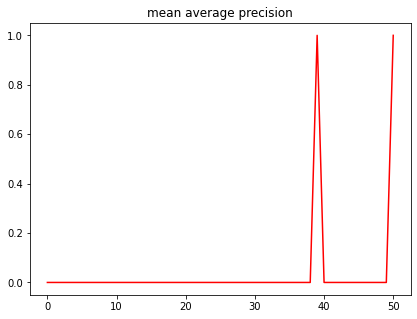

In [77]:
plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
plt.plot(np.arange(0, r_epochs), record_df['mAP'], 'r')
plt.title('mean average precision')

# plt.savefig("mean_overlapping_bboxes_and_class_acc.png")
plt.show()

### Start TEST01


Original image: height=3264 width=2448
Resized image:  height=400 width=300 C.im_size=300
Feature map size: height=25 width=18 C.rpn_stride=16
(1, 400, 300, 3)
2 includes 'y_rpn_cls' and 'y_rpn_regr'
Shape of y_rpn_cls (1, 25, 18, 18)
Shape of y_rpn_regr (1, 25, 18, 72)
{'filepath': './keras-frcnn/csv/035_S_R_19.JPG', 'width': 2448, 'height': 3264, 'bboxes': [{'class': 'PALM_PRINT', 'x1': 934, 'x2': 3969, 'y1': 301, 'y2': 2677}, {'class': '35', 'x1': 934, 'x2': 3969, 'y1': 301, 'y2': 2677}]}
Number of positive anchors for this image: 1
(array([ 5, 11, 11]), array([ 6, 12, 12]), array([ 5,  7, 16]))
(array([11, 11, 11, 11]), array([12, 12, 12, 12]), array([28, 29, 30, 31]))
y_rpn_cls for possible pos anchor: [0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
y_rpn_regr for positive anchor: [ 0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.


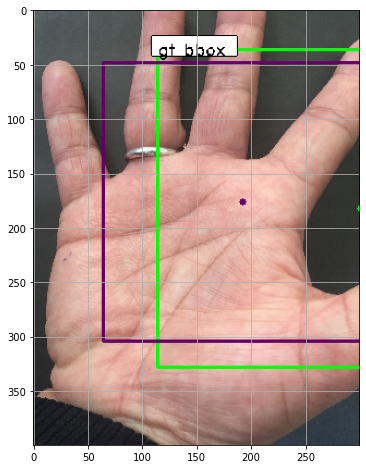

In [78]:
X, Y, image_data, debug_img, debug_num_pos = next(data_gen_test)
print('Original image: height=%d width=%d'%(image_data['height'], image_data['width']))
print('Resized image:  height=%d width=%d C.im_size=%d'%(X.shape[1], X.shape[2], C.im_size))
print('Feature map size: height=%d width=%d C.rpn_stride=%d'%(Y[0].shape[1], Y[0].shape[2], C.rpn_stride))
print(X.shape)
print(str(len(Y))+" includes 'y_rpn_cls' and 'y_rpn_regr'")
print('Shape of y_rpn_cls {}'.format(Y[0].shape))
print('Shape of y_rpn_regr {}'.format(Y[1].shape))
print(image_data)

print('Number of positive anchors for this image: %d' % (debug_num_pos))
if debug_num_pos==0:
    gt_x1, gt_x2 = image_data['bboxes'][0]['x1']*(X.shape[2]/image_data['height']), image_data['bboxes'][0]['x2']*(X.shape[2]/image_data['height'])
    gt_y1, gt_y2 = image_data['bboxes'][0]['y1']*(X.shape[1]/image_data['width']), image_data['bboxes'][0]['y2']*(X.shape[1]/image_data['width'])
    gt_x1, gt_y1, gt_x2, gt_y2 = int(gt_x1), int(gt_y1), int(gt_x2), int(gt_y2)

    img = debug_img.copy()
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    color = (0, 255, 0)
    cv2.putText(img, 'gt bbox', (gt_x1, gt_y1-5), cv2.FONT_HERSHEY_DUPLEX, 0.7, color, 1)
    cv2.rectangle(img, (gt_x1, gt_y1), (gt_x2, gt_y2), color, 2)
    cv2.circle(img, (int((gt_x1+gt_x2)/2), int((gt_y1+gt_y2)/2)), 3, color, -1)

    plt.grid()
    plt.imshow(img)
    plt.show()
else:
    cls = Y[0][0]
    pos_cls = np.where(cls==1)
    print(pos_cls)
    regr = Y[1][0]
    pos_regr = np.where(regr==1)
    print(pos_regr)
    print('y_rpn_cls for possible pos anchor: {}'.format(cls[pos_cls[0][0],pos_cls[1][0],:]))
    print('y_rpn_regr for positive anchor: {}'.format(regr[pos_regr[0][0],pos_regr[1][0],:]))

    gt_x1, gt_x2 = image_data['bboxes'][0]['x1']*(X.shape[2]/image_data['width']), image_data['bboxes'][0]['x2']*(X.shape[2]/image_data['width'])
    gt_y1, gt_y2 = image_data['bboxes'][0]['y1']*(X.shape[1]/image_data['height']), image_data['bboxes'][0]['y2']*(X.shape[1]/image_data['height'])
    gt_x1, gt_y1, gt_x2, gt_y2 = int(gt_x1), int(gt_y1), int(gt_x2), int(gt_y2)

    img = debug_img.copy()
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    color = (0, 255, 0)
    #cv2.putText(img, 'gt bbox', (gt_x1, gt_y1-5), cv2.FONT_HERSHEY_DUPLEX, 0.7, color, 1)
    cv2.rectangle(img, (gt_x1, gt_y1), (gt_x2, gt_y2), color, 2)
    cv2.circle(img, (int((gt_x1+gt_x2)/2), int((gt_y1+gt_y2)/2)), 3, color, -1)

    # Add text
    textLabel = 'gt bbox'
    (retval,baseLine) = cv2.getTextSize(textLabel,cv2.FONT_HERSHEY_COMPLEX,0.5,1)
    textOrg = (gt_x1, gt_y1+5)
    cv2.rectangle(img, (textOrg[0] - 5, textOrg[1]+baseLine - 5), (textOrg[0]+retval[0] + 5, textOrg[1]-retval[1] - 5), (0, 0, 0), 2)
    cv2.rectangle(img, (textOrg[0] - 5,textOrg[1]+baseLine - 5), (textOrg[0]+retval[0] + 5, textOrg[1]-retval[1] - 5), (255, 255, 255), -1)
    cv2.putText(img, textLabel, textOrg, cv2.FONT_HERSHEY_DUPLEX, 0.5, (0, 0, 0), 1)

    # Draw positive anchors according to the y_rpn_regr
    for i in range(debug_num_pos):

        color = (100+i*(155/4), 0, 100+i*(155/4))

        idx = pos_regr[2][i*4]/4
        anchor_size = C.anchor_box_scales[int(idx/3)]
        anchor_ratio = C.anchor_box_ratios[2-int((idx+1)%3)]

        center = (pos_regr[1][i*4]*C.rpn_stride, pos_regr[0][i*4]*C.rpn_stride)
        print('Center position of positive anchor: ', center)
        cv2.circle(img, center, 3, color, -1)
        anc_w, anc_h = anchor_size*anchor_ratio[0], anchor_size*anchor_ratio[1]
        cv2.rectangle(img, (center[0]-int(anc_w/2), center[1]-int(anc_h/2)), (center[0]+int(anc_w/2), center[1]+int(anc_h/2)), color, 2)
#         cv2.putText(img, 'pos anchor bbox '+str(i+1), (center[0]-int(anc_w/2), center[1]-int(anc_h/2)-5), cv2.FONT_HERSHEY_DUPLEX, 0.5, color, 1)

print('Green bboxes is ground-truth bbox. Others are positive anchors')
plt.figure(figsize=(8,8))
plt.grid()
plt.imshow(img)
plt.show()

In [79]:
T = {}
P = {}
mAPs = []
for idx, img_data in enumerate(test01_imgs):
    print('{}/{}'.format(idx,len(test01_imgs)))
    st = time.time()
    filepath = img_data['filepath']

    img = cv2.imread(filepath)

    X, fx, fy = format_img_map(img, C)

    # Change X (img) shape from (1, channel, height, width) to (1, height, width, channel)
    X = np.transpose(X, (0, 2, 3, 1))

    # get the feature maps and output from the RPN
    [Y1, Y2, F] = model_rpn.predict(X)


    R = rpn_to_roi(Y1, Y2, C,  K.image_data_format(), overlap_thresh=0.7)

    # convert from (x1,y1,x2,y2) to (x,y,w,h)
    R[:, 2] -= R[:, 0]
    R[:, 3] -= R[:, 1]

    # apply the spatial pyramid pooling to the proposed regions
    bboxes = {}
    probs = {}

    for jk in range(R.shape[0] // C.num_rois + 1):
        ROIs = np.expand_dims(R[C.num_rois * jk:C.num_rois * (jk + 1), :], axis=0)
        if ROIs.shape[1] == 0:
            break

        if jk == R.shape[0] // C.num_rois:
            # pad R
            curr_shape = ROIs.shape
            target_shape = (curr_shape[0], C.num_rois, curr_shape[2])
            ROIs_padded = np.zeros(target_shape).astype(ROIs.dtype)
            ROIs_padded[:, :curr_shape[1], :] = ROIs
            ROIs_padded[0, curr_shape[1]:, :] = ROIs[0, 0, :]
            ROIs = ROIs_padded

        [P_cls, P_regr] = model_classifier_only.predict([F, ROIs])

        # Calculate all classes' bboxes coordinates on resized image (300, 400)
        # Drop 'bg' classes bboxes
        for ii in range(P_cls.shape[1]):

            # If class name is 'bg', continue
            if np.argmax(P_cls[0, ii, :]) == (P_cls.shape[2] - 1):
                continue

            # Get class name
            cls_name = class_mapping[np.argmax(P_cls[0, ii, :])]

            if cls_name not in bboxes:
                bboxes[cls_name] = []
                probs[cls_name] = []

            (x, y, w, h) = ROIs[0, ii, :]

            cls_num = np.argmax(P_cls[0, ii, :])
            try:
                (tx, ty, tw, th) = P_regr[0, ii, 4 * cls_num:4 * (cls_num + 1)]
                tx /= C.classifier_regr_std[0]
                ty /= C.classifier_regr_std[1]
                tw /= C.classifier_regr_std[2]
                th /= C.classifier_regr_std[3]
                x, y, w, h = roi_helpers.apply_regr(x, y, w, h, tx, ty, tw, th)
            except:
                pass
            bboxes[cls_name].append([16 * x, 16 * y, 16 * (x + w), 16 * (y + h)])
            probs[cls_name].append(np.max(P_cls[0, ii, :]))

    all_dets = []

    for key in bboxes:
        bbox = np.array(bboxes[key])

        # Apply non-max-suppression on final bboxes to get the output bounding boxe
        new_boxes, new_probs = non_max_suppression_fast(bbox, np.array(probs[key]), overlap_thresh=0.5)
        for jk in range(new_boxes.shape[0]):
            (x1, y1, x2, y2) = new_boxes[jk, :]
            det = {'x1': x1, 'x2': x2, 'y1': y1, 'y2': y2, 'class': key, 'prob': new_probs[jk]}
            all_dets.append(det)


    print('Elapsed time = {}'.format(time.time() - st))
    t, p = get_map(all_dets, img_data['bboxes'], (fx, fy))
    for key in t.keys():
        if key not in T:
            T[key] = []
            P[key] = []
        T[key].extend(t[key])
        P[key].extend(p[key])
    all_aps = []
    for key in T.keys():
        ap = average_precision_score(T[key], P[key])
        print('{} AP: {}'.format(key, ap))
        all_aps.append(ap)
    print('mAP = {}'.format(np.mean(np.array(all_aps))))
    mAPs.append(np.mean(np.array(all_aps)))
#     print(T)
#     print(P)
    
print()
print('mean average precision:', np.mean(np.array(mAPs)))

0/336
Elapsed time = 3.7689473628997803
PALM_PRINT AP: 1.0
35 AP: 1.0
mAP = 1.0
1/336
Elapsed time = 3.7780842781066895
PALM_PRINT AP: 1.0
35 AP: 1.0
9 AP: 1.0
mAP = 1.0
2/336
Elapsed time = 3.726057529449463
PALM_PRINT AP: 1.0
35 AP: 1.0
9 AP: 1.0
mAP = 1.0
3/336
Elapsed time = 4.016728162765503
PALM_PRINT AP: 1.0
35 AP: 1.0
9 AP: 1.0
5 AP: 1.0
mAP = 1.0
4/336
Elapsed time = 3.8036763668060303
PALM_PRINT AP: 1.0
35 AP: 1.0
9 AP: 1.0
5 AP: 1.0
12 AP: 1.0
mAP = 1.0
5/336
Elapsed time = 3.5982964038848877
PALM_PRINT AP: 1.0
35 AP: 1.0
9 AP: 1.0
5 AP: 1.0
12 AP: 1.0
25 AP: 1.0
mAP = 1.0
6/336
Elapsed time = 3.8978965282440186
PALM_PRINT AP: 1.0
35 AP: 1.0
9 AP: 1.0
5 AP: 1.0
12 AP: 1.0
25 AP: 1.0
mAP = 1.0
7/336
Elapsed time = 3.7816708087921143
PALM_PRINT AP: 1.0
35 AP: 1.0
9 AP: 1.0
5 AP: 1.0
12 AP: 1.0
25 AP: 1.0
3 AP: 1.0
mAP = 1.0
8/336
Elapsed time = 3.6897029876708984
PALM_PRINT AP: 1.0
35 AP: 1.0
9 AP: 1.0
5 AP: 1.0
12 AP: 1.0
25 AP: 1.0
3 AP: 1.0
36 AP: 1.0
mAP = 1.0
9/336
Elapse

In [80]:
mAP = [mAP for mAP in mAPs if str(mAP)!='nan']
mean_average_prec = round(np.mean(np.array(mAP)), 3)
print('After training %dk batches, the mean average precision is %0.3f'%(len(record_df), mean_average_prec))

record_df.loc[len(record_df)-1, 'mAP'] = mean_average_prec
record_df.to_csv(C.record_path, index=0)
print('Save mAP to {}'.format(C.record_path))

After training 51k batches, the mean average precision is 1.000
Save mAP to ./model/record1025_1_AN_M.csv


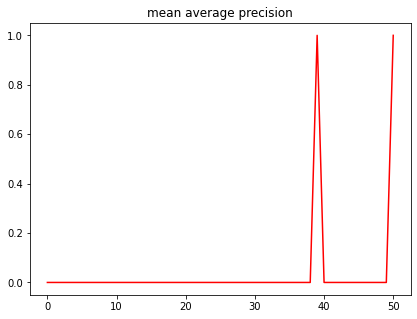

In [81]:
plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
plt.plot(np.arange(0, r_epochs), record_df['mAP'], 'r')
plt.title('mean average precision')

# plt.savefig("mean_overlapping_bboxes_and_class_acc.png")
plt.show()

In [82]:
base_path = './'

test_path = "annotate1025.txt" # Test data (annotation file)

test_base_path = 'Mydata' # Directory to save the test images

config_output_filename = os.path.join(base_path, 'model_vgg_config.pickle')

In [83]:
with open(config_output_filename, 'rb') as f_in:
	C = pickle.load(f_in)

# turn off any data augmentation at test time
C.use_horizontal_flips = False
C.use_vertical_flips = False
C.rot_90 = False

Original image: height=2448 width=3264
Resized image:  height=300 width=400 C.im_size=300
Feature map size: height=18 width=25 C.rpn_stride=16
(1, 300, 400, 3)
2 includes 'y_rpn_cls' and 'y_rpn_regr'
Shape of y_rpn_cls (1, 18, 25, 18)
Shape of y_rpn_regr (1, 18, 25, 72)
{'filepath': './keras-frcnn/csv/009_F_L_34.JPG', 'width': 3264, 'height': 2448, 'bboxes': [{'class': 'PALM_PRINT', 'x1': 106, 'x2': 3018, 'y1': 0, 'y2': 2352, 'bbox_matched': False}, {'class': '9', 'x1': 106, 'x2': 3018, 'y1': 0, 'y2': 2352, 'bbox_matched': False}]}
Number of positive anchors for this image: 1
(array([ 8,  8, 16]), array([9, 9, 5]), array([ 6, 15,  2]))
(array([8, 8, 8, 8]), array([9, 9, 9, 9]), array([24, 25, 26, 27]))
y_rpn_cls for possible pos anchor: [0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
y_rpn_regr for positive anchor: [0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

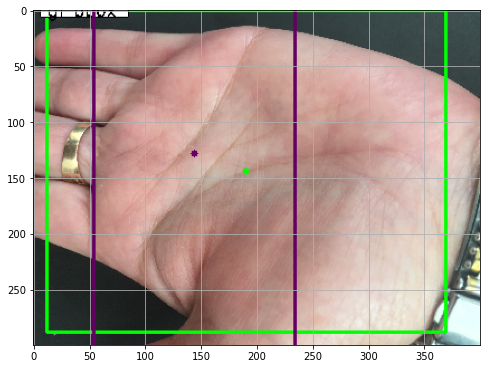

In [84]:
X, Y, image_data, debug_img, debug_num_pos = next(data_gen_test)
print('Original image: height=%d width=%d'%(image_data['height'], image_data['width']))
print('Resized image:  height=%d width=%d C.im_size=%d'%(X.shape[1], X.shape[2], C.im_size))
print('Feature map size: height=%d width=%d C.rpn_stride=%d'%(Y[0].shape[1], Y[0].shape[2], C.rpn_stride))
print(X.shape)
print(str(len(Y))+" includes 'y_rpn_cls' and 'y_rpn_regr'")
print('Shape of y_rpn_cls {}'.format(Y[0].shape))
print('Shape of y_rpn_regr {}'.format(Y[1].shape))
print(image_data)

print('Number of positive anchors for this image: %d' % (debug_num_pos))
if debug_num_pos==0:
    gt_x1, gt_x2 = image_data['bboxes'][0]['x1']*(X.shape[2]/image_data['height']), image_data['bboxes'][0]['x2']*(X.shape[2]/image_data['height'])
    gt_y1, gt_y2 = image_data['bboxes'][0]['y1']*(X.shape[1]/image_data['width']), image_data['bboxes'][0]['y2']*(X.shape[1]/image_data['width'])
    gt_x1, gt_y1, gt_x2, gt_y2 = int(gt_x1), int(gt_y1), int(gt_x2), int(gt_y2)

    img = debug_img.copy()
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    color = (0, 255, 0)
    cv2.putText(img, 'gt bbox', (gt_x1, gt_y1-5), cv2.FONT_HERSHEY_DUPLEX, 0.7, color, 1)
    cv2.rectangle(img, (gt_x1, gt_y1), (gt_x2, gt_y2), color, 2)
    cv2.circle(img, (int((gt_x1+gt_x2)/2), int((gt_y1+gt_y2)/2)), 3, color, -1)

    plt.grid()
    plt.imshow(img)
    plt.show()
else:
    cls = Y[0][0]
    pos_cls = np.where(cls==1)
    print(pos_cls)
    regr = Y[1][0]
    pos_regr = np.where(regr==1)
    print(pos_regr)
    print('y_rpn_cls for possible pos anchor: {}'.format(cls[pos_cls[0][0],pos_cls[1][0],:]))
    print('y_rpn_regr for positive anchor: {}'.format(regr[pos_regr[0][0],pos_regr[1][0],:]))

    gt_x1, gt_x2 = image_data['bboxes'][0]['x1']*(X.shape[2]/image_data['width']), image_data['bboxes'][0]['x2']*(X.shape[2]/image_data['width'])
    gt_y1, gt_y2 = image_data['bboxes'][0]['y1']*(X.shape[1]/image_data['height']), image_data['bboxes'][0]['y2']*(X.shape[1]/image_data['height'])
    gt_x1, gt_y1, gt_x2, gt_y2 = int(gt_x1), int(gt_y1), int(gt_x2), int(gt_y2)

    img = debug_img.copy()
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    color = (0, 255, 0)
    #cv2.putText(img, 'gt bbox', (gt_x1, gt_y1-5), cv2.FONT_HERSHEY_DUPLEX, 0.7, color, 1)
    cv2.rectangle(img, (gt_x1, gt_y1), (gt_x2, gt_y2), color, 2)
    cv2.circle(img, (int((gt_x1+gt_x2)/2), int((gt_y1+gt_y2)/2)), 3, color, -1)

    # Add text
    textLabel = 'gt bbox'
    (retval,baseLine) = cv2.getTextSize(textLabel,cv2.FONT_HERSHEY_COMPLEX,0.5,1)
    textOrg = (gt_x1, gt_y1+5)
    cv2.rectangle(img, (textOrg[0] - 5, textOrg[1]+baseLine - 5), (textOrg[0]+retval[0] + 5, textOrg[1]-retval[1] - 5), (0, 0, 0), 2)
    cv2.rectangle(img, (textOrg[0] - 5,textOrg[1]+baseLine - 5), (textOrg[0]+retval[0] + 5, textOrg[1]-retval[1] - 5), (255, 255, 255), -1)
    cv2.putText(img, textLabel, textOrg, cv2.FONT_HERSHEY_DUPLEX, 0.5, (0, 0, 0), 1)

    # Draw positive anchors according to the y_rpn_regr
    for i in range(debug_num_pos):

        color = (100+i*(155/4), 0, 100+i*(155/4))

        idx = pos_regr[2][i*4]/4
        anchor_size = C.anchor_box_scales[int(idx/3)]
        anchor_ratio = C.anchor_box_ratios[2-int((idx+1)%3)]

        center = (pos_regr[1][i*4]*C.rpn_stride, pos_regr[0][i*4]*C.rpn_stride)
        print('Center position of positive anchor: ', center)
        cv2.circle(img, center, 3, color, -1)
        anc_w, anc_h = anchor_size*anchor_ratio[0], anchor_size*anchor_ratio[1]
        cv2.rectangle(img, (center[0]-int(anc_w/2), center[1]-int(anc_h/2)), (center[0]+int(anc_w/2), center[1]+int(anc_h/2)), color, 2)
#         cv2.putText(img, 'pos anchor bbox '+str(i+1), (center[0]-int(anc_w/2), center[1]-int(anc_h/2)-5), cv2.FONT_HERSHEY_DUPLEX, 0.5, color, 1)

print('Green bboxes is ground-truth bbox. Others are positive anchors')
plt.figure(figsize=(8,8))
plt.grid()
plt.imshow(img)
plt.show()

In [85]:
T = {}
P = {}
mAPs = []
for idx, img_data in enumerate(test_imgs):
    print('{}/{}'.format(idx,len(test_imgs)))
    st = time.time()
    filepath = img_data['filepath']

    img = cv2.imread(filepath)

    X, fx, fy = format_img_map(img, C)

    # Change X (img) shape from (1, channel, height, width) to (1, height, width, channel)
    X = np.transpose(X, (0, 2, 3, 1))

    # get the feature maps and output from the RPN
    [Y1, Y2, F] = model_rpn.predict(X)


    R = rpn_to_roi(Y1, Y2, C,  K.image_data_format(), overlap_thresh=0.7)

    # convert from (x1,y1,x2,y2) to (x,y,w,h)
    R[:, 2] -= R[:, 0]
    R[:, 3] -= R[:, 1]

    # apply the spatial pyramid pooling to the proposed regions
    bboxes = {}
    probs = {}

    for jk in range(R.shape[0] // C.num_rois + 1):
        ROIs = np.expand_dims(R[C.num_rois * jk:C.num_rois * (jk + 1), :], axis=0)
        if ROIs.shape[1] == 0:
            break

        if jk == R.shape[0] // C.num_rois:
            # pad R
            curr_shape = ROIs.shape
            target_shape = (curr_shape[0], C.num_rois, curr_shape[2])
            ROIs_padded = np.zeros(target_shape).astype(ROIs.dtype)
            ROIs_padded[:, :curr_shape[1], :] = ROIs
            ROIs_padded[0, curr_shape[1]:, :] = ROIs[0, 0, :]
            ROIs = ROIs_padded

        [P_cls, P_regr] = model_classifier_only.predict([F, ROIs])

        # Calculate all classes' bboxes coordinates on resized image (300, 400)
        # Drop 'bg' classes bboxes
        for ii in range(P_cls.shape[1]):

            # If class name is 'bg', continue
            if np.argmax(P_cls[0, ii, :]) == (P_cls.shape[2] - 1):
                continue

            # Get class name
            cls_name = class_mapping[np.argmax(P_cls[0, ii, :])]

            if cls_name not in bboxes:
                bboxes[cls_name] = []
                probs[cls_name] = []

            (x, y, w, h) = ROIs[0, ii, :]

            cls_num = np.argmax(P_cls[0, ii, :])
            try:
                (tx, ty, tw, th) = P_regr[0, ii, 4 * cls_num:4 * (cls_num + 1)]
                tx /= C.classifier_regr_std[0]
                ty /= C.classifier_regr_std[1]
                tw /= C.classifier_regr_std[2]
                th /= C.classifier_regr_std[3]
                x, y, w, h = roi_helpers.apply_regr(x, y, w, h, tx, ty, tw, th)
            except:
                pass
            bboxes[cls_name].append([16 * x, 16 * y, 16 * (x + w), 16 * (y + h)])
            probs[cls_name].append(np.max(P_cls[0, ii, :]))

    all_dets = []

    for key in bboxes:
        bbox = np.array(bboxes[key])

        # Apply non-max-suppression on final bboxes to get the output bounding boxe
        new_boxes, new_probs = non_max_suppression_fast(bbox, np.array(probs[key]), overlap_thresh=0.5)
        for jk in range(new_boxes.shape[0]):
            (x1, y1, x2, y2) = new_boxes[jk, :]
            det = {'x1': x1, 'x2': x2, 'y1': y1, 'y2': y2, 'class': key, 'prob': new_probs[jk]}
            all_dets.append(det)


    print('Elapsed time = {}'.format(time.time() - st))
    t, p = get_map(all_dets, img_data['bboxes'], (fx, fy))
    for key in t.keys():
        if key not in T:
            T[key] = []
            P[key] = []
        T[key].extend(t[key])
        P[key].extend(p[key])
    all_aps = []
    for key in T.keys():
        ap = average_precision_score(T[key], P[key])
        print('{} AP: {}'.format(key, ap))
        all_aps.append(ap)
    print('mAP = {}'.format(np.mean(np.array(all_aps))))
    mAPs.append(np.mean(np.array(all_aps)))
#     print(T)
#     print(P)
    
print()
print('mean average precision:', np.mean(np.array(mAPs)))

0/421
Elapsed time = 3.818652391433716
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
1/421
Elapsed time = 3.7162609100341797
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
2/421
Elapsed time = 4.252804517745972
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
3/421
Elapsed time = 3.9191126823425293
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
4/421
Elapsed time = 3.757730007171631
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
5/421
Elapsed time = 3.8868377208709717
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
6/421
Elapsed time = 3.877854347229004
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
7/421
Elapsed time = 3.7139546871185303
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
8/421
Elapsed time = 3.7103395462036133
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
9/421
Elapsed time = 4.153947591781616
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
10/421
Elapsed time = 3.8938093185424805
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
11/421
Elapsed time = 3.675734043121338
PALM_PRINT AP: 1.0
003 AP: 1.0
mAP = 1.0
12/421
Elapsed time = 3.71508741